# Comparison Optical and DEM



This code was written with the help of ChatGPT.


In [1]:
# imports
import pandas as pd 
import geopandas as gpd
from shapely.geometry import Point
from shapely.geometry import Polygon, mapping
from shapely.geometry import shape, MultiPolygon
from shapely import box
from shapely.geometry import box
from shapely.ops import unary_union
from osgeo import gdal
from osgeo import ogr
import rasterio as rio
from rasterio.features import shapes
from rasterio.mask import mask
from rasterio.merge import merge
import matplotlib.pyplot as plt

import math
import os
import numpy as np
import datetime as dt
import json
from scipy.stats import linregress
from sklearn.linear_model import LinearRegression
import copy

import glob
import subprocess
from scipy.stats import linregress



## Read Files

In [2]:
# import of optical data
train_opt_labels = gpd.read_file('Kim\\Daten\\Optische Labels\\optical_training_labels.geojson', crs="EPSG:3413")  # imports training labels
pred_opt_labels = gpd.read_file('Kim\\Daten\\Optische Labels\\optical_predictions.gpkg', crs="EPSG:3413") # imports the predicted labels 

# import of DEM data
peel2_dem_labels_all = gpd.read_file('Kim\\QGIS\\Peel2_Kim.geojson', crs="EPSG:3413") # imports the selfdrawn labels from the area Peel 2 
tuktoyaktuk_dem_labels_all = gpd.read_file('Kim\\QGIS\\Tuktoyaktuk_KimBuehler.geojson', crs="EPSG:3413") # imports the selfdrawn labels from the area Toktoyaktuk
yamal_dem_labels_all = gpd.read_file('Kim\\QGIS\\Yamal_KimBuehler.geojson', crs="EPSG:3413") # imports the selfdrawn labels from the area yamal 

peel_dem_others = gpd.read_file('Kim\\Daten\\Dem Labels\\peel_DEM_labels.geojson', crs="EPSG:3413") # imports the dem labels from the area Peel, drawn by someone else
tuktoyaktuk_dem_others = gpd.read_file('Kim\\Daten\\Dem Labels\\tuktoyaktuk_DEM_labels.geojson', crs="EPSG:3413") # imports the dem labels from the area Tuktoyaktuk, drawn by Kathrin
yamal_dem_others = gpd.read_file('Kim\\Daten\\Dem Labels\\yamal_DEM_labels.geojson', crs="EPSG:3413") # imports the dem labels from the area Yamal, drawn by Kathrin

# import sentinal data
peel_sentinel_2022 = gpd.read_file('Kim\\QGIS\\Peel2_sentinel.geojson', crs="EPSG:3413")

# change column names end_date and start_date to year_end and year_start
tuktoyaktuk_dem_labels_all["year_start"] = tuktoyaktuk_dem_labels_all["start_date"]
tuktoyaktuk_dem_labels_all["year_end"] = tuktoyaktuk_dem_labels_all["end_date"]
tuktoyaktuk_dem_labels_all = tuktoyaktuk_dem_labels_all.drop(columns=["start_date", "end_date"])

# tiles
peel2_tiles = gpd.read_file('Kim\\Daten\\Tiles\\tiles_peel2.geojson', crs="EPSG:3413")
tuktoyaktuk_tiles = gpd.read_file('Kim\\Daten\\Tiles\\tiles_tuktoyaktuk.geojson', crs="EPSG:3413")
yamal_tiles = gpd.read_file('Kim\\Daten\\Tiles\\tiles_yamal.geojson', crs="EPSG:3413")

all_tiles = [peel2_tiles, tuktoyaktuk_tiles, yamal_tiles]

# Footprints
# Footprints have to be changed into EPSG:3413 and multiple overlaying features need to be dissolved into 1
footprint_iter005 = gpd.read_file('Kim\\Daten\\Optische Labels\\Footprints\\Training\\ImageFootprints_RTS_PlanetScope_Nitze_iteration005_EPSG3413.geojson', crs="EPSG:3413") # Footprint which overlapps with peel2
footprint_iter001 = gpd.read_file('Kim\\Daten\\Optische Labels\\Footprints\\Training\\ImageFootprints_RTS_PlanetScope_Nitze_iteration001_EPSG3413.geojson', crs="EPSG:3413") # Footprint which overlapps with tuktoyaktuk, has multiple layers over each other
footprint_iter006 = gpd.read_file('Kim\\Daten\\Optische Labels\\Footprints\\Training\\ImageFootprints_RTS_PlanetScope_Nitze_iteration006_EPSG3413.geojson', crs="EPSG:4326") # Footprint which overlapps with yamal




## General Settings

In [3]:
# Set pandas display options to show all rows and columns
pd.set_option('display.max_rows', None)  # Show all rows
pd.set_option('display.max_columns', None)  # Show all columns

## Definitions

In [4]:
# returns a new file with all the labels which are within a tile
def label_in_tile(labels:gpd.GeoDataFrame, tile:gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    df = gpd.sjoin(labels, tile, predicate='covered_by',how='inner', lsuffix= "label", rsuffix="tile")
    df = df.drop(columns=["index_tile"])
    if "year_start_tile" in df:
        df = df.drop(columns=["year_start_tile"])
    if "year_end_tile" in df:
        df = df.drop(columns=["year_end_tile"])
    if "optical_train" in df:
        df = df.drop(columns=["optical_train"])
    if "optical_predict" in df:
        df = df.drop(columns=["optical_predict"])
    return df

In [5]:
# returns a new file with all the labels which are within a footprint
def label_in_fp(labels:gpd.GeoDataFrame, footprint:gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    df = gpd.sjoin(labels, footprint, predicate='covered_by',how='inner', lsuffix= "label", rsuffix="fp")
    df = df.drop(columns=["index_fp"])
    
    return df

In [6]:
# returns a new file with all the labels which are within a diff dem
def label_in_diff_poly(labels:gpd.GeoDataFrame, diff_poly:gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    #print(labels.crs)
    df = gpd.sjoin(labels, diff_poly, predicate='covered_by',how='inner', lsuffix= "label", rsuffix="diff")
    df = df.drop(columns=["index_diff"])
    
    return df
# save_gpd(label_in_diff_poly(labels_of_year_data["peel2"]["opt_pred_labels"]["unrasterised"]["2022"], merged_diff_polygons["peel2"]["2010_2021"]), "test_labels_in_diff" )

In [7]:
# returns a new file with all the footprintparts overlapping with a tile
def footprint_overlapping_tile(footprint:gpd.GeoDataFrame, tile:gpd.GeoDataFrame) -> gpd.GeoDataFrame: 
    df = gpd.overlay(footprint, tile, how="intersection")
    if "year_start" in df:
        df = df.drop(columns=["year_start"])
    if "year_end" in df:
        df = df.drop(columns=["year_end"])
    if "optical_train" in df:
        df = df.drop(columns=["optical_train"])
    if "optical_predict" in df:
        df = df.drop(columns=["optical_predict"])
    return df

In [8]:
# calculates how round a label is. 1 = circle, 0 = not round at all
def calculate_circularity(geometry: Polygon):
    perimeter = geometry.length
    area = geometry.area
    circularity = (4 * math.pi * area) / (perimeter ** 2)
    return circularity

In [9]:
# Calculates how solid a polygon is. If you put a convex hull around the polygon, how much surface of the convex hull is covered by the polygon
def calculate_solidity(geometry):
    convexhull = geometry.convex_hull
    convexhull = convexhull.area
    area = geometry.area
    solidity = area / convexhull
    return solidity

In [10]:
# Takes a GeoDataFrame with polygons and return a new GeoDataFrame with one polygon representing the union of the input polygons

def union_polygon(gdf):

    # Check if the GeoDataFrame is empty
    if len(gdf) == 0:
        return gpd.GeoDataFrame()  # Return an empty GeoDataFrame

    # Calculate the union of all polygons
    union_polygon = gdf.unary_union

    # Create a new GeoDataFrame with the union polygon
    union_gdf = gpd.GeoDataFrame(geometry=[union_polygon])

    return union_gdf

#unionized_polygon = union_polygon(labels_of_year_data["peel2"]["opt_pred_labels"]["unrasterised"]["2021"])

In [11]:
# calculates volume once with suming up the hight changes of every pixel and multiplying with the surface of one pixel and once by taking the mean of the hight changes and multiplying with the whole surface

def volume_change_per_polygon(row, dem_path: str, opt=False):
    with rio.open(dem_path) as src:
        # Create a mask of the DEM using the polygon
        try:
            out_image, out_transform = mask(src, [row.geometry], crop=True)
        except: 
            print("Error in volume change calculation")
            avg_volume_change = np.nan
            total_volume_change = np.nan
            return avg_volume_change, total_volume_change
        if opt == False:
            polygon_diff_dem = np.where((out_image > 8000) | (out_image < -500), np.nan, out_image)
        else:
            polygon_diff_dem = np.where((out_image > 0) | (out_image < -500), np.nan, out_image)
        # Remove nodata values
        dem_data = out_image[out_image != src.nodata]
        # Calculate the total elevation change
        total_volume_change = np.nansum(polygon_diff_dem)*100 # res_x (10 m) * res_y (10 m) * 1 m height change = 100 m^3
        avg_height_change = np.nanmean(polygon_diff_dem)
        avg_volume_change = avg_height_change * float(row.area)
        if avg_volume_change == 0:
            avg_volume_change = np.nan
        if total_volume_change == 0:
            total_volume_change = np.nan

    return avg_volume_change, total_volume_change

#label_df = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2013_2021"]
#dem_file = merged_diff_dems["peel2"]["2013_2021"]
#label_df["avg_volume_change"], label_df["sum_volume_change"] = zip(*label_df.apply(lambda row: volume_change_per_polygon(row, dem_file, opt = True), axis=1))
#display(label_df)

In [12]:
# calculates error by summing up the height errors according to the error propagation

def error_per_polygon(row, error_path: str):
    with rio.open(error_path) as src:
        # Create a mask of the DEM using the polygon
        out_image, out_transform = mask(src, [row.geometry], crop=True)
        polygon_diff_error = np.where((out_image > 8000) | (out_image < -500), np.nan, out_image)
        # Remove nodata values
        error_data = out_image[out_image != src.nodata]
        # Calculate the total elevation change
        total_error = np.sqrt(np.nansum(polygon_diff_error**2))*100 # res_x (10 m) * res_y (10 m) * 1 m error = 100 m^3
        if total_error == 0:
            total_error = np.nan

    return total_error

# label_df = buffered_erased["peel2"]["dem_labels"]["buffered"]["2010_2021"]
# error_file = merged_diff_errors["peel2"]["2010_2021"]
# label_df["sum_error"] = label_df.apply(lambda row: error_per_polygon(row, error_file), axis=1)


In [13]:
# build one tile for every region out of multiple tiles
def polygon_union(df: gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    new_polygon = unary_union(df["geometry"])
    new_polygon_gdf = gpd.GeoDataFrame(geometry=[new_polygon], crs=df.crs)
    return new_polygon_gdf

In [14]:
# stores GeoDataFrames into the folder Kim\Auswertungsdaten

def save_gpd(df:gpd.GeoDataFrame, name:str) -> None:
    df.to_file("Kim\\Auswertungsdaten\\"+name, crs=df.crs)
    return

In [15]:
# Takes a GeoDataFrame with labels and a GeoDataFrame with a footprint and creates a new GeoDataFrame with only the labels within the footprint which have the same year as the footprint
def opt_labels_in_fp_with_same_year(labels:gpd.GeoDataFrame, fp:gpd.GeoDataFrame):
    if len(fp) > 1:
        raise ValueError("The footprint DataFrame contains more than 1 entry.")
    else:
        labels_within_fp = label_in_fp(labels, fp)
        year = fp["year_fp"][0]
        condition = labels_within_fp["year"] == year
        labels_with_correct_year = labels_within_fp[condition]
        return labels_with_correct_year, year



In [16]:
# Takes a GeoDataFrame with labels and a GeoDataFrame with a footprint and creates a new GeoDataFrame with only the labels within the footprint which have the same year as the footprint
def dem_labels_in_fp_with_same_year(labels:gpd.GeoDataFrame, fp:gpd.GeoDataFrame):
    if len(fp) > 1:
        raise ValueError("The footprint DataFrame contains more than 1 entry.")
    else:
        labels_within_fp = label_in_fp(labels, fp)
        year_end = fp["year_fp"][0]
        condition = labels_within_fp["year_end"] == year_end
        labels_with_correct_year = labels_within_fp[condition]
        return labels_with_correct_year, year_end

In [17]:
# takes a Geodataframe and turnes the polygones into a raster
def rasterise_geojson(input_file: gpd.GeoDataFrame, output_file, raster_extent): # Add raster_extent
    gdal.Rasterize(output_file, input_file, burnValues=[1], outputBounds=raster_extent, # add outputBounds
                   outputType=gdal.GDT_Byte, creationOptions=["COMPRESS=DEFLATE"], noData=255, initValues=0, xRes=10, yRes=-10, allTouched=True)

# takes a raster file and turnes it into a polygon
def polygonize_raster(input_file, output_file):
    with rio.open(input_file) as src:
        image = src.read(1)
        transform = src.transform
        polygons = []
        for shape, value in shapes(image, transform=transform):
            if value == 1.0:
                polygons.append(Polygon(tuple(shape['coordinates'][0])))
        gdf = gpd.GeoDataFrame({'geometry': polygons}, crs="EPSG:3413")
        gdf.to_file(output_file, driver='GeoJSON', crs="EPSG:3413")
        src.close()

# rasterises labels and assigns the right attributes to the rasterised labels
def rasterise_labels(DEM_all : gpd.GeoDataFrame, region_name : str, raster_extent, kind_of_label: str, year: str, note = "original"): # add raster_extent
    polygon_counter = 0
    all_polygons = []
    for index, row in DEM_all.iterrows():
        attributes_of_label = {}
        for attribute in row.index:
            if attribute != "geometry":
                attributes_of_label[attribute] = row[attribute]
        single_polygon_df = gpd.GeoDataFrame([row], columns=row.index)
        filepath_labels = f"Kim\\Auswertungsdaten\\temp\\temp_polygon_label_file_{polygon_counter}.geojson"
        filepath_raster = f"Kim\\Auswertungsdaten\\temp\\temp_polygon_raster_file_{polygon_counter}.tif" 
        single_polygon_df.to_file(filepath_labels, driver='GeoJSON')

        rasterise_geojson(filepath_labels, filepath_raster, raster_extent) # add raster_extent

        polygonize_raster(filepath_raster, filepath_labels)

        rasterised_single_polygon_df = gpd.read_file(filepath_labels)
        # add attributes to new dataframe
        for attribute in attributes_of_label:
            rasterised_single_polygon_df[attribute] = attributes_of_label[attribute]
        all_polygons.append(rasterised_single_polygon_df)
        os.remove(filepath_raster)
        polygon_counter += 1
    

    # add multiple geojson files together
    #create empty geodataframe

    merged_gdf = gpd.GeoDataFrame(pd.concat(all_polygons, ignore_index=True), crs=DEM_all.crs)
    merged_gdf = merged_gdf.drop_duplicates(subset=['geometry'])
    merged_gdf.to_file(f'Kim\\Auswertungsdaten\\rasterised_labels\\{region_name}_{kind_of_label}_rasterised_{year}_{note}.geojson', driver='GeoJSON', crs="EPSG:3413")

    rasterised_labels = gpd.read_file(f'Kim\\Auswertungsdaten\\rasterised_labels\\{region_name}_{kind_of_label}_rasterised_{year}_{note}.geojson', crs="EPSG:3413")
    
    return rasterised_labels

# bounding_box = gpd.total_bounds returns a list? with the bounding box, corresponding to the maximal and minimal x and y coordinates. bounding_box[0] = min x-coordinates, bounding_box[1] = min y-coor, bounding_box[2] = max x-coor, bounding_box[3] = max y-coor

In [18]:
# build one diff dem file with multiple diff dem files from a specific region and year

def merge_dem_and_create_boundary(region, year_start, year_end):
    # Define paths
    dem_paths = f"Kim\\Daten\\DEM Daten\\Difference DEMs\\all\\{region}\\all"
    demList = glob.glob(f'{dem_paths}\\diff_dem_*_{year_start}_*_{year_end}_*.tif')
    # Merge all the DEMs
    src_files_to_mosaic = []
    for item in demList:
        src = rio.open(item)
        src_files_to_mosaic.append(src)

    # Set nodata value
    nodata_value = np.nan

    # Merge rasters using rasterio, ignoring nodata values
    mosaic, out_trans = merge(src_files_to_mosaic, nodata=nodata_value)

    # Define output file path
    output_path = f"Kim\\Auswertungsdaten\\merged_diff_dems\\diff_dem_merged_{region}_{year_start}_{year_end}.tif"

    # Update metadata
    out_meta = src.meta.copy()
    out_meta.update({"driver": "GTiff",
                     "height": mosaic.shape[1],
                     "width": mosaic.shape[2],
                     "transform": out_trans,
                     "nodata": nodata_value})  # Set nodata value in metadata

    # Write the mosaic to disk
    with rio.open(output_path, "w", **out_meta) as dest:
        dest.write(mosaic)

    # Get boundary of the merged DEM
    bounds = box(*rio.transform.array_bounds(out_meta['height'], out_meta['width'], out_meta['transform']))

    # Write boundary to GeoJSON
    output_boundary_path = f"Kim\\Auswertungsdaten\\DEM_boundries_shapes\\{region}\\DEM_shape_{region}_{year_start}_{year_end}.geojson"
    gdf = gpd.GeoDataFrame(geometry=[bounds], crs=src.crs)
    gdf.to_file(output_boundary_path, driver='GeoJSON')
    return output_path

#merge_dem_and_create_boundary("tuktoyaktuk", 2010, 2014)

In [19]:
# build one error file with multiple error files from a specific region and year
def merge_diff_error_and_create_boundary(region, year_start, year_end):
    # Define paths
    error_paths = f"Kim\\Daten\\DEM Daten\\Difference DEMs\\all\\{region}\\all"
    errorList = glob.glob(f'{error_paths}\\diff_error_*_{year_start}_*_{year_end}_*.tif')
    # Merge all the error files
    src_files_to_mosaic = []
    for item in errorList:
        src = rio.open(item)
        src_files_to_mosaic.append(src)

    # Set nodata value
    nodata_value = np.nan

    # Merge rasters using rasterio, ignoring nodata values
    mosaic, out_trans = merge(src_files_to_mosaic, nodata=nodata_value)

    # Define output file path
    output_path = f"Kim\\Auswertungsdaten\\merged_diff_error\\diff_error_merged_{region}_{year_start}_{year_end}.tif"

    # Update metadata
    out_meta = src.meta.copy()
    out_meta.update({"driver": "GTiff",
                     "height": mosaic.shape[1],
                     "width": mosaic.shape[2],
                     "transform": out_trans,
                     "nodata": nodata_value})  # Set nodata value in metadata

    # Write the mosaic to disk
    with rio.open(output_path, "w", **out_meta) as dest:
        dest.write(mosaic)

    # Get boundary of the merged DEM
    bounds = box(*rio.transform.array_bounds(out_meta['height'], out_meta['width'], out_meta['transform']))

    # Write boundary to GeoJSON
    output_boundary_path = f"Kim\\Auswertungsdaten\\diff_error_boundries_shapes\\{region}\\diff_error_shape_{region}_{year_start}_{year_end}.geojson"
    gdf = gpd.GeoDataFrame(geometry=[bounds], crs=src.crs)
    gdf.to_file(output_boundary_path, driver='GeoJSON')
    return output_path

#merge_diff_error_and_create_boundary("tuktoyaktuk", 2010, 2014)

In [20]:
# creates a polygon in the shape of the diff dem

def polygon_of_tiff(startyear, endyear, region):
    with rio.open(f"Kim\\Auswertungsdaten\\merged_diff_dems\\diff_dem_merged_{region}_{startyear}_{endyear}.tif") as src:
        image = src.read(1)
        transform = src.transform
        crs = src.crs

    image = np.nan_to_num(image, nan=9999)
    mask = image != 9999
    shapes_gen = shapes(image, mask=mask, transform=transform)
    geometries = [shape(geom) for geom, value in shapes_gen]
    merged_geom = unary_union(geometries)
    gdf = gpd.GeoDataFrame([{'geometry': merged_geom, 'id': 1}], crs=crs.to_string())
    gdf.to_file(f"Kim\\Auswertungsdaten\\merged_diff_dems\\polygons\\diff_dem_merged_{region}_{startyear}_{endyear}.geojson")

    return gdf

#polygon_of_tiff(2010, 2021, "peel2")

In [21]:
# Filters a dataframe, and returns a new dataframe with the polygons which are within the bounding box of the tif file
def labels_in_raster(labels, tif_file):
    with rio.open(tif_file) as src:
        raster_poly = box(*src.bounds)

        # Filter polygons that intersect with the raster polygon
        polygons_in_boundary = labels[labels.geometry.intersects(raster_poly)]

    return polygons_in_boundary

#save_gpd(labels_in_raster(labels_of_year_data["peel2"]["opt_train_labels"]["unrasterised"]["2022"],merged_diff_dems["peel2"]["2010_2021"]), "test_labels")
#labels_in_raster(labels_of_year_data["peel2"]["opt_train_labels"]["unrasterised"]["2022"],merged_diff_dems["peel2"]["2010_2021"])

In [22]:
# Calculates the IoU of labels which are in both dataframes at pixel level. It calculates how well two kinds of labels overlap. labels from both df which intersect are counted as the same slump here.

def confusion_matrix_pixel_same_labels(df1, df2):
    intersection = gpd.overlay(df1, df2, how='intersection', keep_geom_type=True)
    try:
        filtered_df1 = df1[df1.intersects(intersection.unary_union)]
        filtered_df2 = df2[df2.intersects(intersection.unary_union)]

        union_df1 = union_polygon(filtered_df1)
        union_df2 = union_polygon(filtered_df2)
        union_inters = union_polygon(intersection)
        union_df1["area"] = union_df1["geometry"].area
        union_df2["area"] = union_df2["geometry"].area
        union_inters["area"] = union_inters["geometry"].area

        tot_area_df1 = union_df1["area"].sum()
        tot_area_df2 = union_df2["area"].sum()
        tot_area_inters = union_inters["area"].sum()
        TP = tot_area_inters
        FN = tot_area_df2 - tot_area_inters
        FP = tot_area_df1 - tot_area_inters
        IoU = TP/(TP+FN+FP)
        return IoU
    except:
        if len(intersection) == 0:
            print("There are no intersection between the two DataFrames")
    

#df1 = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2011_2021"]
#df2 = labels_of_year_data["peel2"]["opt_train_labels"]["rasterised"]["2022"]
#confusion_matrix_pixel_same_labels(df1, df2)

In [23]:
# extracts individual polygons out of a multipolygon and creates a new dataframe with the polygons

def separate_multipolygon(multi_poly):
    # Check if the input is a GeoDataFrame
    if isinstance(multi_poly, gpd.GeoDataFrame):
        # Extract the first (and assumedly only) MultiPolygon geometry
        multi_poly = multi_poly.geometry.iloc[0]
    
    # Create a list to store individual polygons
    polygons_list = []
    
    # Iterate over each component (Polygon) in the MultiPolygon
    for idx, polygon in enumerate(multi_poly.geoms):
        # Create a dictionary for the individual polygon
        polygon_dict = {'geometry': polygon}
        polygons_list.append(polygon_dict)
    
    # Convert the list of dictionaries to a GeoDataFrame
    df_individual_polygons = gpd.GeoDataFrame(polygons_list, columns=['geometry'])
    
    return df_individual_polygons

# df = labels_of_year_data["tuktoyaktuk"]["opt_train_labels"]["rasterised"]["2019"]
# union = union_polygon(df)
# save_gpd(separate_multipolygon(union), "test_separated_union")

In [24]:
# Calculates the IoU of all the labels which are in either of the dataframes at pixel level. It calculates how well two kinds of labels overlap.

def confusion_matrix_pixel_all_labels_opt_train(dem_df, opt_train_df, fp, diff_poly):
    dem_in_fp = label_in_fp(dem_df, fp) # only takes dem labels which are in the footprint
    dem_in_fp = union_polygon(dem_in_fp)
    opt_train_in_diff = label_in_diff_poly(opt_train_df, diff_poly) # only takes opt labels which are in the diff polygon
    opt_train_in_diff = union_polygon(opt_train_in_diff)
    dem_in_fp["area"] = dem_in_fp["geometry"].area
    opt_train_in_diff["area"] = opt_train_in_diff["geometry"].area
    intersection = gpd.GeoDataFrame(geometry=dem_in_fp.intersection(opt_train_in_diff).buffer(0))
    # intersection compares all the entrys from the first with all the entrys from the second DataFrame. So intersection could countain duplicate intersections which need to be filtert out
    intersection = intersection.drop_duplicates(subset=["geometry"])
    intersection["area"] = intersection["geometry"].area

    tot_area_dem = dem_in_fp["area"].sum()
    tot_area_opt_train = opt_train_in_diff["area"].sum()
    tot_area_inters = intersection["area"].sum()

    TP = tot_area_inters # area in both
    FN = tot_area_opt_train - tot_area_inters # area only in optical training labels
    FP = tot_area_dem - tot_area_inters # area only in dem labels
    IoU = TP/(TP+FN+FP)
    len_dem = len(separate_multipolygon(dem_in_fp))
    len_opt = len(separate_multipolygon(opt_train_in_diff))
    len_intersect = len(separate_multipolygon(intersection))
    return IoU, int(len_dem), int(len_opt), int(len_intersect)

#confusion_matrix_pixel_all_labels_opt_train(labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2011_2021"], labels_of_year_data["peel2"]["opt_train_labels"]["rasterised"]["2022"], fp_of_year_data["peel2"][2022], merged_diff_polygons["peel2"]["2011_2021"])

In [25]:
# Calculates the IoU of all the labels which are in either of the dataframes at pixel level. It calculates how well two kinds of labels overlap.

def confusion_matrix_pixel_all_labels_opt_pred(dem_df, opt_pred_df, diff_poly):
    opt_pred_in_diff_poly = label_in_diff_poly(opt_pred_df, diff_poly) # only takes predicted labels which are within the diff dem
    dem_df = union_polygon(dem_df)
    opt_pred_in_diff_poly = union_polygon(opt_pred_in_diff_poly)
    dem_df["area"] = dem_df["geometry"].area
    opt_pred_in_diff_poly["area"] = opt_pred_in_diff_poly["geometry"].area
    intersection = gpd.GeoDataFrame(geometry=dem_df.intersection(opt_pred_in_diff_poly).buffer(0))
    # intersection compares all the entrys from the first with all the entrys from the second DataFrame. So intersection could countain duplicate intersections which need to be filtert out
    intersection = intersection.drop_duplicates(subset=["geometry"])
    intersection["area"] = intersection["geometry"].area

    tot_area_dem = dem_df["area"].sum()
    tot_area_opt_pred = opt_pred_in_diff_poly["area"].sum()
    tot_area_inters = intersection["area"].sum()

    TP = tot_area_inters # area in both
    FN = tot_area_opt_pred - tot_area_inters # area only in optical training labels
    FP = tot_area_dem - tot_area_inters # area only in dem labels
    IoU = TP/(TP+FN+FP)
    len_dem = len(separate_multipolygon(dem_df))
    len_opt = len(separate_multipolygon(opt_pred_in_diff_poly))
    len_intersect = len(separate_multipolygon(intersection))
    return IoU, len_dem, len_opt, len_intersect

# confusion_matrix_pixel_all_labels_opt_pred(labels_of_year_data["yamal"]["dem_labels"]["rasterised"]["2010_2021"], labels_of_year_data["yamal"]["opt_train_labels"]["rasterised"]["2022"], merged_diff_polygons["yamal"]["2010_2021"])

In [26]:
# searches for different RTSs in one DataFrame by checking for overlaps between the labels and returns a new DataFrame with the unique RTSs
def count_different_pairs(dataframe):
    df = dataframe.copy()
    # Iterate through each pair of polygons in the input layer
    for i, poly1 in df.iterrows():
        for j, poly2 in df.iterrows():
            if i < j:  # Skip same pairs
                intersection_area = poly1.geometry.intersection(poly2.geometry).area
                if intersection_area / poly1.geometry.area > 0.5 or intersection_area / poly2.geometry.area > 0.5:
                    df = df.drop(j)
    return df

#count_different_pairs(labels_of_year_data["tuktoyaktuk"]["opt_train_labels"]["unrasterised"]["2019"])

In [27]:
# Calculates the F1_score of dem labels and optical training labels at label level. Calculates how many slumpes were found in both dem and optical training data in comparison to the amount which was found only in one of them.

def F1_score_dem_opt_train(dem_df, opt_train_df, fp, diff_poly):
    dem_in_fp = label_in_fp(dem_df, fp) # only takes dem labels which are in the footprint
    dem = count_different_pairs(dem_in_fp)
    opt_train_in_diff_poly = label_in_diff_poly(opt_train_df, diff_poly)
    opt_train = count_different_pairs(opt_train_in_diff_poly)
    overlap_df = gpd.sjoin(dem_in_fp, opt_train_in_diff_poly, predicate='intersects',how='inner', lsuffix= "df", rsuffix="ref_df")
    overlap_df.reset_index(inplace=True)
    overlap_df = overlap_df.drop_duplicates()
    overlap = count_different_pairs(overlap_df)
    amount_overlap = len(overlap)
    amount_dem = len(dem)
    amount_opt_train = len(opt_train)
    TP = amount_overlap # labels in both dataframes
    FN = amount_opt_train - TP # labels only in optical training data
    FP = amount_dem - TP # labels only in dem
    precision = TP/(TP+FP) # defines the percentage of the found slumps which are actually slumps according to optical
    recall = TP/(TP+FN) # defines the percentage of the actual slumps according to optical which were found in dem
    F1_score = (2*precision*recall)/(precision+recall) # defines how balances the detection process is
    #print(F1_score)
    return F1_score, precision, recall

#F1_score_dem_opt_train(labels_of_year_data["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2021"], labels_of_year_data["tuktoyaktuk"]["opt_train_labels"]["unrasterised"]["2019"], fp_of_year_data["tuktoyaktuk"][2019], merged_diff_polygons["tuktoyaktuk"]["2010_2021"])
#F1_score_dem_opt_train(labels_of_year_data[region]["dem_labels"][kind][year],opt_train_labels, fp_of_year_data[region][int(opt_train_year)], merged_diff_polygons[region][year])

In [28]:
# Calculates the F1_score of dem labels and optical prediction labels at label level. Calculates how many slumpes were found in both dem and optical prediction data in comparison to the amount which was found only in one of them.

def F1_score_dem_opt_pred(dem_df, opt_pred_df, diff_poly):
    opt_pred_in_diff_poly = label_in_diff_poly(opt_pred_df, diff_poly) # only takes predicted labels which are within the tile
    dem = count_different_pairs(dem_df)
    opt_pred = count_different_pairs(opt_pred_in_diff_poly)
    overlap_df = gpd.sjoin(dem_df, opt_pred_df, predicate='intersects',how='inner', lsuffix= "df", rsuffix="ref_df")
    overlap_df.reset_index(inplace=True)
    overlap_df = overlap_df.drop_duplicates()
    overlap = count_different_pairs(overlap_df)
    amount_overlap = len(overlap)
    amount_dem = len(dem)
    amount_opt_pred = len(opt_pred)
    TP = amount_overlap # labels in both dataframes
    FN = amount_opt_pred - TP # labels only in optical training data
    FP = amount_dem - TP # labels only in dem
    precision = TP/(TP+FP) # defines the percentage of the found slumps which are actually slumps according to optical
    recall = TP/(TP+FN) # defines the percentage of the actual slumps according to optical which were found in dem
    F1_score = (2*precision*recall)/(precision+recall) # defines how balances the detection process is
    return F1_score, precision, recall

#F1_score_dem_opt_pred(labels_of_year_data["tuktoyaktuk"]["dem_labels"]["rasterised"]["2010_2021"], labels_of_year_data["tuktoyaktuk"]["opt_pred_labels"]["rasterised"]["2019"], data["tuktoyaktuk"]["tiles"])

In [29]:
# plot for comparison of standart metrics of two label kinds
def plot_dem_vs_opt_with_linregress(x_values, y_values, x_name: str, y_name: str, title: str):
    x_values = x_values.reshape(-1, 1)

    # calculates the values for the linear regression
    slope, intercept, r_value, p_value, std_err = linregress(x_values, y_values)
    x_regress = np.linspace(min(x_values), max(x_values), 100)
    y_regress = slope * x_regress + intercept

    # Calculate R-squared value
    r_squared = r_value**2

    # Calculate the y-values for the error bars
    y_pred = slope*x_values + intercept
    y_error = std_err * np.sqrt(1 + 1/len(x_values) + (x_values - np.mean(x_values))**2 / np.sum((x_values - np.mean(x_values))**2))


    plt.scatter(x_values, y_values, color='blue', label='Label Data')
    plt.plot(x_regress, y_regress, color='green', label='Linear Regression')
    # Plot error bars
    plt.errorbar(x_values, y_pred, yerr=y_error, fmt='o', color='black', label='Error Bars')


    plt.xlabel(x_name)
    plt.ylabel(y_name)
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.text(0.9, 0.1, f"R-squared: {r_squared:.2f}\np-value: {p_value:.2f}", horizontalalignment='right', verticalalignment='bottom', transform=plt.gca().transAxes)
    plt.show()

In [30]:
# changes general plot parameters

def set_my_plot_properties():
    # define default font size for plots
    SMALL_SIZE = 12
    MEDIUM_SIZE = 14
    BIGGER_SIZE = 16

    plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
    plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
    plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
    plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
    plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
    plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

    plt.rc('font', family='sans-serif')

    plt.rcParams['figure.dpi'] = 100
    plt.rcParams['savefig.dpi'] = 600        # Resolution to store figure with (plt.savefig(yourname.pnd))

# change default plot properties
set_my_plot_properties()

In [31]:
# Searches for intersections between 2 dataframes and gives the intersecting slumps the same identifier
def update_identifiers(df1, df2):
    # Create a copy of the GeoDataFrames to avoid modifying the original data
    df1_copy = df1.copy()
    df2_copy = df2.copy()
    counter = 0

    # Iterate over each polygon in the second GeoDataFrame
    for idx, row in df2_copy.iterrows():
        # Check for intersection with polygons in the first GeoDataFrame
        intersecting_polygons = df1_copy[df1_copy.intersects(row['geometry'])]

        # If there are intersecting polygons
        if not intersecting_polygons.empty:
            # Check if any intersecting polygon has a non-null identifier
            non_null_identifiers = intersecting_polygons['identifier'].dropna()
            if len(non_null_identifiers) > 1:
                raise ValueError("different Identifiers for same slump")

            elif not non_null_identifiers.empty:
                # If there's at least one non-null identifier, assign it to the current polygon
                df2_copy.at[idx, 'identifier'] = non_null_identifiers.iloc[0]

    return df2_copy

#peel_dem_others_updated = update_identifiers(data["peel2"]["labels"]["all_dem_labels"].copy(), data_others["peel2"].copy())
#peel_dem_others_updated["area"]= peel_dem_others_updated["geometry"].area
#data_others["peel2"]["area"]= data_others["peel2"]["geometry"].area

In [32]:
# saves figures at the right place
def save_fig(fig, name):
    fig.savefig(f"Kim\\Auswertungsdaten\\Plots\\{name}", dpi = 300)

In [33]:
# Function to extract years from column name
def extract_years(col):
    start_year, end_year = map(int, col.split(' - '))
    return start_year, end_year

In [34]:
# Compares an Attribut (Area, cicularity...) of DEM Labels with the optical prediction and optical training labels
def fig_dem_vs_opt_with_linregress(dem_values, opt_train_values, opt_pred_values, Fig_name, attribute, unit):
    colors = ['royalblue', 'darkmagenta']

    dem_values = dem_values.reshape(-1, 1)
    max_value = max(max(dem_values), max(opt_train_values), max(opt_pred_values))*1.1
    min_value = min(min(dem_values), min(opt_train_values), min(opt_pred_values), 0)*1.1
    step_size = (max_value - min_value)/100
    diagonal_values = np.arange(min_value, max_value + step_size, step_size).tolist()

    # calculates the values for the linear regression
    slope_train, intercept_train, r_value_train, p_value_train, std_err_train = linregress(dem_values.flatten(), opt_train_values)

    x_regress_train = np.linspace(min_value, max_value, 100)
    y_regress_train = slope_train * x_regress_train + intercept_train

    slope_pred, intercept_pred, r_value_pred, p_value_pred, std_err_pred = linregress(dem_values.flatten(), opt_pred_values)
    x_regress_pred = np.linspace(min_value, max_value, 100)
    y_regress_pred = slope_pred * x_regress_pred + intercept_pred

    # Calculate R-squared value
    r_squared_train = r_value_train ** 2
    r_squared_pred = r_value_pred ** 2

    # initialize figure
    fig, axs = plt.subplots(figsize=[9, 4.7], dpi=300)

    # draw first axes
    line1 = axs.scatter(dem_values, opt_train_values, label='DEM vs. Optical Training Labels', color=colors[0])
    # labels
    axs.set_ylabel(f'{attribute} Optical Labels {unit}', fontsize=16)
    axs.set_xlabel(f'{attribute} DEM Labels {unit}', fontsize=16)
    axs.set_xlim([min_value,max_value])
    axs.set_ylim([min_value,max_value])

    # create a second plot sharing the x-axis
    line2 = axs.scatter(dem_values, opt_pred_values, label="DEM vs. Optical Predictions", color=colors[1])

    lines = [line1, line2]
    # plot the diagonal
    diagonal, = axs.plot(diagonal_values, diagonal_values, label="Diagonal", color="cornflowerblue", linewidth=1, linestyle='--')
    if p_value_train <=0.05:
        regress1, = axs.plot(x_regress_train, y_regress_train, label="Linear Regression Line DEM vs. Opt Train",color=colors[0], linewidth=2)
        lines.append(regress1)

    if p_value_pred <= 0.05:
        regress2, = axs.plot(x_regress_pred, y_regress_pred, label="Linear Regression Line DEM vs. Opt Pred",color=colors[1], linewidth=2)
        lines.append(regress2)

    # grid
    axs.grid()

    # add legend
    labels = [l.get_label() for l in lines]
    fig.legend(lines, labels, loc='upper left', bbox_to_anchor=(0, 1), bbox_transform=axs.transAxes, fontsize=12)
    
    
    # Add p-value and R-squared value to the lower right corner
    p_value_text = f'p-value (opt train): {p_value_train:.4f}\np-value (opt pred): {p_value_pred:.4f}'
    r_squared_text = f'R-squared (opt train): {r_squared_train:.4f}\nR-squared (opt pred): {r_squared_pred:.4f}'
    std_err_text = f"Standartdeviation (opt train): {std_err_train:.4f}\nStandartdeviation (opt pred): {std_err_pred:.4f}"
    text = f'{p_value_text}\n{r_squared_text}\n{std_err_text}'
    axs.text(0.98, 0.03, text, ha='right', va='bottom', transform=axs.transAxes, fontsize=12, bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))

    fig.tight_layout()
    if attribute == "Volume Change":
        axs.invert_xaxis()
        axs.invert_yaxis()
    
    save_fig(fig, f"DEM_vs_opt_regress_{Fig_name}_{attribute}")

    # export figure
    #fig.savefig('figures/second_example.png'),    # path and filename

In [35]:
# Compares an Attribut (Area, cicularity...) of rasterised and unrasterised labels
def fig_unraster_raster_linregress(unraster_values, raster_values, Fig_name, attribute, unit):
    colors = ['royalblue', 'darkmagenta']

    unraster_values = unraster_values.reshape(-1, 1)
    max_value = max(max(unraster_values), max(raster_values))*1.1
    min_value = min(min(unraster_values), min(raster_values), 0)*1.1
    step_size = (max_value - min_value)/100
    diagonal_values = np.arange(min_value, max_value + step_size, step_size).tolist()

    # calculates the values for the linear regression
    slope, intercept, r_value, p_value, std_err = linregress(unraster_values.flatten(), raster_values)

    x_regress = np.linspace(min_value, max_value, 100)
    y_regress = slope * x_regress + intercept

    # Calculate R-squared value
    r_squared_train = r_value ** 2

    # initialize figure
    fig, axs = plt.subplots(figsize=[9, 4.7], dpi=300)

    # draw first axes
    line1 = axs.scatter(unraster_values, raster_values, label='Unrasterised vs. Rasterised Labels', color=colors[0])
    # labels
    axs.set_ylabel(f'{attribute} Rasterised {unit}', fontsize=16)
    axs.set_xlabel(f'{attribute} Unrasterised {unit}', fontsize=16)
    axs.set_xlim([min_value,max_value])
    axs.set_ylim([min_value,max_value])


    lines = [line1]
    # plot the diagonal
    diagonal, = axs.plot(diagonal_values, diagonal_values, label="Diagonal", color="cornflowerblue", linewidth=1, linestyle='--')
    if p_value <=0.05:
        regress1, = axs.plot(x_regress, y_regress, label="Linear Regression Line",color=colors[0], linewidth=2)
        lines.append(regress1)

    # grid
    axs.grid()

    # add legend
    labels = [l.get_label() for l in lines]
    fig.legend(lines, labels, loc='upper left', bbox_to_anchor=(0, 1), bbox_transform=axs.transAxes, fontsize=12)
    
    # Add p-value and R-squared value to the lower right corner
    p_value_text = f'p-value: {p_value:.4f}'
    r_squared_text = f'R-squared: {r_squared_train:.4f}'
    std_err_text = f"Standartdeviation: {std_err:.4f}"
    text = f'{p_value_text}\n{r_squared_text}\n{std_err_text}'
    axs.text(0.98, 0.03, text, ha='right', va='bottom', transform=axs.transAxes, fontsize=12, bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))

    fig.tight_layout()

    if attribute == "Volume Change":
        axs.invert_xaxis()
        axs.invert_yaxis()

    save_fig(fig, f"Unraster_raster_regress_{Fig_name}_{attribute}")

    # export figure
    #fig.savefig('figures/second_example.png'),    # path and filename

In [36]:
# calculates height of lower and higher whisker in boxplots
def custom_whisker(data):
    q1 = np.percentile(data, 25)
    q3 = np.percentile(data, 75)
    iqr = q3 - q1
    lower_whis = max(min(data), q1 - 1.5 * iqr)
    upper_whis = min(max(data), q3 + 1.5 * iqr)
    return lower_whis, upper_whis


In [37]:
# Compares an Attribut (Area, cicularity...) of Sentinel labels with the optical training labels
def fig_sentinel_vs_opt_with_linregress(sentinel, sentinel_raster, opt_train_unraster, opt_train_raster, Fig_name, attribute, unit):
    colors = ['royalblue', 'darkmagenta']

    max_value = max(max(sentinel), max(opt_train_unraster), max(opt_train_raster), max(sentinel_raster))*1.1
    min_value = min(min(sentinel), min(opt_train_unraster), min(opt_train_raster), min(sentinel_raster), 0)*1.1
    step_size = (max_value - min_value)/100
    diagonal_values = np.arange(min_value, max_value + step_size, step_size).tolist()

    # calculates the values for the linear regression
    slope_unraster, intercept_unraster, r_value_unraster, p_value_unraster, std_err_unraster = linregress(opt_train_unraster, sentinel)

    x_regress_unraster = np.linspace(min_value, max_value, 100)
    y_regress_unraster = slope_unraster * x_regress_unraster + intercept_unraster

    slope_raster, intercept_raster, r_value_raster, p_value_raster, std_err_raster = linregress(opt_train_raster, sentinel_raster)
    x_regress_raster = np.linspace(min_value, max_value, 100)
    y_regress_raster = slope_raster * x_regress_raster + intercept_raster

    # Calculate R-squared value
    r_squared_unraster = r_value_unraster ** 2
    r_squared_raster = r_value_raster ** 2

    # initialize figure
    fig, axs = plt.subplots(figsize=[9, 4.7], dpi=300)

    # draw first axes
    line1 = axs.scatter(opt_train_unraster, sentinel, label='Unrasterised', color=colors[0])
    # labels
    axs.set_ylabel(f'{attribute} Sentinel {unit}', fontsize=16)
    axs.set_xlabel(f'{attribute} Opt train {unit}', fontsize=16)
    axs.set_xlim([min_value,max_value])
    axs.set_ylim([min_value,max_value])

    # create a second plot sharing the x-axis
    line2 = axs.scatter(opt_train_raster, sentinel_raster, label="Rasterised", color=colors[1])

    lines = [line1, line2]
    # plot the diagonal
    diagonal, = axs.plot(diagonal_values, diagonal_values, label="Diagonal", color="cornflowerblue", linewidth=1, linestyle='--')
    if p_value_unraster <=0.05:
        regress1, = axs.plot(x_regress_unraster, y_regress_unraster, label="Linear Regression Line Unrasterised",color=colors[0], linewidth=2)
        lines.append(regress1)

    if p_value_raster <= 0.05:
        regress2, = axs.plot(x_regress_raster, y_regress_raster, label="Linear Regression Line Rasterised",color=colors[1], linewidth=2)
        lines.append(regress2)

    # grid
    axs.grid()

    # add legend
    labels = [l.get_label() for l in lines]
    fig.legend(lines, labels, loc='upper left', bbox_to_anchor=(0, 1), bbox_transform=axs.transAxes, fontsize=12)
    
    # Add p-value and R-squared value to the lower right corner
    p_value_text = f'p-value unrasterised: {p_value_unraster:.4f}\np-value rasterised: {p_value_raster:.4f}'
    r_squared_text = f'R-squared unrasterised: {r_squared_unraster:.4f}\nR-squared rasterised: {r_squared_raster:.4f}'
    std_err_text = f"Standartdeviation unrasterised: {std_err_unraster:.4f}\nStandartdeviation rasterised: {std_err_raster:.4f}"
    text = f'{p_value_text}\n{r_squared_text}\n{std_err_text}'
    axs.text(0.98, 0.03, text, ha='right', va='bottom', transform=axs.transAxes, fontsize=12, bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))

    fig.tight_layout()
    if attribute == "Volume Change":
        axs.invert_xaxis()
        axs.invert_yaxis()

    save_fig(fig, f"Sentinel_vs_opt_train_regress_{Fig_name}_{attribute}")

    # export figure
    #fig.savefig('figures/second_example.png'),    # path and filename

In [38]:
# Compares an Attribut (Area, cicularity...) of DEM Labels Sentinel labels and optical training labels
def fig_dem_vs_opt_sentinel_with_linregress(sentinel, opt_train, dem, Fig_name, attribute, unit):
    colors = ["limegreen", 'royalblue']

    max_value = max(max(sentinel), max(dem), max(opt_train))*1.1
    min_value = min(min(sentinel), min(dem), min(opt_train), 0)*1.1
    step_size = (max_value - min_value)/100
    diagonal_values = np.arange(min_value, max_value + step_size, step_size).tolist()

    # calculates the values for the linear regression
    slope_sentinel, intercept_sentinel, r_value_sentinel, p_value_sentinel, std_err_sentinel = linregress(dem, sentinel)

    x_regress_sentinel = np.linspace(min_value, max_value, 100)
    y_regress_sentinel = slope_sentinel * x_regress_sentinel + intercept_sentinel

    slope_train, intercept_train, r_value_train, p_value_raster, std_err_train = linregress(dem, opt_train)
    x_regress_train = np.linspace(min_value, max_value, 100)
    y_regress_train = slope_train * x_regress_train + intercept_train

    # Calculate R-squared value
    r_squared_sentinel = r_value_sentinel ** 2
    r_squared_train = r_value_train ** 2

    # initialize figure
    fig, axs = plt.subplots(figsize=[9, 4.7], dpi=300)

    # draw first axes
    line1 = axs.scatter(dem, sentinel, label='DEM vs. Sentinel Labels', color=colors[0])
    # labels
    axs.set_ylabel(f'{attribute} Optical {unit}', fontsize=16)
    axs.set_xlabel(f'{attribute} DEM {unit}', fontsize=16)
    axs.set_xlim([min_value,max_value])
    axs.set_ylim([min_value,max_value])

    # create a second plot sharing the x-axis
    line2 = axs.scatter(dem, opt_train, label="DEM vs. Optical Training Labels", color=colors[1])

    lines = [line1, line2]
    # plot the diagonal
    diagonal, = axs.plot(diagonal_values, diagonal_values, label="Diagonal", color="cornflowerblue", linewidth=1, linestyle='--')
    if p_value_sentinel <=0.05:
        regress1, = axs.plot(x_regress_sentinel, y_regress_sentinel, label="Linear Regression Line Sentinel",color=colors[0], linewidth=2)
        lines.append(regress1)

    if p_value_raster <= 0.05:
        regress2, = axs.plot(x_regress_train, y_regress_train, label="Linear Regression Line Opt Train",color=colors[1], linewidth=2)
        lines.append(regress2)

    # grid
    axs.grid()

    # add legend
    labels = [l.get_label() for l in lines]
    fig.legend(lines, labels, loc='upper left', bbox_to_anchor=(0, 1), bbox_transform=axs.transAxes, fontsize=12)
    
    # Add p-value and R-squared value to the lower right corner
    p_value_text = f'p-value sentinel: {p_value_sentinel:.4f}\np-value Opt Train: {p_value_raster:.4f}'
    r_squared_text = f'R-squared sentinel: {r_squared_sentinel:.4f}\nR-squared opt train: {r_squared_train:.4f}'
    std_err_text = f"Standartdeviation sentinel: {std_err_sentinel:.4f}\nStandartdeviation opt train: {std_err_train:.4f}"
    text = f'{p_value_text}\n{r_squared_text}\n{std_err_text}'
    axs.text(0.98, 0.03, text, ha='right', va='bottom', transform=axs.transAxes, fontsize=12, bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))

    fig.tight_layout()
    if attribute == "Volume Change":
        axs.invert_xaxis()
        axs.invert_yaxis()

    save_fig(fig, f"DEM_vs_opt_train_and_sentinel_regress_{Fig_name}_{attribute}")

    # export figure
    #fig.savefig('figures/second_example.png'),    # path and filename

In [39]:
# Compares an Attribut (Area, cicularity...) of DEM Labels with Sentinel labels
def fig_sentinel_vs_dem_with_linregress(dem_unraster, dem_raster, sentinel, sentinel_raster, Fig_name, attribute, unit):
    colors = ['royalblue', 'darkmagenta']

    max_value = max(max(sentinel), max(dem_unraster), max(dem_raster), max(sentinel_raster))*1.1
    min_value = min(min(sentinel), min(dem_unraster), min(dem_raster), min(sentinel_raster), 0)*1.1
    step_size = (max_value - min_value)/100
    diagonal_values = np.arange(min_value, max_value + step_size, step_size).tolist()

    # calculates the values for the linear regression
    slope_unraster, intercept_unraster, r_value_unraster, p_value_unraster, std_err_unraster = linregress(dem_unraster, sentinel)

    x_regress_unraster = np.linspace(min_value, max_value, 100)
    y_regress_unraster = slope_unraster * x_regress_unraster + intercept_unraster

    slope_raster, intercept_raster, r_value_raster, p_value_raster, std_err_raster = linregress(dem_raster, sentinel_raster)
    x_regress_raster = np.linspace(min_value, max_value, 100)
    y_regress_raster = slope_raster * x_regress_raster + intercept_raster

    # Calculate R-squared value
    r_squared_unraster = r_value_unraster ** 2
    r_squared_raster = r_value_raster ** 2

    # initialize figure
    fig, axs = plt.subplots(figsize=[9, 4.7], dpi=300)

    # draw first axes
    line1 = axs.scatter(dem_unraster, sentinel, label='Unrasterised', color=colors[0])
    # labels
    axs.set_ylabel(f'{attribute} Sentinel {unit}', fontsize=16)
    axs.set_xlabel(f'{attribute} Dem {unit}', fontsize=16)
    axs.set_xlim([min_value,max_value])
    axs.set_ylim([min_value,max_value])

    # create a second plot sharing the x-axis
    line2 = axs.scatter(dem_raster, sentinel_raster, label="Rasterised", color=colors[1])

    lines = [line1, line2]
    # plot the diagonal
    diagonal, = axs.plot(diagonal_values, diagonal_values, label="Diagonal", color="cornflowerblue", linewidth=1, linestyle='--')
    if p_value_unraster <=0.05:
        regress1, = axs.plot(x_regress_unraster, y_regress_unraster, label="Linear Regression Line Unrasterised",color=colors[0], linewidth=2)
        lines.append(regress1)

    if p_value_raster <= 0.05:
        regress2, = axs.plot(x_regress_raster, y_regress_raster, label="Linear Regression Line Rasterised",color=colors[1], linewidth=2)
        lines.append(regress2)

    # grid
    axs.grid()

    # add legend
    labels = [l.get_label() for l in lines]
    fig.legend(lines, labels, loc='upper left', bbox_to_anchor=(0, 1), bbox_transform=axs.transAxes, fontsize=13)

    
    # Add p-value and R-squared value to the lower right corner
    p_value_text = f'p-value unrasterised: {p_value_unraster:.4f}\np-value rasterised: {p_value_raster:.4f}'
    r_squared_text = f'R-squared unrasterised: {r_squared_unraster:.4f}\nR-squared rasterised: {r_squared_raster:.4f}'
    std_err_text = f"Standartdeviation unrasterised: {std_err_unraster:.4f}\nStandartdeviation rasterised: {std_err_raster:.4f}"
    text = f'{p_value_text}\n{r_squared_text}\n{std_err_text}'
    axs.text(0.98, 0.03, text, ha='right', va='bottom', transform=axs.transAxes, fontsize=13, bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))


    fig.tight_layout()

    if attribute == "Volume Change":
        axs.invert_xaxis()
        axs.invert_yaxis()

    save_fig(fig, f"DEM_vs_sentinel_regress_{Fig_name}_{attribute}")

    # export figure
    #fig.savefig('figures/second_example.png'),    # path and filename

## Preparation of data

In [40]:
# order files

tile_peel2 = polygon_union(peel2_tiles)
tile_tuktoyaktuk = polygon_union(tuktoyaktuk_tiles)
tile_yamal = polygon_union(yamal_tiles)

peel_labels = {"all_dem_labels" : peel2_dem_labels_all
               #"opt_train_labels": ... dataframe of the optical training labels
               #"opt_pred_labels": ... dataframe of the optical predicted labels
               #"dem_labels_within_tiles": ... dataframe of the dem labels within the peel2 tiles
               #"DEM_in_fp_year": ... dataframe of the labels within the footprint of the according year, but the labels themselfes have different start and end years
               }

dict_peel2 = {"labels": peel_labels,
              "tiles" : tile_peel2,
              #"dem_raster" : peel_dem_raster
                    
              #"footprints": dictionarry with different footprints
              #{"all_footprints": ... all footprints in this area
              #  footprint_year: ... multiple footprints of this area and the named year for every year in which a footprint exists
              #}
              }

dict_tuktoyaktuk = {"labels": {"all_dem_labels" : tuktoyaktuk_dem_labels_all},
                    "tiles" : tile_tuktoyaktuk}

dict_yamal = {"labels": {"all_dem_labels" : yamal_dem_labels_all},
              "tiles" : tile_yamal}

data = {"peel2": dict_peel2,
        "tuktoyaktuk" : dict_tuktoyaktuk,
        "yamal" : dict_yamal}

data_others = {"peel2" : label_in_tile(peel_dem_others, tile_peel2),
                "tuktoyaktuk" : label_in_tile(tuktoyaktuk_dem_others, tile_tuktoyaktuk),
                "yamal" : label_in_tile(yamal_dem_others, tile_yamal)} # only 1 slump which intesects with opt train and opt pred (yamal_1)



In [41]:
# Creates DataFrames with optical training, predicted labels and dem labels for every region

for region in data:
    region_labels = data[region]["labels"]
    region_labels["opt_train_labels"] = label_in_tile(train_opt_labels, data[region]["tiles"])
    region_labels["opt_pred_labels"] = label_in_tile(pred_opt_labels, data[region]["tiles"])
    region_labels["dem_labels_within_tiles"] = label_in_tile(region_labels["all_dem_labels"], data[region]["tiles"])
    region_labels["opt_train_labels"]["year"] = pd.to_datetime(region_labels["opt_train_labels"]["image_date"]).dt.year # Create a new column for the optical training labels with the year of when the optical picture was taken

In [42]:
# create Footprints which overlap with tiles
footprint_peel2 = footprint_overlapping_tile(footprint_iter005, peel2_tiles)
footprint_tuktoyaktuk = footprint_overlapping_tile(footprint_iter001, tuktoyaktuk_tiles)
footprint_yamal = footprint_overlapping_tile(footprint_iter006, yamal_tiles)

data["peel2"]["footprints"] = {"all_footprints": footprint_peel2}
data["tuktoyaktuk"]["footprints"] = {"all_footprints": footprint_tuktoyaktuk}
data["yamal"]["footprints"] = {"all_footprints": footprint_yamal}

fp_of_year_data = {}
for region in data:
    footprints = data[region]["footprints"]
    footprints["all_footprints"]['image_year_fp'] = pd.to_datetime(footprints["all_footprints"]['image_date']).dt.year
    unique_years = footprints["all_footprints"]['image_year_fp'].unique()
    for year in unique_years:  # Create new dataframes with the footprint from one year
        fp_of_year_dict = {}
        fp_of_year_dict[year] = footprints["all_footprints"][footprints["all_footprints"]['image_year_fp'] == year]
        fp_of_year_dict[str(year)+"_union"] = unary_union(fp_of_year_dict[year]["geometry"]) # Create a single shape with no overlap and unionise the geometries
        fp_of_year_dict[year] = gpd.GeoDataFrame(geometry=[fp_of_year_dict[str(year)+"_union"]], crs=footprints["all_footprints"].crs) # Create a new GeoDataFrame with the unionised geometry
        fp_of_year_dict[year]["year_fp"] = year
        del fp_of_year_dict[str(year)+"_union"]
        fp_of_year_data[region] = fp_of_year_dict

        del fp_of_year_dict


In [43]:
# Create new DataFrames with only labels of the same year
labels_of_year_data = {} # dict with all the labels sortet by years

# Create new DataFrames for optical training labels of the same year
for region in data:
        region_dict = {}
        opt_training_dict = {}
        unrasterised = {}
        for footprint in fp_of_year_data[region]:
                labels_in_fp_with_same_year, year = opt_labels_in_fp_with_same_year(data[region]["labels"]["opt_train_labels"], fp_of_year_data[region][footprint])
                # sums up the labels with the same identifier
                labels_with_no_identifier = labels_in_fp_with_same_year[labels_in_fp_with_same_year["identifier"].isna()]
                labels_in_fp_with_same_year = labels_in_fp_with_same_year.dissolve(by='identifier', aggfunc='sum')
                labels_in_fp_with_same_year.reset_index(inplace=True)
                labels_in_fp_with_same_year_new =  pd.concat([labels_in_fp_with_same_year, labels_with_no_identifier], ignore_index=True)
                labels_in_fp_with_same_year_new["year"] = year
                labels_in_fp_with_same_year_new = labels_in_fp_with_same_year_new.drop(columns=["fid", "image_id", "image_date", "region", "site", "id_ds", "label", "id", "datasource", "author", "subset", "target", "layer", "year_fp"])
                labels_in_fp_with_same_year_new = labels_in_fp_with_same_year_new.drop_duplicates(subset='geometry')
                unrasterised[str(year)] = labels_in_fp_with_same_year_new
        opt_training_dict["unrasterised"] = unrasterised
        region_dict["opt_train_labels"] = opt_training_dict
        labels_of_year_data[region] = region_dict
                

# Create new DataFrames for optical prediction labels of the same year
for region in data:
        unrasterised = {}
        opt_pred_dict = {}
        df = data[region]["labels"]["opt_pred_labels"]
        unique_years = df["year"].unique()
        for year in unique_years:
                labels_in_fp_with_same_year = df[df["year"]== year]
                # sums up the labels with the same identifier
                labels_with_no_identifier = labels_in_fp_with_same_year[labels_in_fp_with_same_year["identifier"].isna()]
                labels_in_fp_with_same_year = labels_in_fp_with_same_year.dissolve(by='identifier', aggfunc='sum')
                labels_in_fp_with_same_year.reset_index(inplace=True)
                labels_in_fp_with_same_year_new =  pd.concat([labels_in_fp_with_same_year, labels_with_no_identifier], ignore_index=True)
                labels_in_fp_with_same_year_new["year"] = year
                labels_in_fp_with_same_year_new = labels_in_fp_with_same_year_new.drop(columns=["DN", "image_id", "take_id", "tile_id", "date", "satellite"])
                labels_in_fp_with_same_year_new = labels_in_fp_with_same_year_new.drop_duplicates(subset='geometry')
                unrasterised[str(year)] = labels_in_fp_with_same_year_new
        opt_pred_dict["unrasterised"] = unrasterised
        labels_of_year_data[region]["opt_pred_labels"] = opt_pred_dict

In [44]:
# Create seperate DataFrames with all the dem labels from one year

for region in data:
    dem_labels_year_end = {}
    unrasterised = {}
    dem_labels = data[region]["labels"]["dem_labels_within_tiles"]
    unique_year_end = dem_labels["year_end"].unique()
    for year_end in unique_year_end:
        condition = dem_labels["year_end"] == year_end
        dem_labels_with_year_end = dem_labels[condition]
        unique_year_start = dem_labels_with_year_end["year_start"].unique()
        for year_start in unique_year_start:
            condition2 = dem_labels_with_year_end["year_start"] == year_start
            dem_labels_with_year_end_start = dem_labels_with_year_end[condition2]

            # sums up the labels with the same identifier
            labels_with_no_identifier = dem_labels_with_year_end_start[dem_labels_with_year_end_start["identifier"].isna()]
            dem_labels_with_year_end_start = dem_labels_with_year_end_start.dissolve(by='identifier', aggfunc='sum')
            dem_labels_with_year_end_start.reset_index(inplace=True)
            dem_labels_with_year_end_start_new = pd.concat([dem_labels_with_year_end_start, labels_with_no_identifier], ignore_index=True)
            dem_labels_with_year_end_start_new["year_end"] = year_end
            dem_labels_with_year_end_start_new["year_start"] = year_start
            dem_labels_with_year_end_start_new = dem_labels_with_year_end_start_new.drop(columns=["type", "security", "comment"])
            dem_labels_with_year_end_start_new = dem_labels_with_year_end_start_new.drop_duplicates(subset='geometry')

            unrasterised[str(year_start)+"_"+str(year_end)] = dem_labels_with_year_end_start_new
    dem_labels_year_end["unrasterised"] = unrasterised
    labels_of_year_data[region]["dem_labels"] = dem_labels_year_end



In [45]:
# Create separate DataFrames with the dem labels of others of one year

labels_of_year_dem_others = {}
for region in data_others:
    region_dict = {}
    unrasterised = {}
    dem_labels = data_others[region]
    unique_year_end = dem_labels["year_end"].unique()
    for year_end in unique_year_end:
        condition = dem_labels["year_end"] == year_end
        dem_labels_with_year_end = dem_labels[condition]
        unique_year_start = dem_labels_with_year_end["year_start"].unique()
        for year_start in unique_year_start:
            condition2 = dem_labels_with_year_end["year_start"] == year_start
            dem_labels_with_year_end_start = dem_labels_with_year_end[condition2]

            # sums up the labels with the same identifier
            labels_with_no_identifier = dem_labels_with_year_end_start[dem_labels_with_year_end_start["identifier"].isna()]
            dem_labels_with_year_end_start = dem_labels_with_year_end_start.dissolve(by='identifier', aggfunc='sum')
            dem_labels_with_year_end_start.reset_index(inplace=True)
            dem_labels_with_year_end_start_new = pd.concat([dem_labels_with_year_end_start, labels_with_no_identifier], ignore_index=True)
            dem_labels_with_year_end_start_new["year_end"] = int(year_end)
            dem_labels_with_year_end_start_new["year_start"] = int(year_start)
            dem_labels_with_year_end_start_new = dem_labels_with_year_end_start_new.drop(columns=["type"])
            dem_labels_with_year_end_start_new = dem_labels_with_year_end_start_new.drop_duplicates(subset='geometry')
            unrasterised[str(year_start)+"_"+str(year_end)] = dem_labels_with_year_end_start_new
    region_dict["unrasterised"] = unrasterised
    labels_of_year_dem_others[region] = region_dict

In [46]:
# Add dem labels from others to the dem labels of me. Only labels for RTSs which were not already labelled by me.

labels_of_year_data_me = copy.deepcopy(labels_of_year_data)

for region in labels_of_year_dem_others:
    for kind in labels_of_year_dem_others[region]:
        for year in labels_of_year_dem_others[region][kind]:
            if year in labels_of_year_data[region]["dem_labels"][kind]:
                df = labels_of_year_data[region]["dem_labels"][kind][year]
                end_year = df["year_end"].unique()[0]
                start_year = df["year_start"].unique()[0]
                # check which labels were already labelled by me
                existing_labels = list(df["identifier"].unique())
                if None in existing_labels:
                    existing_labels.remove(None)
                df_others = labels_of_year_dem_others[region][kind][year]
                # filter RTSs out, which are already in my DataFrame
                df_others = df_others[~df_others["identifier"].isin(existing_labels)]
                labels_of_year_data[region]["dem_labels"][kind][year] = pd.concat([df, df_others])
                condition = labels_of_year_data[region]["dem_labels"][kind][year]["identifier"].isna()
                labels_without_identifier = labels_of_year_data[region]["dem_labels"][kind][year][condition]
                labels_of_year_data[region]["dem_labels"][kind][year] = labels_of_year_data[region]["dem_labels"][kind][year].dissolve(by="identifier", aggfunc="sum")
                labels_of_year_data[region]["dem_labels"][kind][year].reset_index(inplace=True)
                labels_of_year_data[region]["dem_labels"][kind][year] = pd.concat([labels_of_year_data[region]["dem_labels"][kind][year], labels_without_identifier], ignore_index=True)
                labels_of_year_data[region]["dem_labels"][kind][year]["year_end"] = int(end_year)
                labels_of_year_data[region]["dem_labels"][kind][year]["year_start"] = int(start_year)
                labels_of_year_data[region]["dem_labels"][kind][year] = labels_of_year_data[region]["dem_labels"][kind][year].drop_duplicates(subset="geometry")
            else:
                labels_of_year_data[region]["dem_labels"][kind][year] = labels_of_year_dem_others[region][kind][year]

In [47]:
# rasterise all the label dataframes of one year, also for optical data
temp_dict = {}
for region in labels_of_year_data:
    raster_ext = data[region]["tiles"].total_bounds
    region_dict = {}
    for label_groupe in labels_of_year_data[region]:
        label_groupe_dict = {}
        rasterised_dict = {}
        for start_end_years in labels_of_year_data[region][label_groupe]["unrasterised"]:
            if "year_end" in labels_of_year_data[region][label_groupe]["unrasterised"][start_end_years].columns:
                unique_end_year = labels_of_year_data[region][label_groupe]["unrasterised"][start_end_years]["year_end"].unique()
                unique_start_year = labels_of_year_data[region][label_groupe]["unrasterised"][start_end_years]["year_start"].unique()
            else:
                unique_end_year = labels_of_year_data[region][label_groupe]["unrasterised"][start_end_years]["year"].unique()
            # check whether all the labels in the same df have the same year_end
            if len(unique_end_year) != 1:
                if len(unique_end_year) == 0:
                    del labels_of_year_data[region][label_groupe]["unrasterised"][start_end_years]
                    print(f"The df {region}, {label_groupe}, unrasterised, {start_end_years} got deleted during the rasterisation process.")
                else:
                    raise IndexError(f"DataFrame contains labels with different end years. region:{region}, year:{start_end_years}")
            else:
                file_name = f'Kim\\Auswertungsdaten\\rasterised_labels\\{region}_{label_groupe}_rasterised_{start_end_years}_original.geojson'
                # check whether the rasterised file already exists. If yes, the file is loaded and if not, a new file is created
                if os.path.exists(file_name):
                    rasterised_dict[start_end_years] = gpd.read_file(file_name, crs="EPSG:3413")
                else:
                    rasterised_dict[start_end_years] = rasterise_labels(labels_of_year_data[region][label_groupe]["unrasterised"][start_end_years], region, raster_ext, label_groupe, start_end_years)
            
            condition = rasterised_dict[start_end_years]["identifier"].isna()
            labels_without_identifier = rasterised_dict[start_end_years][condition]
            rasterised_dict[start_end_years] = rasterised_dict[start_end_years].dissolve(by="identifier", aggfunc="sum")
            rasterised_dict[start_end_years].reset_index(inplace=True)
            rasterised_dict[start_end_years] = pd.concat([rasterised_dict[start_end_years], labels_without_identifier], ignore_index=True)
            if "year_end" in rasterised_dict[start_end_years].columns:
                rasterised_dict[start_end_years]["year_end"] = int(unique_end_year[0])
                rasterised_dict[start_end_years]["year_start"] = int(unique_start_year[0])
            else:
                rasterised_dict[start_end_years]["year"] = int(unique_end_year[0])
            rasterised_dict[start_end_years] = rasterised_dict[start_end_years].drop_duplicates(subset="geometry")

            label_groupe_dict["rasterised"] = rasterised_dict
        region_dict[label_groupe] = label_groupe_dict
    temp_dict[region]=region_dict

for region in temp_dict:
    for label_groupe in temp_dict[region]:
        labels_of_year_data[region][label_groupe]["rasterised"]=temp_dict[region][label_groupe]["rasterised"]

del temp_dict


In [48]:
# create a dictionarry containing all the merged diff dems for the time interval of the labels
merged_diff_dems = {}
for region in labels_of_year_data:
    diff_dems_per_region = {}
    for year in labels_of_year_data[region]["dem_labels"]["unrasterised"]:
        years_start = labels_of_year_data[region]["dem_labels"]["unrasterised"][year]["year_start"].unique()
        years_end = labels_of_year_data[region]["dem_labels"]["unrasterised"][year]["year_end"].unique()
        if len(years_start) != 1 or len(years_end) != 1:
            raise ValueError(f"DataFrame contains more or less than 1 year_start and year_end, {region}, dem_labels, unrasterised, {year}")
        else:
            year_start = years_start[0]
            year_end = years_end[0]
        diff_dems_per_region[year] = merge_dem_and_create_boundary(region, year_start, year_end)
    merged_diff_dems[region] = diff_dems_per_region

In [49]:
# Creates a polygons in the shape of the merged diff dem
merged_diff_polygons = {}
for region in labels_of_year_data:
    diff_dems_per_region = {}
    for year in labels_of_year_data[region]["dem_labels"]["unrasterised"]:
        years_start = labels_of_year_data[region]["dem_labels"]["unrasterised"][year]["year_start"].unique()
        years_end = labels_of_year_data[region]["dem_labels"]["unrasterised"][year]["year_end"].unique()
        if len(years_start) != 1 or len(years_end) != 1:
            raise ValueError(f"DataFrame contains more or less than 1 year_start and year_end, {region}, dem_labels, unrasterised, {year}")
        else:
            year_start = years_start[0]
            year_end = years_end[0]
        file_name = f"Kim\\Auswertungsdaten\\merged_diff_dems\\polygons\\diff_dem_merged_{region}_{year_start}_{year_end}.geojson"
        if os.path.exists(file_name):
            diff_dems_per_region[year] = gpd.read_file(file_name, crs="EPSG:3413")
        else:
            diff_dems_per_region[year] = polygon_of_tiff(year_start, year_end, region)
    merged_diff_polygons[region] = diff_dems_per_region

In [50]:
# create a dictionarry containing all the merged diff errors for the time interval of the labels

merged_diff_errors = {}
for region in labels_of_year_data:
    diff_errors_per_region = {}
    for year in labels_of_year_data[region]["dem_labels"]["unrasterised"]:
        years_start = labels_of_year_data[region]["dem_labels"]["unrasterised"][year]["year_start"].unique()
        years_end = labels_of_year_data[region]["dem_labels"]["unrasterised"][year]["year_end"].unique()
        if len(years_start) != 1 or len(years_end) != 1:
            raise ValueError(f"DataFrame contains more or less than 1 year_start and year_end, {region}, dem_labels, unrasterised, {year}")
        else:
            year_start = years_start[0]
            year_end = years_end[0]
        diff_errors_per_region[year] = merge_diff_error_and_create_boundary(region, year_start, year_end)
    merged_diff_errors[region] = diff_errors_per_region

## Area, circularity, solidity

In [51]:
# calculate area, circularity and solidity of rasterised dem labels
for region in labels_of_year_data:
    for label_groupe in labels_of_year_data[region]:
        for year in labels_of_year_data[region][label_groupe]["rasterised"]:
            label_df = labels_of_year_data[region][label_groupe]["rasterised"][year]
            label_df["area"] = label_df["geometry"].area
            label_df["circularity"] = label_df["geometry"].apply(calculate_circularity)
            label_df["solidity"] = label_df["geometry"].apply(calculate_solidity)

In [52]:
# calculate area, circularity and solidity of unrasterised dem labels
for region in labels_of_year_data:
    for label_groupe in labels_of_year_data[region]:
        for year in labels_of_year_data[region][label_groupe]["unrasterised"]:
            label_df = labels_of_year_data[region][label_groupe]["unrasterised"][year]
            label_df["area"] = label_df["geometry"].area
            label_df["circularity"] = label_df["geometry"].apply(calculate_circularity)
            label_df["solidity"] = label_df["geometry"].apply(calculate_solidity)

In [53]:
# calculate area, circularity and solidity of unrasterised dem labels of others
for region in labels_of_year_dem_others:
        for year in labels_of_year_dem_others[region]["unrasterised"]:
            label_df = labels_of_year_dem_others[region]["unrasterised"][year]
            label_df["area"] = label_df["geometry"].area
            label_df["circularity"] = label_df["geometry"].apply(calculate_circularity)
            label_df["solidity"] = label_df["geometry"].apply(calculate_solidity)

In [54]:
# calculate area, circularity and solidity of unrasterised dem labels of me
for region in labels_of_year_data_me:
        for year in labels_of_year_data_me[region]["dem_labels"]["unrasterised"]:
            label_df = labels_of_year_data_me[region]["dem_labels"]["unrasterised"][year]
            label_df["area"] = label_df["geometry"].area
            label_df["circularity"] = label_df["geometry"].apply(calculate_circularity)
            label_df["solidity"] = label_df["geometry"].apply(calculate_solidity)

In [55]:
# Calculation of area, circularity and solidity of each polygon in the unrasterised and unsorted dictionarry

for region in data:
    for label_groupe in data[region]["labels"]:
        label_groupe_df = data[region]["labels"][label_groupe]
        label_groupe_df["area"] = label_groupe_df["geometry"].area
        label_groupe_df['circularity'] = label_groupe_df['geometry'].apply(calculate_circularity)
        label_groupe_df['solidity'] = label_groupe_df['geometry'].apply(calculate_solidity)


## Volume

In [56]:
# calculate volume change of unrasterised dem labels

for region in labels_of_year_data:
    for year in labels_of_year_data[region]["dem_labels"]["unrasterised"]:
        label_df = labels_of_year_data[region]["dem_labels"]["unrasterised"][year]
        dem_file = merged_diff_dems[region][year]
        label_df["avg_volume_change"], label_df["sum_volume_change"] = zip(*label_df.apply(lambda row: volume_change_per_polygon(row, dem_file), axis=1))
    

In [57]:
# calculate volume change of rasterised dem labels

for region in labels_of_year_data:
    for year in labels_of_year_data[region]["dem_labels"]["rasterised"]:
        label_df = labels_of_year_data[region]["dem_labels"]["rasterised"][year]
        dem_file = merged_diff_dems[region][year]
        label_df["avg_volume_change"], label_df["sum_volume_change"] = zip(*label_df.apply(lambda row: volume_change_per_polygon(row, dem_file), axis=1))
    

In [58]:
# calculate volume change of unrasterised dem labels of others

for region in labels_of_year_dem_others:
    for year in labels_of_year_dem_others[region]["unrasterised"]:
        label_df = labels_of_year_dem_others[region]["unrasterised"][year]
        dem_file = merged_diff_dems[region][year]
        label_df["avg_volume_change"], label_df["sum_volume_change"] = zip(*label_df.apply(lambda row: volume_change_per_polygon(row, dem_file), axis=1))
    

In [59]:
# Calculates volume change of unrasterised optical labels, always the longest possible timestep is used

df1 = labels_of_year_data["peel2"]["opt_train_labels"]["unrasterised"]["2022"]
dem_file1 = merged_diff_dems["peel2"]["2013_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["peel2"]["opt_pred_labels"]["unrasterised"]["2022"]
dem_file1 = merged_diff_dems["peel2"]["2013_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["tuktoyaktuk"]["opt_train_labels"]["unrasterised"]["2019"]
dem_file1 = merged_diff_dems["tuktoyaktuk"]["2010_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["tuktoyaktuk"]["opt_pred_labels"]["unrasterised"]["2019"]
dem_file1 = merged_diff_dems["tuktoyaktuk"]["2010_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["yamal"]["opt_train_labels"]["unrasterised"]["2022"]
dem_file1 = merged_diff_dems["yamal"]["2010_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["yamal"]["opt_pred_labels"]["unrasterised"]["2022"]
dem_file1 = merged_diff_dems["yamal"]["2010_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: Ru

In [60]:
# Calculates volume change of rasterised optical labels, always the longest possible timestep is used

df1 = labels_of_year_data["peel2"]["opt_train_labels"]["rasterised"]["2022"]
dem_file1 = merged_diff_dems["peel2"]["2013_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["peel2"]["opt_pred_labels"]["rasterised"]["2022"]
dem_file1 = merged_diff_dems["peel2"]["2013_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["tuktoyaktuk"]["opt_train_labels"]["rasterised"]["2019"]
dem_file1 = merged_diff_dems["tuktoyaktuk"]["2010_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["tuktoyaktuk"]["opt_pred_labels"]["rasterised"]["2019"]
dem_file1 = merged_diff_dems["tuktoyaktuk"]["2010_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["yamal"]["opt_train_labels"]["rasterised"]["2022"]
dem_file1 = merged_diff_dems["yamal"]["2010_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

df1 = labels_of_year_data["yamal"]["opt_pred_labels"]["rasterised"]["2022"]
dem_file1 = merged_diff_dems["yamal"]["2010_2021"]
df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: Ru

## Buffer or Erode polygons

In [61]:
# creates a new dictionarry containing all the rasterised labels ordered by year once buffered by 10m and once eroded by 10m

# UserWarning: You are attempting to write an empty DataFrame to file.-> if polygons are rasterised
# Some of the labels are to small and only have pixels which are at the edge. So when we erode 1 pixel at every boundry we delete the whole polygon

buffered_erased = {}
for region in labels_of_year_data:
    raster_ext = data[region]["tiles"].total_bounds
    region_dict = {}
    for label_groupe in labels_of_year_data[region]:
        label_dict = {}
        buffered = {}
        erased = {}

        for year in labels_of_year_data[region][label_groupe]["rasterised"]:
            counter = 0
            df = labels_of_year_data[region][label_groupe]["rasterised"][year]
            for i in range(len(df)):
                df.loc[i, "id"] = f"{region}_{year}_{counter}"
                counter +=1
            buffer_file_name = f'Kim\\Auswertungsdaten\\rasterised_labels\\{region}_{label_groupe}_rasterised_{year}_buffered.geojson'
            erase_file_name = f'Kim\\Auswertungsdaten\\rasterised_labels\\{region}_{label_groupe}_rasterised_{year}_erased.geojson'
            if os.path.exists(buffer_file_name):
                buffered_labels = gpd.read_file(buffer_file_name, crs="EPSG:3413")
            else:
                label_df = labels_of_year_data[region][label_groupe]["rasterised"][year].copy()
                label_df["geometry"] = label_df.buffer(10)
                buffered_labels = rasterise_labels(label_df, region, raster_ext, label_groupe, year, "buffered")
            if os.path.exists(erase_file_name):
                erased_labels = gpd.read_file(erase_file_name, crs="EPSG:3413")
            else:
                label_df = labels_of_year_data[region][label_groupe]["rasterised"][year].copy()
                label_df["geometry"] = label_df.buffer(-10)
                erased_labels = rasterise_labels(label_df, region, raster_ext, label_groupe, year, "erased")
            
            if "year_end" in buffered_labels.columns:
                buf_end_year = buffered_labels["year_end"].unique()[0]
                buf_start_year = buffered_labels["year_start"].unique()[0]
                er_end_year = erased_labels["year_end"].unique()[0]
                er_start_year = erased_labels["year_start"].unique()[0]
            else:
                buf_year = buffered_labels["year"].unique()[0]
                er_year = erased_labels["year"].unique()[0]

            buffered_labels = buffered_labels.dissolve(by='id', aggfunc='sum')
            buffered_labels.reset_index(inplace=True)
            buffered[year] = buffered_labels
            erased_labels = erased_labels.dissolve(by="id", aggfunc="sum")
            erased_labels.reset_index(inplace = True)
            erased[year] = erased_labels
            if "year_end" in buffered[year].columns:
                buffered[year]["year_end"] = buf_end_year
                buffered[year]["year_start"] = buf_start_year
                erased[year]["year_end"] = er_end_year
                erased[year]["year_start"] = er_start_year
            else:
                buffered[year]["year"] = buf_year
                erased[year]["year"] = er_year


            # delete attributes, because they are for the original and not the buffered or eroded polygons
            attributes = ["area", "circularity", "solidity", "avg_volume_change", "sum_volume_change"]
            for attribute in attributes:
                if attribute in buffered[year].columns:
                    buffered[year] = buffered[year].drop(columns = attribute)
                if attribute in erased[year].columns:
                    erased[year] = erased[year].drop(columns = attribute)
            label_dict["buffered"] = buffered
            label_dict["erased"] = erased
            label_dict["original"] = copy.deepcopy(labels_of_year_data[region][label_groupe]["rasterised"])
        region_dict[label_groupe] = label_dict
    buffered_erased[region] = region_dict        
            




#### Standart metrics of buffered and erased labels

In [62]:
# Area, circularity, solidity of buffered and eroded labels

for region in buffered_erased:
    for label_groupe in buffered_erased[region]:
        for kind in buffered_erased[region][label_groupe]:
            for year in buffered_erased[region][label_groupe][kind]:
                label_df = buffered_erased[region][label_groupe][kind][year]
                label_df["area"] = label_df["geometry"].area
                label_df["circularity"] = label_df["geometry"].apply(calculate_circularity)
                label_df["solidity"] = label_df["geometry"].apply(calculate_solidity)

In [63]:
# Volume change of buffered and eroded dem labels

for region in buffered_erased:
    for kind in buffered_erased[region]["dem_labels"]:
        for year in buffered_erased[region]["dem_labels"][kind]:
            label_df = buffered_erased[region]["dem_labels"][kind][year]
            dem_file = merged_diff_dems[region][year]
            label_df["avg_volume_change"], label_df["sum_volume_change"] = zip(*label_df.apply(lambda row: volume_change_per_polygon(row, dem_file), axis=1))

In [64]:
# Calculates volume change of rasterised optical labels, always the longest possible timestep is used

kinds = ["buffered", "erased", "original"]
for kind in kinds:

    df1 = buffered_erased["peel2"]["opt_train_labels"][kind]["2022"]
    dem_file1 = merged_diff_dems["peel2"]["2013_2021"]
    df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

    df1 = buffered_erased["peel2"]["opt_pred_labels"][kind]
    dem_file1 = merged_diff_dems["peel2"]["2013_2021"]
    for year in df1:
        df1[year]["avg_volume_change"], df1[year]["sum_volume_change"] = zip(*df1[year].apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

    df1 = buffered_erased["tuktoyaktuk"]["opt_train_labels"][kind]["2019"]
    dem_file1 = merged_diff_dems["tuktoyaktuk"]["2010_2021"]
    df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

    df1 = buffered_erased["tuktoyaktuk"]["opt_pred_labels"][kind]
    dem_file1 = merged_diff_dems["tuktoyaktuk"]["2010_2021"]
    for year in df1:
        df1[year]["avg_volume_change"], df1[year]["sum_volume_change"] = zip(*df1[year].apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

    df1 = buffered_erased["yamal"]["opt_train_labels"][kind]["2022"]
    dem_file1 = merged_diff_dems["yamal"]["2010_2020"]
    df1["avg_volume_change"], df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

    df1 = buffered_erased["yamal"]["opt_pred_labels"][kind]
    dem_file1 = merged_diff_dems["yamal"]["2010_2020"]
    for year in df1:
        df1[year]["avg_volume_change"], df1[year]["sum_volume_change"] = zip(*df1[year].apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: Ru

## Boxplots for comparison of Standard Metrics

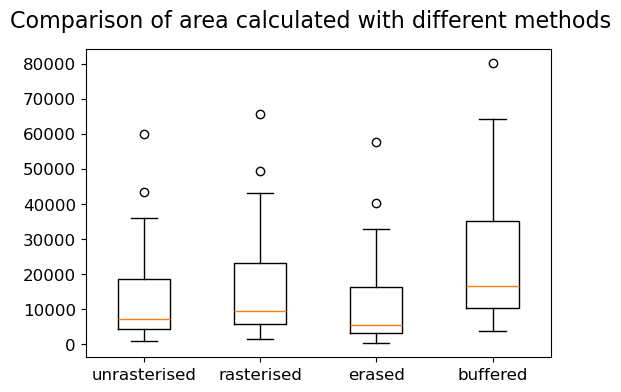

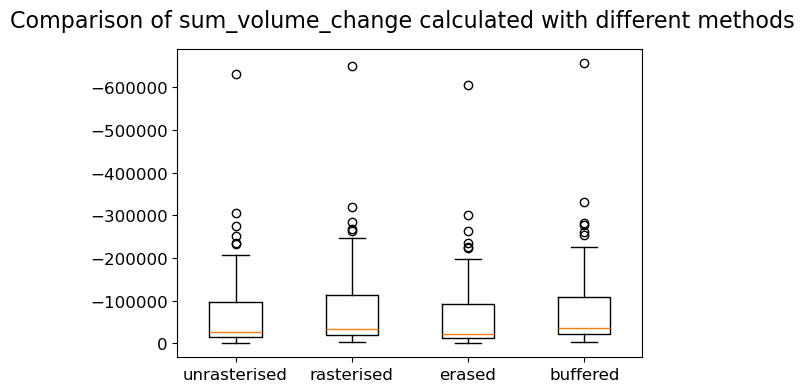

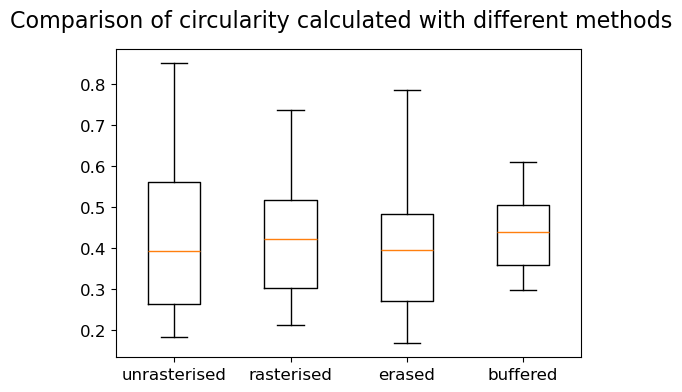

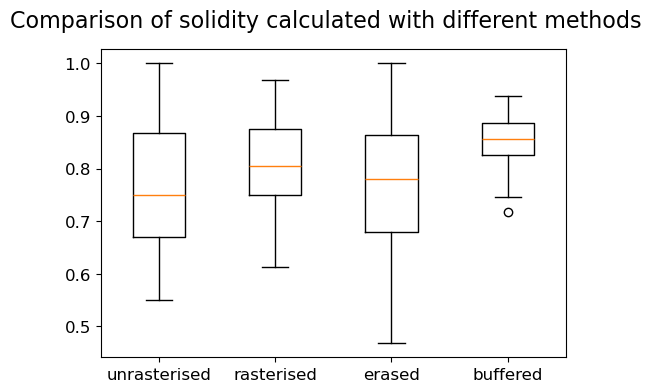

In [65]:
# Boxplot comparing volume change of unrasterised, rasterises, buffered and erased dem labels in peel 2011_2021

attributes = ["area", "sum_volume_change", "circularity", "solidity"]
region = "peel2"
year = "2011_2021"
for attribute in attributes:
    # Boxplot - IoU at pixel level with slumps which are in all df
    fig, (ax1) = plt.subplots(1, 1, figsize=(6, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

    ax1.boxplot([labels_of_year_data[region]["dem_labels"]["unrasterised"][year][attribute].dropna(), labels_of_year_data[region]["dem_labels"]["rasterised"][year][attribute].dropna(),buffered_erased[region]["dem_labels"]["erased"][year][attribute].dropna(), buffered_erased[region]["dem_labels"]["buffered"][year][attribute].dropna() ], labels=["unrasterised", 'rasterised', "erased", "buffered"])

    if attribute == "sum_volume_change":
        ax1.invert_yaxis()

    # Set titles for the subplots
    fig.suptitle(f'Comparison of {attribute} calculated with different methods')

    # Display the boxplot
    plt.show()

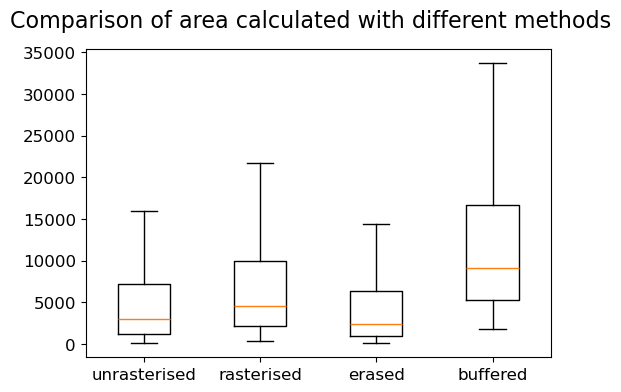

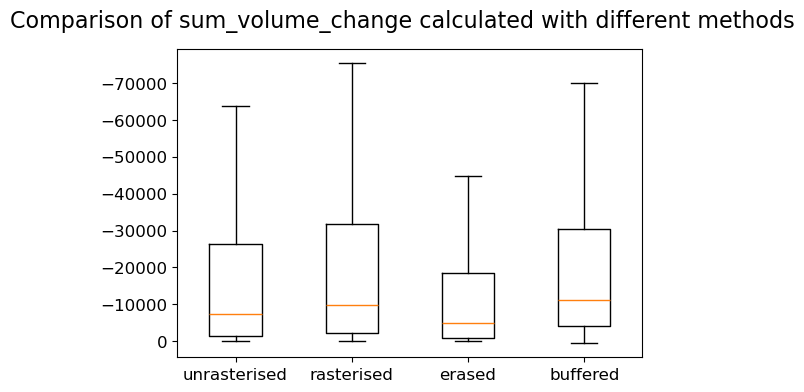

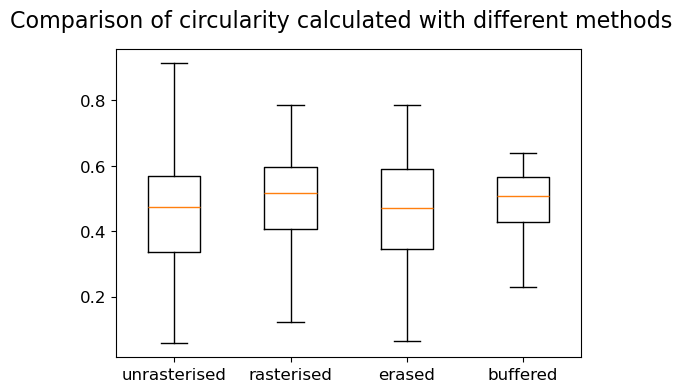

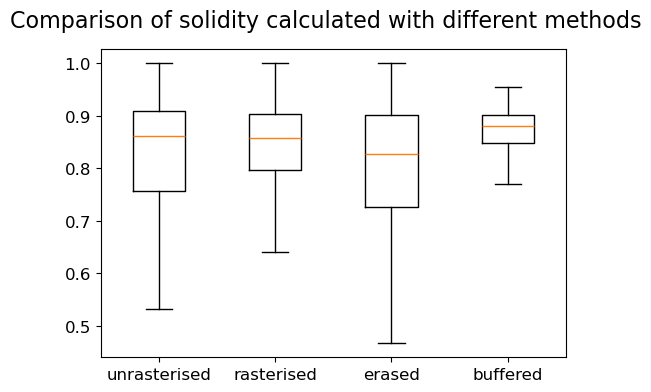

In [66]:
# Boxplot comparing volume change of unrasterised, rasterises, buffered and erased dem and opt labels in all regions

unraster_df = pd.DataFrame()
raster_df = pd.DataFrame()
erased_df = pd.DataFrame()
buffered_df = pd.DataFrame()

for region in labels_of_year_data:
    for label_groupe in labels_of_year_data[region]:
        for year in labels_of_year_data[region][label_groupe]["unrasterised"]:
            unraster_df = pd.concat([unraster_df, labels_of_year_data[region][label_groupe]["unrasterised"][year]])

        for year in labels_of_year_data[region][label_groupe]["rasterised"]:
            raster_df = pd.concat([raster_df, labels_of_year_data[region][label_groupe]["rasterised"][year]])

for region in buffered_erased:
    for label_groupe in buffered_erased[region]:
        for year in buffered_erased[region][label_groupe]["erased"]:
            erased_df = pd.concat([erased_df, buffered_erased[region][label_groupe]["erased"][year]])

        for year in buffered_erased[region][label_groupe]["buffered"]:
            buffered_df = pd.concat([buffered_df, buffered_erased[region][label_groupe]["buffered"][year]])

attributes = ["area", "sum_volume_change", "circularity", "solidity"]
for attribute in attributes:

    # Boxplot - IoU at pixel level with slumps which are in all df
    # Adjust whisker length for both subplots
    whisker_length = 1.5  # Adjust the factor here
    fig, (ax1) = plt.subplots(1, 1, figsize=(6, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))
    ax1.boxplot([unraster_df[attribute].dropna(), raster_df[attribute].dropna(), erased_df[attribute].dropna(), buffered_df[attribute].dropna() ], labels=["unrasterised", 'rasterised', "erased", "buffered"], whis=whisker_length, showfliers=False)

    if attribute == "sum_volume_change":
        ax1.invert_yaxis()

    # Set titles for the subplots
    fig.suptitle(f'Comparison of {attribute} calculated with different methods')

    # Display the boxplot
    plt.show()

Fliers are not shown in the plots above

## IoU

### IoU of same labels pixel level

In [67]:
# Calculation of IoU at pixel level only for the slumps which were found in both dem and optical training data
non_intersecting = [["tuktoyaktuk", "2013_2017", "2019"],["tuktoyaktuk", "2013_2020", "2019"], ["tuktoyaktuk", "2013_2021", "2019"], ["yamal", "2010_2020", "2022"]]

IoU_pix_dem_vs_train = pd.DataFrame()
for region in labels_of_year_data:
    region_iou = {}
    for kind in labels_of_year_data[region]["dem_labels"]:
        kind_iou = {}
        for year in labels_of_year_data[region]["dem_labels"][kind]:
            counter = 0
            for opt_year in labels_of_year_data[region]["opt_train_labels"][kind]:
                counter += 1
                if counter > 1:
                    raise ValueError(f"More than one year of optical training labels {region}_{kind}")
                
                opt_train_year = opt_year
                opt_train_labels = labels_of_year_data[region]["opt_train_labels"][kind][opt_year]
            combination = [region, year, opt_year]
            if combination not in non_intersecting:
                kind_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_train_labels)
        if len(kind_iou) != 0:
            region_iou[kind] = kind_iou
    IoU_pix_of_same_labels = pd.DataFrame(region_iou).transpose()
    if region == "tuktoyaktuk":
        # Write the dataframe data to XlsxWriter
        IoU_pix_of_same_labels.to_csv('IoU_tuk_opt_train_2019.csv', index=True)
    IoU_pix_dem_vs_train = pd.concat([IoU_pix_dem_vs_train, IoU_pix_of_same_labels.transpose()], ignore_index=True)
    print(region, opt_train_year)
    print(f"These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for {region} and the optical trainings label from the year {opt_train_year}.")
    score_unraster = IoU_pix_of_same_labels.loc["unrasterised"].mean()
    score_raster = IoU_pix_of_same_labels.loc["rasterised"].mean()
    print(f"score unrasterised: {score_unraster}, score rasterised: {score_raster}")
    caption = f"IoU calculated for DEM and optical training labels in {region} that correspond to the same RTSs. The IoU was calculated at pixel level. The optical training labels are from {opt_train_year} and the period of the diff DEM is noted in the column title." 
    IoU_pix_of_same_labels.columns = IoU_pix_of_same_labels.columns.str.replace("_", " - ")
    sorted_columns = sorted(IoU_pix_of_same_labels.columns, key=extract_years) # Sort columns based on extracted year values
    IoU_pix_of_same_labels = IoU_pix_of_same_labels[sorted_columns] # Reassign the DataFrame with the sorted columns
    # export latex table
    latex_table = IoU_pix_of_same_labels.to_latex(index=True, caption=caption, label=f'tab:IoU_same_labels_dem_vs_opt_train_{region}', column_format="l "+" ".join(['r'] * len(IoU_pix_of_same_labels.columns)), float_format="{:.3f}".format, bold_rows=False)
    latex_table = latex_table.replace("\\begin{table}", "\\begin{table}[h]\\centering")
    with open(f'Kim\\Auswertungsdaten\\Tabels\\IoU_same_labels_dem_vs_opt_train_{region}.tex', 'w') as f:
        f.write(latex_table)
    
    display(IoU_pix_of_same_labels)
        


c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\geopandas\geodataframe.py:1815: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  merged_geom = block.unary_union


peel2 2022
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for peel2 and the optical trainings label from the year 2022.
score unrasterised: 0.44279367950039755, score rasterised: 0.4683987659960002


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021
unrasterised,0.317847,0.621029,0.150858,0.526155,0.598080
rasterised,0.337217,0.632255,0.189129,0.561823,0.621569


tuktoyaktuk 2019
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for tuktoyaktuk and the optical trainings label from the year 2019.
score unrasterised: 0.14850065836052065, score rasterised: 0.2002714323083858


,2010 - 2014,2010 - 2015,2010 - 2016,2010 - 2017,2010 - 2020,2010 - 2021,2014 - 2020,2014 - 2021,2015 - 2020,2015 - 2021,2016 - 2020,2016 - 2021,2017 - 2021
unrasterised,0.102305,0.148614,0.222239,0.265076,0.260432,0.223870,0.123334,0.167899,0.083604,0.076212,0.053544,0.138170,0.065209
rasterised,0.140649,0.181957,0.263761,0.298620,0.331118,0.258685,0.181692,0.244924,0.127976,0.121481,0.099282,0.239637,0.113744


yamal 2022
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for yamal and the optical trainings label from the year 2022.
score unrasterised: 0.1754787084326923, score rasterised: 0.22743234757775943


,2010 - 2016,2010 - 2021
unrasterised,0.035821,0.315136
rasterised,0.065104,0.389761


In [68]:
# Calculation of IoU at pixel level only for the slumps which were found in both dem and optical prediction data

IoU_pix_dem_vs_pred = pd.DataFrame()
for region in labels_of_year_data:
    for opt_pred_year in labels_of_year_data[region]["opt_pred_labels"]["unrasterised"]:
        opt_pred_year_iou = {}
        for kind in labels_of_year_data[region]["dem_labels"]:
            kind_iou = {}
            opt_pred_labels = labels_of_year_data[region]["opt_pred_labels"][kind][opt_pred_year]
            for year in labels_of_year_data[region]["dem_labels"][kind]:
                kind_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year], opt_pred_labels)
            opt_pred_year_iou[kind] = kind_iou
        IoU_pix_of_same_labels = pd.DataFrame(opt_pred_year_iou).transpose()
        IoU_pix_dem_vs_pred = pd.concat([IoU_pix_dem_vs_pred, IoU_pix_of_same_labels.transpose()], ignore_index=True)
        print(region, opt_pred_year)
        print(f"These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for {region} and the optical trainings label from the year {opt_pred_year}.")
        score_unraster = IoU_pix_of_same_labels.loc["unrasterised"].mean()
        score_raster = IoU_pix_of_same_labels.loc["rasterised"].mean()
        print(f"score unrasterised: {score_unraster}, score rasterised: {score_raster}")
        caption = f"IoU calculated for DEM and optical predictions in {region} that correspond to the same RTSs. The IoU was calculated at pixel level. The optical training labels are from {opt_pred_year} and the period of the diff DEM is noted in the column title." 
        IoU_pix_of_same_labels.columns = IoU_pix_of_same_labels.columns.str.replace("_", " - ")
        sorted_columns = sorted(IoU_pix_of_same_labels.columns, key=extract_years) # Sort columns based on extracted year values
        IoU_pix_of_same_labels = IoU_pix_of_same_labels[sorted_columns] # Reassign the DataFrame with the sorted columns
        # export latex table
        latex_table = IoU_pix_of_same_labels.to_latex(index=True, caption=caption, label=f'tab:IoU_same_labels_dem_vs_opt_pred_{opt_pred_year}_{region}', column_format="l "+" ".join(['r'] * len(IoU_pix_of_same_labels.columns)), float_format="{:.3f}".format, bold_rows=False)        
        latex_table = latex_table.replace("\\begin{table}", "\\begin{table}[h]\\centering")
        with open(f'Kim\\Auswertungsdaten\\Tabels\\IoU_same_labels_dem_vs_opt_pred_{opt_pred_year}_{region}.tex', 'w') as f:
            f.write(latex_table)
        display(IoU_pix_of_same_labels)
        


c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\geopandas\geodataframe.py:1815: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  merged_geom = block.unary_union


peel2 2022
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for peel2 and the optical trainings label from the year 2022.
score unrasterised: 0.4019116183749931, score rasterised: 0.43208802485968467


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021
unrasterised,0.272815,0.576436,0.211231,0.394245,0.554831
rasterised,0.308615,0.599366,0.247143,0.424600,0.580716


peel2 2021
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for peel2 and the optical trainings label from the year 2021.
score unrasterised: 0.41119893818018693, score rasterised: 0.44304467635455147


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021
unrasterised,0.306969,0.558730,0.201421,0.47483,0.514045
rasterised,0.337358,0.572256,0.252010,0.51767,0.535929


peel2 2020
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for peel2 and the optical trainings label from the year 2020.
score unrasterised: 0.38166982319658993, score rasterised: 0.4197059470357437


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021
unrasterised,0.310668,0.540678,0.181970,0.402210,0.472824
rasterised,0.344892,0.568954,0.239136,0.444426,0.501122


peel2 2018
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for peel2 and the optical trainings label from the year 2018.
score unrasterised: 0.3762420211503895, score rasterised: 0.4086529720540817


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021
unrasterised,0.473847,0.428504,0.313631,0.345001,0.320227
rasterised,0.487689,0.447394,0.358051,0.386507,0.363623


peel2 2019
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for peel2 and the optical trainings label from the year 2019.
score unrasterised: 0.3187829222610761, score rasterised: 0.36098611467413216


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021
unrasterised,0.325282,0.439469,0.232465,0.190331,0.406367
rasterised,0.356180,0.462769,0.295439,0.246638,0.443905


c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\geopandas\geodataframe.py:1815: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  merged_geom = block.unary_union


tuktoyaktuk 2021
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for tuktoyaktuk and the optical trainings label from the year 2021.
score unrasterised: 0.2075513705849047, score rasterised: 0.2583585838697617


,2010 - 2014,2010 - 2015,2010 - 2016,2010 - 2017,2010 - 2020,2010 - 2021,2013 - 2017,2013 - 2020,2013 - 2021,2014 - 2020,2014 - 2021,2015 - 2020,2015 - 2021,2016 - 2020,2016 - 2021,2017 - 2021
unrasterised,0.112809,0.144485,0.185739,0.235255,0.267436,0.274280,0.092973,0.172724,0.180484,0.246494,0.262795,0.234589,0.258256,0.203485,0.257874,0.191143
rasterised,0.160920,0.192623,0.215004,0.293044,0.317073,0.324383,0.146763,0.226361,0.225543,0.303147,0.311333,0.286522,0.308471,0.252902,0.319809,0.249839


tuktoyaktuk 2018
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for tuktoyaktuk and the optical trainings label from the year 2018.
score unrasterised: 0.24816071247613075, score rasterised: 0.3078472540117039


,2010 - 2014,2010 - 2015,2010 - 2016,2010 - 2017,2010 - 2020,2010 - 2021,2013 - 2017,2013 - 2020,2013 - 2021,2014 - 2020,2014 - 2021,2015 - 2020,2015 - 2021,2016 - 2020,2016 - 2021,2017 - 2021
unrasterised,0.150349,0.200461,0.256842,0.380332,0.325915,0.301824,0.516565,0.513766,0.462350,0.175049,0.166178,0.115823,0.116332,0.109513,0.11449,0.064781
rasterised,0.214918,0.257251,0.306497,0.429387,0.373756,0.358416,0.576560,0.572183,0.531811,0.228090,0.210721,0.173554,0.174312,0.183442,0.19631,0.138350


tuktoyaktuk 2019
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for tuktoyaktuk and the optical trainings label from the year 2019.
score unrasterised: 0.21690221087710743, score rasterised: 0.28063460663387174


,2010 - 2014,2010 - 2015,2010 - 2016,2010 - 2017,2010 - 2020,2010 - 2021,2013 - 2017,2013 - 2020,2013 - 2021,2014 - 2020,2014 - 2021,2015 - 2020,2015 - 2021,2016 - 2020,2016 - 2021,2017 - 2021
unrasterised,0.116633,0.154357,0.223656,0.301327,0.268842,0.294438,0.349762,0.376017,0.345916,0.189471,0.176969,0.150313,0.148996,0.132492,0.151780,0.089466
rasterised,0.176185,0.209639,0.289322,0.357347,0.324121,0.360447,0.416667,0.459459,0.424512,0.235955,0.217190,0.203081,0.197613,0.206222,0.235818,0.176577


tuktoyaktuk 2022
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for tuktoyaktuk and the optical trainings label from the year 2022.
score unrasterised: 0.1839264755386868, score rasterised: 0.22053883934530466


,2010 - 2014,2010 - 2015,2010 - 2016,2010 - 2017,2010 - 2020,2010 - 2021,2013 - 2017,2013 - 2020,2013 - 2021,2014 - 2020,2014 - 2021,2015 - 2020,2015 - 2021,2016 - 2020,2016 - 2021,2017 - 2021
unrasterised,0.070256,0.095612,0.158874,0.156928,0.200128,0.292727,0.063289,0.093539,0.106783,0.245649,0.242863,0.244645,0.302850,0.204656,0.246706,0.217319
rasterised,0.106592,0.135989,0.191511,0.200356,0.238814,0.338951,0.095324,0.132203,0.140575,0.268041,0.279316,0.274151,0.328225,0.245347,0.287356,0.265869


tuktoyaktuk 2020
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for tuktoyaktuk and the optical trainings label from the year 2020.
score unrasterised: 0.17079133073608457, score rasterised: 0.22780051219678732


c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\geopandas\geodataframe.py:1815: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  merged_geom = block.unary_union


,2010 - 2014,2010 - 2015,2010 - 2016,2010 - 2017,2010 - 2020,2010 - 2021,2013 - 2017,2013 - 2020,2013 - 2021,2014 - 2020,2014 - 2021,2015 - 2020,2015 - 2021,2016 - 2020,2016 - 2021,2017 - 2021
unrasterised,0.158372,0.151381,0.178930,0.197982,0.198956,0.224384,0.069671,0.172634,0.173672,0.153483,0.135153,0.193144,0.199171,0.169818,0.170793,0.185117
rasterised,0.196796,0.193622,0.226739,0.258841,0.253672,0.278890,0.131373,0.239766,0.242259,0.204188,0.186848,0.241316,0.246552,0.235746,0.240828,0.267373


yamal 2022
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for yamal and the optical trainings label from the year 2022.
score unrasterised: 0.21006198970580967, score rasterised: 0.28591022714868203


,2010 - 2016,2010 - 2020,2010 - 2021
unrasterised,0.020681,0.264623,0.344882
rasterised,0.061571,0.364198,0.431962


yamal 2018
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for yamal and the optical trainings label from the year 2018.
score unrasterised: 0.376725568437867, score rasterised: 0.44586267678652897


,2010 - 2016,2010 - 2020,2010 - 2021
unrasterised,0.422828,0.374754,0.332595
rasterised,0.468085,0.467836,0.401667


yamal 2020
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for yamal and the optical trainings label from the year 2020.
score unrasterised: 0.35894809007926054, score rasterised: 0.44131170390778474


,2010 - 2016,2010 - 2020,2010 - 2021
unrasterised,0.337043,0.426815,0.312986
rasterised,0.406832,0.506024,0.411079


yamal 2019
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for yamal and the optical trainings label from the year 2019.
score unrasterised: 0.3930684300643887, score rasterised: 0.4531350876021283


,2010 - 2016,2010 - 2020,2010 - 2021
unrasterised,0.448066,0.410869,0.320269
rasterised,0.478261,0.494048,0.387097


yamal 2021
These are the IoU at pixel level only for the slumps which were found in both dem and optical training data for yamal and the optical trainings label from the year 2021.
score unrasterised: 0.2516390136126752, score rasterised: 0.3248256231932622


,2010 - 2016,2010 - 2020,2010 - 2021
unrasterised,0.133660,0.313580,0.307677
rasterised,0.191235,0.383085,0.400157


same labels, pixel level, DEM vs. Opt Pred
- peel: IoU for timestep 10-21 always the highest for opt pred 22, 21, 20, 19. Only for 18 10-16 is higher -> proves theory that end year as close to opt year as possible for highest IoU, rasterised always bigger than unrasterised
- tuk: high IoU with close end year, often start year 13 higher than 10 -> maybe in some parts the vegetation will have grown again, not visible anymore for algorithm. Maybe depends on when the slump was very active. Generally IoU changes much more random with predicted data than with train data. Not always the earlier the start date the bigger the IoU. Sometimes 15-21 bigger than 10-21, but 16-21 smaller again for opt 2022
- yamal: the closer the end year to opt year the higher the IoU -> whether the year before or after maybe depends on whether the opt picture is rather from early summer or late summer

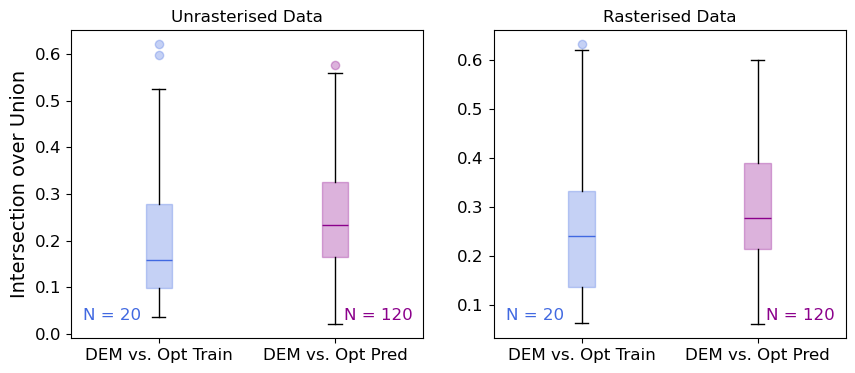

In [69]:
# Boxplot comparing DEM vs. Opt Train with DEM vs. Opt Pred

# Boxplot - IoU at pixel level with slumps which are in all df
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))

# Unrasterised Data
plot1 = ax1.boxplot([IoU_pix_dem_vs_train["unrasterised"].dropna(), IoU_pix_dem_vs_pred["unrasterised"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)

# Rasterised Data
plot2 = ax2.boxplot([IoU_pix_dem_vs_train["rasterised"].dropna(), IoU_pix_dem_vs_pred["rasterised"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)
box_colors = ['royalblue', 'darkmagenta']
for plot in [plot1, plot2]:
    for patch, median, whisker, flier, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], plot["fliers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

# Set titles for the subplots
ax1.set_title('Unrasterised Data')
ax2.set_title('Rasterised Data')
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_dem_vs_train["unrasterised"].dropna()), len(IoU_pix_dem_vs_pred["unrasterised"].dropna())]
number2 = [len(IoU_pix_dem_vs_train["rasterised"].dropna()), len(IoU_pix_dem_vs_pred["rasterised"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])

# Display the boxplot
save_fig(fig, "IoU_unrasterised_rasterised_same_labels_pix")
plt.show()

Generally over all regions and over all years, also those of opt pred which aren't in opt train, the dem labels overlap better with the predition labels than with the training labels. This is true for unrasterised and rasterised labels.

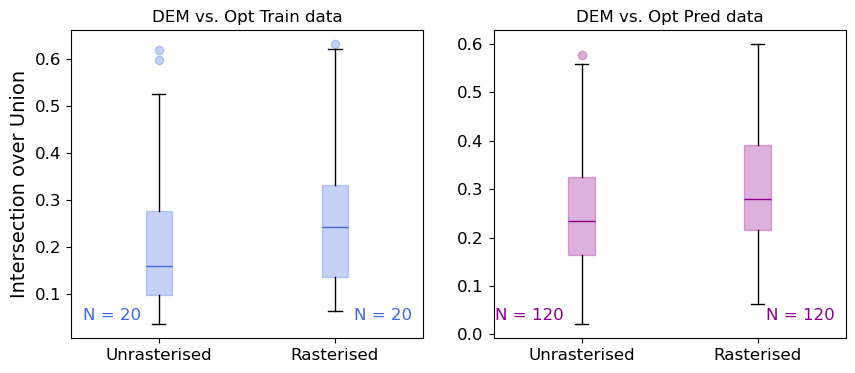

In [70]:
# Boxplot comparing unrasterised with rasterised IoUs of same labels at pixel level

# Boxplot - IoU at pixel level with slumps which are in all df
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

# DEM vs. Opt Train
plot1 = ax1.boxplot([IoU_pix_dem_vs_train["unrasterised"].dropna(), IoU_pix_dem_vs_train["rasterised"].dropna()], labels=["Unrasterised", 'Rasterised'], patch_artist=True)

# DEM vs. Opt Pred
plot2 = ax2.boxplot([IoU_pix_dem_vs_pred["unrasterised"].dropna(), IoU_pix_dem_vs_pred["rasterised"].dropna()], labels=["Unrasterised", 'Rasterised'], patch_artist=True)

box_colors = ['royalblue', 'darkmagenta']
for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, flier in zip(plot['boxes'], plot["medians"], plot["fliers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

# Set titles for the subplots
ax1.set_title('DEM vs. Opt Train data')
ax2.set_title('DEM vs. Opt Pred data')
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_dem_vs_train["unrasterised"].dropna()), len(IoU_pix_dem_vs_train["rasterised"].dropna())]
number2 = [len(IoU_pix_dem_vs_pred["unrasterised"].dropna()), len(IoU_pix_dem_vs_pred["rasterised"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])

save_fig(fig, "IoU_train_pred_same_labels_pix")
# Display the boxplot
plt.show()

Here we can see again, that the rasterised labels overlap better than the unrasterised. The rasterised labels are generally a bit bigger than the unrasterised -> If labels are bigger the probability that a pixel is labeled by both is higher?

In [71]:
# Calculation of IoU at pixel level only for the slumps which were found in both dem and optical training data
kinds = ["unrasterised", "rasterised"]
IoU_pix_unraster = pd.DataFrame()
IoU_pix_raster = pd.DataFrame()

for kind in kinds:
    for region in labels_of_year_data:
        region_iou = {}
        pred_iou = {}
        train_iou = {}
        for year in labels_of_year_data[region]["dem_labels"][kind]:
            counter = 0
            for opt_year in labels_of_year_data[region]["opt_train_labels"][kind]:
                counter += 1
                if counter > 1:
                    raise ValueError(f"More than one year of optical training labels {region}_{kind}")
                opt_train_year = opt_year
                opt_train_labels = labels_of_year_data[region]["opt_train_labels"][kind][opt_year]
                opt_pred_labels = labels_of_year_data[region]["opt_pred_labels"][kind][opt_year]
            train_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_train_labels)
            pred_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_pred_labels)
        region_iou["opt_train"] = train_iou
        region_iou["opt_pred"] = pred_iou
        IoU_pix_of_same_labels = pd.DataFrame(region_iou).transpose()
        if kind == "unrasterised":
            IoU_pix_unraster = pd.concat([IoU_pix_unraster, IoU_pix_of_same_labels.transpose()], ignore_index=True)
        else:
            IoU_pix_raster = pd.concat([IoU_pix_raster, IoU_pix_of_same_labels.transpose()], ignore_index=True)
        print(f"These are the IoU at pixel level for the {kind} labels and only for the slumps which were found in both dem and optical data for {region} and the optical trainings label from the year {opt_train_year}.")
        score_train = IoU_pix_of_same_labels.loc["opt_train"].mean()
        score_pred = IoU_pix_of_same_labels.loc["opt_pred"].mean()
        print(f"score opt train: {score_train}, score opt pred: {score_pred}")
        display(IoU_pix_of_same_labels)

IoU_pix_raster_all_regions = IoU_pix_raster.copy()
    

These are the IoU at pixel level for the unrasterised labels and only for the slumps which were found in both dem and optical data for peel2 and the optical trainings label from the year 2022.
score opt train: 0.44279367950039755, score opt pred: 0.4019116183749931


,2013_2021,2011_2021,2010_2016,2011_2016,2010_2021
opt_train,0.598080,0.526155,0.317847,0.150858,0.621029
opt_pred,0.554831,0.394245,0.272815,0.211231,0.576436


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames
There are no intersection between the two DataFrames
These are the IoU at pixel level for the unrasterised labels and only for the slumps which were found in both dem and optical data for tuktoyaktuk and the optical trainings label from the year 2019.
score opt train: 0.14850065836052068, score opt pred: 0.21690221087710743


,2010_2021,2017_2021,2016_2021,2015_2021,2014_2021,2013_2021,2010_2015,2016_2020,2015_2020,2014_2020,2010_2020,2013_2020,2010_2017,2013_2017,2010_2016,2010_2014
opt_train,0.223870,0.065209,0.13817,0.076212,0.167899,NaN,0.148614,0.053544,0.083604,0.123334,0.260432,NaN,0.265076,NaN,0.222239,0.102305
opt_pred,0.294438,0.089466,0.15178,0.148996,0.176969,0.345916,0.154357,0.132492,0.150313,0.189471,0.268842,0.376017,0.301327,0.349762,0.223656,0.116633


There are no intersection between the two DataFrames
These are the IoU at pixel level for the unrasterised labels and only for the slumps which were found in both dem and optical data for yamal and the optical trainings label from the year 2022.
score opt train: 0.1754787084326923, score opt pred: 0.21006198970580967


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


,2010_2021,2010_2020,2010_2016
opt_train,0.315136,NaN,0.035821
opt_pred,0.344882,0.264623,0.020681


c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\geopandas\geodataframe.py:1815: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  merged_geom = block.unary_union
c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\geopandas\geodataframe.py:1815: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  merged_geom = block.unary_union


These are the IoU at pixel level for the rasterised labels and only for the slumps which were found in both dem and optical data for peel2 and the optical trainings label from the year 2022.
score opt train: 0.4683987659960002, score opt pred: 0.43208802485968467


,2013_2021,2011_2021,2010_2016,2011_2016,2010_2021
opt_train,0.621569,0.561823,0.337217,0.189129,0.632255
opt_pred,0.580716,0.424600,0.308615,0.247143,0.599366


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames
These are the IoU at pixel level for the rasterised labels and only for the slumps which were found in both dem and optical data for tuktoyaktuk and the optical trainings label from the year 2019.
score opt train: 0.2002714323083858, score opt pred: 0.28063460663387174


,2010_2021,2017_2021,2016_2021,2015_2021,2014_2021,2013_2021,2010_2015,2016_2020,2015_2020,2014_2020,2010_2020,2013_2020,2010_2017,2013_2017,2010_2016,2010_2014
opt_train,0.258685,0.113744,0.239637,0.121481,0.244924,NaN,0.181957,0.099282,0.127976,0.181692,0.331118,NaN,0.298620,NaN,0.263761,0.140649
opt_pred,0.360447,0.176577,0.235818,0.197613,0.217190,0.424512,0.209639,0.206222,0.203081,0.235955,0.324121,0.459459,0.357347,0.416667,0.289322,0.176185


There are no intersection between the two DataFrames
These are the IoU at pixel level for the rasterised labels and only for the slumps which were found in both dem and optical data for yamal and the optical trainings label from the year 2022.
score opt train: 0.22743234757775943, score opt pred: 0.28591022714868203


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


,2010_2021,2010_2020,2010_2016
opt_train,0.389761,NaN,0.065104
opt_pred,0.431962,0.364198,0.061571


dem vs optical for same labels, only year for both train and pred
Peel unraster: train better exept for 10-16, opt 2022
peel raster: same
tuk unraster: pred always better
tuk raster: sometimes train better, but no clear trend
yamal unraster/ raster: too little data to say anything relatively equalized 

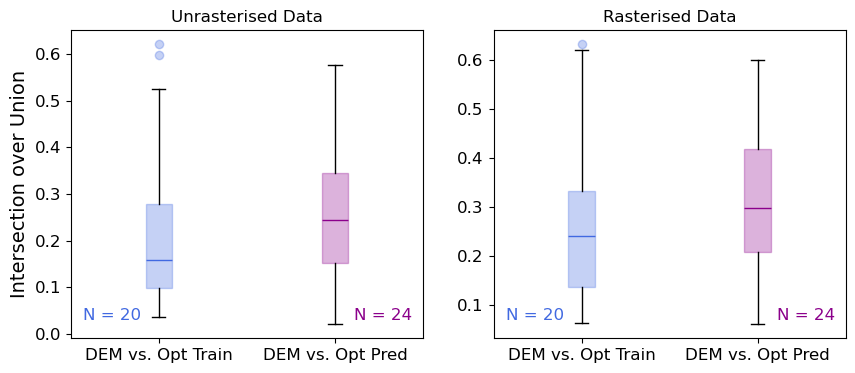

In [72]:
# Boxplot comparing DEM vs. Opt Train with DEM vs. Opt Pred but only for the opt pred year which exist also for opt train data

# Boxplot - IoU at pixel level with slumps which are in all df
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
dpi = 300
# Unrasterised Data
plot1 = ax1.boxplot([IoU_pix_unraster["opt_train"].dropna(), IoU_pix_unraster["opt_pred"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)

# Rasterised Data
plot2 = ax2.boxplot([IoU_pix_raster["opt_train"].dropna(), IoU_pix_raster["opt_pred"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)
box_colors = ['royalblue', 'darkmagenta']
for plot in [plot1, plot2]:
    for patch, median, whisker, flier, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], plot["fliers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

# Set titles for the subplots
ax1.set_title('Unrasterised Data')
ax2.set_title('Rasterised Data')
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_unraster["opt_train"].dropna()), len(IoU_pix_unraster["opt_pred"].dropna())]
number2 = [len(IoU_pix_raster["opt_train"].dropna()), len(IoU_pix_raster["opt_pred"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])

# Display the boxplot
save_fig(fig, "IoU_unraster_raster_same_labels_pix_only_equal_years_train_pred_all_regions")

plt.show()

Also only for the year for which we have opt train and opt pred labels the opt pred overlap better with the dem labels

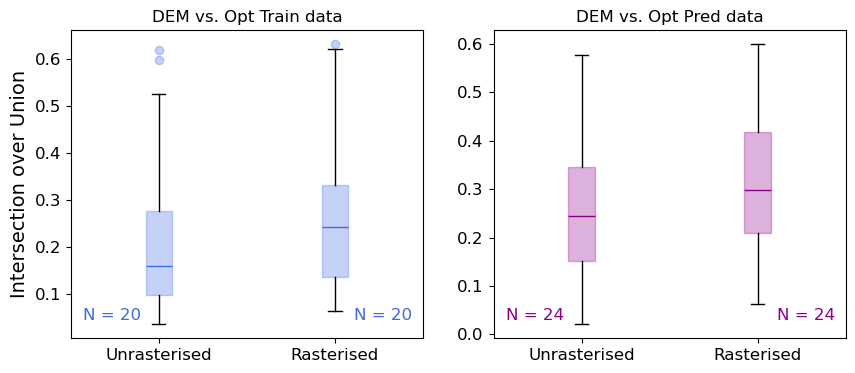

In [73]:
# Boxplot comparing unrasterised with rasterised IoUs of same labels at pixel level, opt pred only for the years for which also opt train are available

# Boxplot - IoU at pixel level with slumps which are in all df
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

# Unrasterised Data
plot1 = ax1.boxplot([IoU_pix_unraster["opt_train"].dropna(), IoU_pix_raster["opt_train"].dropna()], labels=["Unrasterised", 'Rasterised'], showfliers=True, patch_artist=True)

# Rasterised Data
plot2 = ax2.boxplot([IoU_pix_unraster["opt_pred"].dropna(), IoU_pix_raster["opt_pred"].dropna()], labels=["Unrasterised", 'Rasterised'], showfliers=True, patch_artist=True)

box_colors = ['royalblue', 'darkmagenta']
for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, flier in zip(plot['boxes'], plot["medians"], plot["fliers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

# Set titles for the subplots
ax1.set_title('DEM vs. Opt Train data')
ax2.set_title('DEM vs. Opt Pred data')
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_unraster["opt_train"].dropna()), len(IoU_pix_raster["opt_train"].dropna())]
number2 = [len(IoU_pix_unraster["opt_pred"].dropna()), len(IoU_pix_raster["opt_pred"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])

save_fig(fig, "IoU_train_pred_same_labels_pix_only_equal_years_train_pred_all_regions")
# Display the boxplot
plt.show()

In [74]:
# Calculation of IoU at pixel level only for the slumps which were found in both dem and optical training data only for tuk
kinds = ["unrasterised", "rasterised"]
region = "tuktoyaktuk"
IoU_pix_unraster = pd.DataFrame()
IoU_pix_raster = pd.DataFrame()
for kind in kinds:
    region_iou = {}
    pred_iou = {}
    train_iou = {}
    for year in labels_of_year_data[region]["dem_labels"][kind]:
        counter = 0
        for opt_year in labels_of_year_data[region]["opt_train_labels"][kind]:
            counter += 1
            if counter > 1:
                raise ValueError(f"More than one year of optical training labels {region}_{kind}")
            opt_train_year = opt_year
            opt_train_labels = labels_of_year_data[region]["opt_train_labels"][kind][opt_year]
            opt_pred_labels = labels_of_year_data[region]["opt_pred_labels"][kind][opt_year]
        train_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_train_labels)
        pred_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_pred_labels)
    region_iou["opt_train"] = train_iou
    region_iou["opt_pred"] = pred_iou
    IoU_pix_of_same_labels = pd.DataFrame(region_iou).transpose()
    if kind == "unrasterised":
        IoU_pix_unraster = pd.concat([IoU_pix_unraster, IoU_pix_of_same_labels.transpose()], ignore_index=True)
    else:
        IoU_pix_raster = pd.concat([IoU_pix_raster, IoU_pix_of_same_labels.transpose()], ignore_index=True)
    print(f"These are the IoU at pixel level for the {kind} labels and only for the slumps which were found in both dem and optical data for {region} and the optical trainings label from the year {opt_train_year}.")
    score_train = IoU_pix_of_same_labels.loc["opt_train"].mean()
    score_pred = IoU_pix_of_same_labels.loc["opt_pred"].mean()
    print(f"score opt train: {score_train}, score opt pred: {score_pred}")
    display(IoU_pix_of_same_labels)

C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames
These are the IoU at pixel level for the unrasterised labels and only for the slumps which were found in both dem and optical data for tuktoyaktuk and the optical trainings label from the year 2019.
score opt train: 0.14850065836052068, score opt pred: 0.21690221087710743


,2010_2021,2017_2021,2016_2021,2015_2021,2014_2021,2013_2021,2010_2015,2016_2020,2015_2020,2014_2020,2010_2020,2013_2020,2010_2017,2013_2017,2010_2016,2010_2014
opt_train,0.223870,0.065209,0.13817,0.076212,0.167899,NaN,0.148614,0.053544,0.083604,0.123334,0.260432,NaN,0.265076,NaN,0.222239,0.102305
opt_pred,0.294438,0.089466,0.15178,0.148996,0.176969,0.345916,0.154357,0.132492,0.150313,0.189471,0.268842,0.376017,0.301327,0.349762,0.223656,0.116633


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames
These are the IoU at pixel level for the rasterised labels and only for the slumps which were found in both dem and optical data for tuktoyaktuk and the optical trainings label from the year 2019.
score opt train: 0.2002714323083858, score opt pred: 0.28063460663387174


,2010_2021,2017_2021,2016_2021,2015_2021,2014_2021,2013_2021,2010_2015,2016_2020,2015_2020,2014_2020,2010_2020,2013_2020,2010_2017,2013_2017,2010_2016,2010_2014
opt_train,0.258685,0.113744,0.239637,0.121481,0.244924,NaN,0.181957,0.099282,0.127976,0.181692,0.331118,NaN,0.298620,NaN,0.263761,0.140649
opt_pred,0.360447,0.176577,0.235818,0.197613,0.217190,0.424512,0.209639,0.206222,0.203081,0.235955,0.324121,0.459459,0.357347,0.416667,0.289322,0.176185


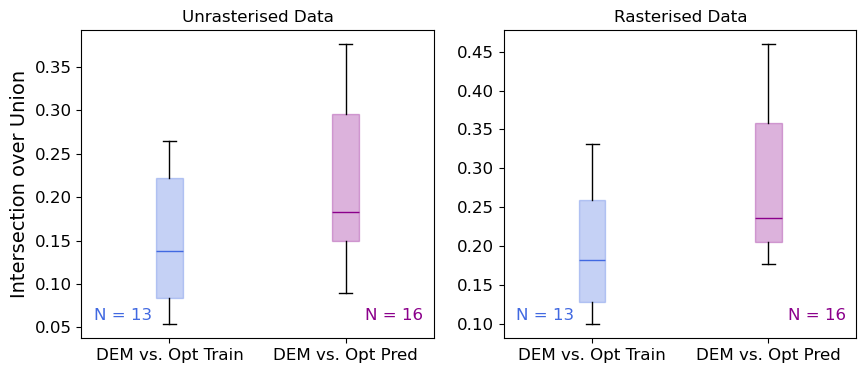

In [75]:
# Boxplot comparing DEM vs. Opt Train with DEM vs. Opt Pred but only for the opt pred year which exist also for opt train data and only for tuk

# Boxplot - IoU at pixel level with slumps which are in all df
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
dpi = 300
# Unrasterised Data
plot1 = ax1.boxplot([IoU_pix_unraster["opt_train"].dropna(), IoU_pix_unraster["opt_pred"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)

# Rasterised Data
plot2 = ax2.boxplot([IoU_pix_raster["opt_train"].dropna(), IoU_pix_raster["opt_pred"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)
box_colors = ['royalblue', 'darkmagenta']
for plot in [plot1, plot2]:
    for patch, median, whisker, flier, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], plot["fliers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

# Set titles for the subplots
ax1.set_title('Unrasterised Data')
ax2.set_title('Rasterised Data')
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_unraster["opt_train"].dropna()), len(IoU_pix_unraster["opt_pred"].dropna())]
number2 = [len(IoU_pix_raster["opt_train"].dropna()), len(IoU_pix_raster["opt_pred"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])
# Display the boxplot

save_fig(fig, "IoU_unraster_raster_same_labels_pix_only_equal_years_train_pred_tuk")
plt.show()

These are the IoU at pixel level for the unrasterised labels and only for the slumps which were found in both dem and optical data for peel2 and the optical trainings label from the year 2022.
score opt train: 0.44279367950039755, score opt pred: 0.4019116183749931


,2013_2021,2011_2021,2010_2016,2011_2016,2010_2021
opt_train,0.598080,0.526155,0.317847,0.150858,0.621029
opt_pred,0.554831,0.394245,0.272815,0.211231,0.576436


c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\geopandas\geodataframe.py:1815: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  merged_geom = block.unary_union
c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\geopandas\geodataframe.py:1815: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  merged_geom = block.unary_union


These are the IoU at pixel level for the rasterised labels and only for the slumps which were found in both dem and optical data for peel2 and the optical trainings label from the year 2022.
score opt train: 0.4683987659960002, score opt pred: 0.43208802485968467


,2013_2021,2011_2021,2010_2016,2011_2016,2010_2021
opt_train,0.621569,0.561823,0.337217,0.189129,0.632255
opt_pred,0.580716,0.424600,0.308615,0.247143,0.599366


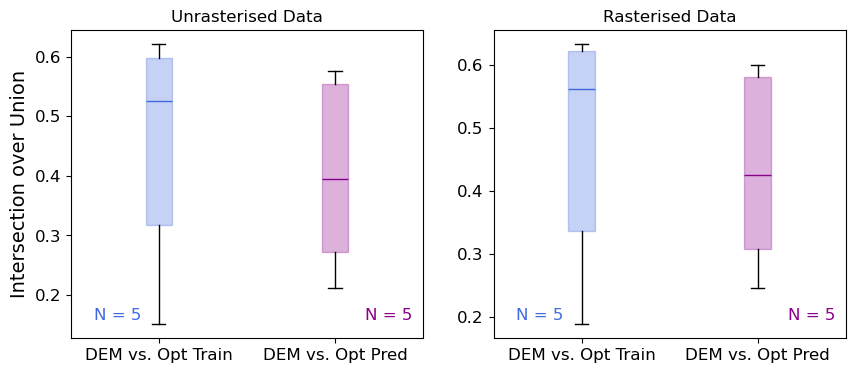

In [76]:
# Calculation of IoU at pixel level only for the slumps which were found in both dem and optical training data only for peel
kinds = ["unrasterised", "rasterised"]
region = "peel2"
IoU_pix_unraster = pd.DataFrame()
IoU_pix_raster = pd.DataFrame()
for kind in kinds:
    region_iou = {}
    pred_iou = {}
    train_iou = {}
    for year in labels_of_year_data[region]["dem_labels"][kind]:
        counter = 0
        for opt_year in labels_of_year_data[region]["opt_train_labels"][kind]:
            counter += 1
            if counter > 1:
                raise ValueError(f"More than one year of optical training labels {region}_{kind}")
            opt_train_year = opt_year
            opt_train_labels = labels_of_year_data[region]["opt_train_labels"][kind][opt_year]
            opt_pred_labels = labels_of_year_data[region]["opt_pred_labels"][kind][opt_year]
        train_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_train_labels)
        pred_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_pred_labels)
    region_iou["opt_train"] = train_iou
    region_iou["opt_pred"] = pred_iou
    IoU_pix_of_same_labels = pd.DataFrame(region_iou).transpose()
    if kind == "unrasterised":
        IoU_pix_unraster = pd.concat([IoU_pix_unraster, IoU_pix_of_same_labels.transpose()], ignore_index=True)
    else:
        IoU_pix_raster = pd.concat([IoU_pix_raster, IoU_pix_of_same_labels.transpose()], ignore_index=True)
    print(f"These are the IoU at pixel level for the {kind} labels and only for the slumps which were found in both dem and optical data for {region} and the optical trainings label from the year {opt_train_year}.")
    score_train = IoU_pix_of_same_labels.loc["opt_train"].mean()
    score_pred = IoU_pix_of_same_labels.loc["opt_pred"].mean()
    print(f"score opt train: {score_train}, score opt pred: {score_pred}")
    display(IoU_pix_of_same_labels)

# Boxplot comparing DEM vs. Opt Train with DEM vs. Opt Pred but only for the opt pred year which exist also for opt train data and only for one region

# Boxplot - IoU at pixel level with slumps which are in all df
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
dpi = 300
# Unrasterised Data
plot1 = ax1.boxplot([IoU_pix_unraster["opt_train"].dropna(), IoU_pix_unraster["opt_pred"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)

# Rasterised Data
plot2 = ax2.boxplot([IoU_pix_raster["opt_train"].dropna(), IoU_pix_raster["opt_pred"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)
box_colors = ['royalblue', 'darkmagenta']
for plot in [plot1, plot2]:
    for patch, median, whisker, flier, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], plot["fliers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

# Set titles for the subplots
ax1.set_title('Unrasterised Data')
ax2.set_title('Rasterised Data')
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_unraster["opt_train"].dropna()), len(IoU_pix_unraster["opt_pred"].dropna())]
number2 = [len(IoU_pix_raster["opt_train"].dropna()), len(IoU_pix_raster["opt_pred"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])
# Display the boxplot

save_fig(fig, f"IoU_unraster_raster_same_labels_pix_only_equal_years_train_pred_{region}")
plt.show()

If we only look at the data of peel, the training labels match better than the predicted. Because we have a lot more timesteps in tuk, and there predictions are better, it looks quite different for all the areas

There are no intersection between the two DataFrames
These are the IoU at pixel level for the unrasterised labels and only for the slumps which were found in both dem and optical data for yamal and the optical trainings label from the year 2022.
score opt train: 0.1754787084326923, score opt pred: 0.21006198970580967


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


,2010_2021,2010_2020,2010_2016
opt_train,0.315136,NaN,0.035821
opt_pred,0.344882,0.264623,0.020681


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\265407701.py:6: FutureWarning: `unary_union` returned None due to all-None GeoSeries. In future, `unary_union` will return 'GEOMETRYCOLLECTION EMPTY' instead.
  filtered_df1 = df1[df1.intersects(intersection.unary_union)]


There are no intersection between the two DataFrames
These are the IoU at pixel level for the rasterised labels and only for the slumps which were found in both dem and optical data for yamal and the optical trainings label from the year 2022.
score opt train: 0.22743234757775943, score opt pred: 0.28591022714868203


,2010_2021,2010_2020,2010_2016
opt_train,0.389761,NaN,0.065104
opt_pred,0.431962,0.364198,0.061571


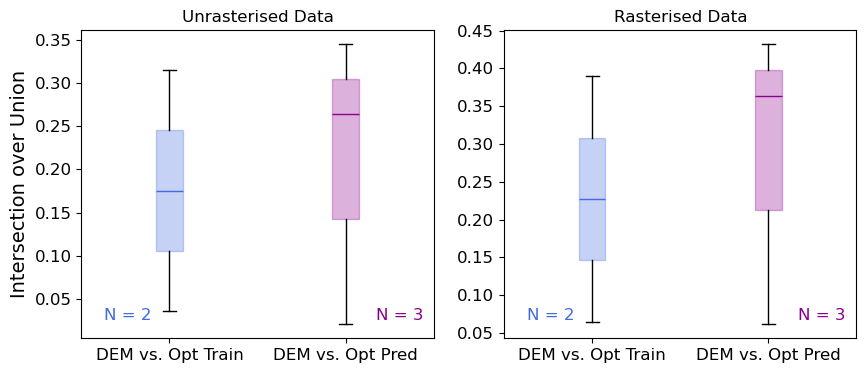

In [77]:
# Calculation of IoU at pixel level only for the slumps which were found in both dem and optical training data only for yamal
kinds = ["unrasterised", "rasterised"]
region = "yamal"
IoU_pix_unraster = pd.DataFrame()
IoU_pix_raster = pd.DataFrame()
for kind in kinds:
    region_iou = {}
    pred_iou = {}
    train_iou = {}
    for year in labels_of_year_data[region]["dem_labels"][kind]:
        counter = 0
        for opt_year in labels_of_year_data[region]["opt_train_labels"][kind]:
            counter += 1
            if counter > 1:
                raise ValueError(f"More than one year of optical training labels {region}_{kind}")
            opt_train_year = opt_year
            opt_train_labels = labels_of_year_data[region]["opt_train_labels"][kind][opt_year]
            opt_pred_labels = labels_of_year_data[region]["opt_pred_labels"][kind][opt_year]
        train_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_train_labels)
        pred_iou[year] = confusion_matrix_pixel_same_labels(labels_of_year_data[region]["dem_labels"][kind][year],opt_pred_labels)
    region_iou["opt_train"] = train_iou
    region_iou["opt_pred"] = pred_iou
    IoU_pix_of_same_labels = pd.DataFrame(region_iou).transpose()
    if kind == "unrasterised":
        IoU_pix_unraster = pd.concat([IoU_pix_unraster, IoU_pix_of_same_labels.transpose()], ignore_index=True)
    else:
        IoU_pix_raster = pd.concat([IoU_pix_raster, IoU_pix_of_same_labels.transpose()], ignore_index=True)
    print(f"These are the IoU at pixel level for the {kind} labels and only for the slumps which were found in both dem and optical data for {region} and the optical trainings label from the year {opt_train_year}.")
    score_train = IoU_pix_of_same_labels.loc["opt_train"].mean()
    score_pred = IoU_pix_of_same_labels.loc["opt_pred"].mean()
    print(f"score opt train: {score_train}, score opt pred: {score_pred}")
    display(IoU_pix_of_same_labels)

# Boxplot comparing DEM vs. Opt Train with DEM vs. Opt Pred but only for the opt pred year which exist also for opt train data and only for one region

# Boxplot - IoU at pixel level with slumps which are in all df
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
dpi = 300
# Unrasterised Data
plot1 = ax1.boxplot([IoU_pix_unraster["opt_train"].dropna(), IoU_pix_unraster["opt_pred"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)

# Rasterised Data
plot2 = ax2.boxplot([IoU_pix_raster["opt_train"].dropna(), IoU_pix_raster["opt_pred"].dropna()], labels=["DEM vs. Opt Train", 'DEM vs. Opt Pred'], showfliers=True, patch_artist=True)
box_colors = ['royalblue', 'darkmagenta']
for plot in [plot1, plot2]:
    for patch, median, whisker, flier, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], plot["fliers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

# Set titles for the subplots
ax1.set_title('Unrasterised Data')
ax2.set_title('Rasterised Data')
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_unraster["opt_train"].dropna()), len(IoU_pix_unraster["opt_pred"].dropna())]
number2 = [len(IoU_pix_raster["opt_train"].dropna()), len(IoU_pix_raster["opt_pred"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])
# Display the boxplot

save_fig(fig, f"IoU_unraster_raster_same_labels_pix_only_equal_years_train_pred_{region}")
plt.show()

### IoU of all labels at pixel level

In [78]:
# Calculation of IoU at pixel level for all the slumps which were found in either dem or optical training data, opt pred only in years for which also opt train exist, all regions
non_intersecting = [["tuktoyaktuk", "2013_2017", "2019"],["tuktoyaktuk", "2013_2020", "2019"], ["tuktoyaktuk", "2013_2021", "2019"], ["yamal", "2010_2020", "2022"]]

kinds = ["unrasterised", "rasterised"]
IoU_pix_unraster_all = pd.DataFrame()
IoU_pix_raster_all = pd.DataFrame()
for kind in kinds:
    for region in labels_of_year_data:
        region_iou = {}
        pred_iou = {}
        train_iou = {}
        pred_len_dem = {}
        pred_len = {}
        pred_len_inters = {}
        train_len_dem = {}
        train_len = {}
        train_len_inters = {}
        for year in labels_of_year_data[region]["dem_labels"][kind]:
            counter = 0
            for opt_year in labels_of_year_data[region]["opt_train_labels"][kind]:
                counter += 1
                if counter > 1:
                    raise ValueError(f"More than one year of optical training labels {region}_{kind}")
                opt_train_year = opt_year
                opt_train_labels = labels_of_year_data[region]["opt_train_labels"][kind][opt_year]
                opt_pred_labels = labels_of_year_data[region]["opt_pred_labels"][kind][opt_year]
            combination = [region, year, opt_train_year]
            if combination not in non_intersecting:
                try:
                    train_iou[year], train_len_dem[year], train_len[year], train_len_inters[year] = confusion_matrix_pixel_all_labels_opt_train(labels_of_year_data[region]["dem_labels"][kind][year],opt_train_labels, fp_of_year_data[region][int(opt_train_year)], merged_diff_polygons[region][year])
                    pred_iou[year], pred_len_dem[year], pred_len[year], pred_len_inters[year] = confusion_matrix_pixel_all_labels_opt_pred(labels_of_year_data[region]["dem_labels"][kind][year],opt_pred_labels, merged_diff_polygons[region][year])
                except:
                    print(f"Error {region}, {year}, {opt_year}")
        region_iou["opt_train"], region_iou["amount_dem_train"], region_iou["amount_opt_train"], region_iou["amount_intersections_train"] = train_iou, train_len_dem, train_len, train_len_inters
        region_iou["opt_pred"], region_iou["amount_dem_pred"], region_iou["amount_pred"], region_iou["amount_intersections_pred"] = pred_iou, pred_len_dem, pred_len, pred_len_inters
        IoU_pix_of_all_labels = pd.DataFrame(region_iou).transpose()
        if kind == "unrasterised":
            IoU_pix_unraster_all = pd.concat([IoU_pix_unraster_all, IoU_pix_of_all_labels.transpose()], ignore_index=True)
        else:
            IoU_pix_raster_all = pd.concat([IoU_pix_raster_all, IoU_pix_of_all_labels.transpose()], ignore_index=True)
        print(f"These are the IoU at pixel level for the {kind} labels for all the slumpes for {region} and the optical trainings label from the year {opt_train_year}.")
        score_train = IoU_pix_of_all_labels.loc["opt_train"].mean()
        score_pred = IoU_pix_of_all_labels.loc["opt_pred"].mean()
        print(f"score opt train: {score_train}, score opt pred: {score_pred}")
        caption = f"IoU calculated for all DEM labels and optical training labels or optical predictions in {region}. The IoU was calculated at pixel level. The optical training labels are from {opt_train_year} and the period of the diff DEM is noted in the column title." 
        IoU_pix_of_all_labels.columns = IoU_pix_of_all_labels.columns.str.replace("_", " - ")
        sorted_columns = sorted(IoU_pix_of_all_labels.columns, key=extract_years) # Sort columns based on extracted year values
        IoU_pix_of_all_labels = IoU_pix_of_all_labels[sorted_columns] # Reassign the DataFrame with the sorted columns
        latex_table = IoU_pix_of_all_labels.to_latex(index=True, caption=caption, label=f'tab:IoU_all_{kind}_labels_{region}', column_format="l "+" ".join(['r'] * len(IoU_pix_of_all_labels.columns)), float_format="{:.3f}".format, bold_rows=False)
        latex_table = latex_table.replace("\\begin{table}", "\\begin{table}[h]\\centering")
        with open(f'Kim\\Auswertungsdaten\\Tabels\\IoU_all_{kind}_labels_{region}.tex', 'w') as f:
            f.write(latex_table)
        display(IoU_pix_of_all_labels)

These are the IoU at pixel level for the unrasterised labels for all the slumpes for peel2 and the optical trainings label from the year 2022.
score opt train: 0.1856127619483073, score opt pred: 0.18523250298869331


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021
opt_train,0.056272,0.152674,0.11469,0.444759,0.159669
amount_dem_train,4.000000,12.000000,48.00000,57.000000,17.000000
amount_opt_train,7.000000,7.000000,54.00000,54.000000,80.000000
amount_intersections_train,2.000000,6.000000,33.00000,48.000000,14.000000
opt_pred,0.127256,0.229366,0.11072,0.223394,0.235425
amount_dem_pred,14.000000,25.000000,51.00000,61.000000,33.000000
amount_pred,19.000000,19.000000,39.00000,39.000000,74.000000
amount_intersections_pred,5.000000,11.000000,21.00000,29.000000,15.000000


These are the IoU at pixel level for the unrasterised labels for all the slumpes for tuktoyaktuk and the optical trainings label from the year 2019.
score opt train: 0.05067267388184488, score opt pred: 0.09240956999505823


,2010 - 2014,2010 - 2015,2010 - 2016,2010 - 2017,2010 - 2020,2010 - 2021,2014 - 2020,2014 - 2021,2015 - 2020,2015 - 2021,2016 - 2020,2016 - 2021,2017 - 2021
opt_train,0.042182,0.061768,0.055533,0.060465,0.066286,0.114956,0.054499,0.077344,0.035436,0.032348,0.012614,0.029886,0.015428
amount_dem_train,3.000000,3.000000,5.000000,4.000000,5.000000,13.000000,4.000000,4.000000,4.000000,4.000000,5.000000,3.000000,4.000000
amount_opt_train,20.000000,20.000000,41.000000,41.000000,41.000000,41.000000,20.000000,20.000000,20.000000,20.000000,41.000000,41.000000,41.000000
amount_intersections_train,3.000000,3.000000,5.000000,4.000000,7.000000,13.000000,9.000000,9.000000,5.000000,7.000000,5.000000,8.000000,5.000000
opt_pred,0.049710,0.065425,0.178340,0.135471,0.126091,0.229620,0.077591,0.078832,0.056160,0.057336,0.051033,0.060720,0.034995
amount_dem_pred,7.000000,7.000000,32.000000,10.000000,11.000000,41.000000,8.000000,8.000000,8.000000,8.000000,11.000000,9.000000,10.000000
amount_pred,39.000000,40.000000,63.000000,63.000000,63.000000,63.000000,39.000000,39.000000,40.000000,40.000000,63.000000,63.000000,63.000000
amount_intersections_pred,9.000000,8.000000,31.000000,10.000000,13.000000,38.000000,5.000000,6.000000,5.000000,5.000000,11.000000,12.000000,12.000000


Error yamal, 2010_2016, 2022
These are the IoU at pixel level for the unrasterised labels for all the slumpes for yamal and the optical trainings label from the year 2022.
score opt train: 0.2302392797147168, score opt pred: 0.21110462121778498


,2010 - 2021
opt_train,0.230239
amount_dem_train,11.000000
amount_opt_train,17.000000
amount_intersections_train,13.000000
opt_pred,0.211105
amount_dem_pred,19.000000
amount_pred,25.000000
amount_intersections_pred,16.000000


These are the IoU at pixel level for the rasterised labels for all the slumpes for peel2 and the optical trainings label from the year 2022.
score opt train: 0.20045868325527408, score opt pred: 0.19421669728740015


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021
opt_train,0.064171,0.176353,0.138284,0.466253,0.157233
amount_dem_train,4.000000,12.000000,48.000000,57.000000,17.000000
amount_opt_train,7.000000,7.000000,53.000000,53.000000,77.000000
amount_intersections_train,2.000000,6.000000,32.000000,45.000000,15.000000
opt_pred,0.139843,0.235970,0.129623,0.235967,0.229680
amount_dem_pred,14.000000,25.000000,51.000000,61.000000,33.000000
amount_pred,19.000000,19.000000,39.000000,39.000000,73.000000
amount_intersections_pred,4.000000,11.000000,21.000000,29.000000,14.000000


These are the IoU at pixel level for the rasterised labels for all the slumpes for tuktoyaktuk and the optical trainings label from the year 2019.
score opt train: 0.06449099369094273, score opt pred: 0.1130315052105091


,2010 - 2014,2010 - 2015,2010 - 2016,2010 - 2017,2010 - 2020,2010 - 2021,2014 - 2020,2014 - 2021,2015 - 2020,2015 - 2021,2016 - 2020,2016 - 2021,2017 - 2021
opt_train,0.054985,0.071600,0.061911,0.064013,0.078190,0.128587,0.075766,0.107461,0.051190,0.048723,0.022092,0.048366,0.025498
amount_dem_train,3.000000,3.000000,5.000000,4.000000,3.000000,13.000000,4.000000,2.000000,4.000000,4.000000,5.000000,3.000000,4.000000
amount_opt_train,11.000000,11.000000,28.000000,28.000000,28.000000,28.000000,11.000000,11.000000,11.000000,11.000000,28.000000,28.000000,28.000000
amount_intersections_train,3.000000,3.000000,5.000000,4.000000,6.000000,13.000000,5.000000,6.000000,4.000000,4.000000,8.000000,4.000000,5.000000
opt_pred,0.069444,0.080668,0.217521,0.145386,0.138486,0.270692,0.090400,0.091547,0.070218,0.070383,0.073768,0.086970,0.063927
amount_dem_pred,7.000000,7.000000,32.000000,10.000000,9.000000,41.000000,8.000000,6.000000,8.000000,8.000000,11.000000,9.000000,10.000000
amount_pred,38.000000,39.000000,62.000000,62.000000,62.000000,62.000000,38.000000,38.000000,39.000000,39.000000,62.000000,62.000000,62.000000
amount_intersections_pred,8.000000,7.000000,32.000000,10.000000,12.000000,35.000000,5.000000,6.000000,5.000000,5.000000,13.000000,10.000000,9.000000


Error yamal, 2010_2016, 2022
These are the IoU at pixel level for the rasterised labels for all the slumpes for yamal and the optical trainings label from the year 2022.
score opt train: 0.2813067150635209, score opt pred: 0.24605678233438485


,2010 - 2021
opt_train,0.281307
amount_dem_train,11.000000
amount_opt_train,15.000000
amount_intersections_train,12.000000
opt_pred,0.246057
amount_dem_pred,19.000000
amount_pred,23.000000
amount_intersections_pred,17.000000


In tuk the IoU of all the rasterised labels is bigger again, but for the other regions its quite equalized
also for train vs. pred only in tuk pred always bigger other region equalized

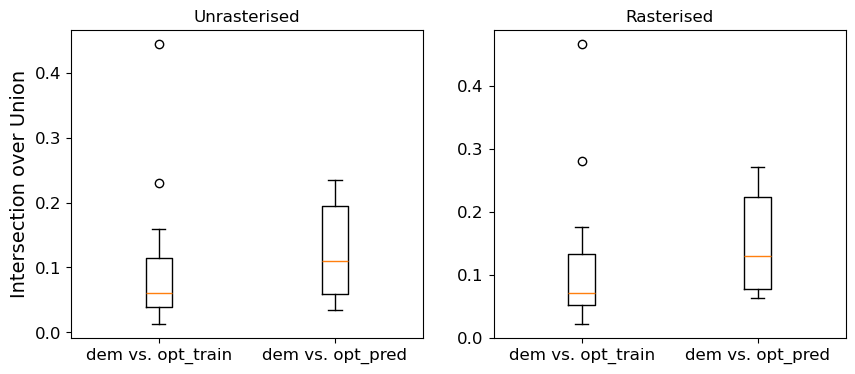

In [79]:
# Boxplot comparing unrasterised with rasterised IoUs of all labels at pixel level

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

# unrasterised
ax1.boxplot([IoU_pix_unraster_all["opt_train"].dropna(), IoU_pix_unraster_all["opt_pred"].dropna()], labels=["dem vs. opt_train", 'dem vs. opt_pred'])

# Rasterised Data
ax2.boxplot([IoU_pix_raster_all["opt_train"].dropna(), IoU_pix_raster_all["opt_pred"].dropna()], labels=["dem vs. opt_train", 'dem vs. opt_pred'])

# Set titles for the subplots
ax1.set_title("Unrasterised")
ax2.set_title("Rasterised")
ax1.set_ylabel('Intersection over Union')

# Display the boxplot
plt.show()

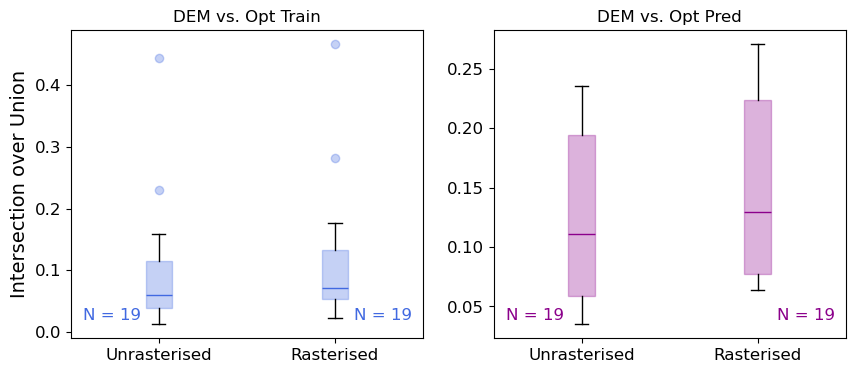

In [80]:
# Boxplot comparing unrasterised with rasterised IoUs of all labels at pixel level

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

box_colors = ['royalblue', 'darkmagenta']
# opt_train
plot1 = ax1.boxplot([IoU_pix_unraster_all["opt_train"].dropna(), IoU_pix_raster_all["opt_train"].dropna()], labels=["Unrasterised", "Rasterised"],patch_artist=True)

# opt_pred
plot2 = ax2.boxplot([IoU_pix_unraster_all["opt_pred"].dropna(), IoU_pix_raster_all["opt_pred"].dropna()], labels=["Unrasterised", "Rasterised"], patch_artist=True)

for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, flier in zip(plot['boxes'], plot["medians"], plot["fliers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

    
# Set titles for the subplots
ax1.set_title("DEM vs. Opt Train")
ax2.set_title("DEM vs. Opt Pred")
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_unraster_all["opt_train"].dropna()), len(IoU_pix_raster_all["opt_train"].dropna())]
number2 = [len(IoU_pix_unraster_all["opt_pred"].dropna()), len(IoU_pix_raster_all["opt_pred"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])

# Display the boxplot
save_fig(fig, "IoU_train_pred_all_labels_pix_only_equal_years_train_pred_all_regions")
plt.show()

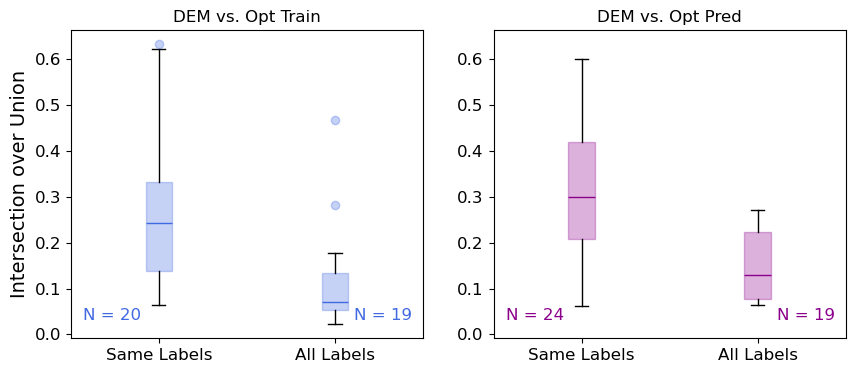

In [81]:
# Boxplot comparing IoUs of same labels and all labels at pixel level

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

box_colors = ['royalblue', 'darkmagenta']
# opt_train
plot1 = ax1.boxplot([IoU_pix_raster_all_regions["opt_train"].dropna(), IoU_pix_raster_all["opt_train"].dropna()], labels=["Same Labels", "All Labels"],patch_artist=True)

# opt_pred
plot2 = ax2.boxplot([IoU_pix_raster_all_regions["opt_pred"].dropna(), IoU_pix_raster_all["opt_pred"].dropna()], labels=["Same Labels", "All Labels"], patch_artist=True)

for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, flier in zip(plot['boxes'], plot["medians"], plot["fliers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)

# Set y-axis limits to be the same for both subplots
y_min = min(ax1.get_ylim()[0], ax2.get_ylim()[0])
y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
ax1.set_ylim(y_min, y_max)
ax2.set_ylim(y_min, y_max)

    
# Set titles for the subplots
ax1.set_title("DEM vs. Opt Train")
ax2.set_title("DEM vs. Opt Pred")
ax1.set_ylabel('Intersection over Union')

number1 = [len(IoU_pix_raster_all_regions["opt_train"].dropna()), len(IoU_pix_raster_all["opt_train"].dropna())]
number2 = [len(IoU_pix_raster_all_regions["opt_pred"].dropna()), len(IoU_pix_raster_all["opt_pred"].dropna())]

# Add text to the upper right corner
ax1.text(0.2, 0.1, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])
ax1.text(0.97, 0.1, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0])

ax2.text(0.2, 0.1, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])
ax2.text(0.97, 0.1, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1])

# Display the boxplot
save_fig(fig, "IoU_same_vs_all_lables")
plt.show()

### F1 score

In [82]:
# Calculation of F1 score

kinds = ["unrasterised", "rasterised"]
F1_score_unraster = pd.DataFrame()
F1_score_raster = pd.DataFrame()
for kind in kinds:
    for region in labels_of_year_data:
        region_F1 = {}
        pred_F1 = {}
        pred_prec = {}
        pred_rec = {}
        train_F1 = {}
        train_prec = {}
        train_rec = {}
        for year in labels_of_year_data[region]["dem_labels"][kind]:
            counter = 0
            for opt_year in labels_of_year_data[region]["opt_train_labels"][kind]:
                counter += 1
                if counter > 1:
                    raise ValueError(f"More than one year of optical training labels {region}_{kind}")
                opt_train_year = opt_year
                opt_train_labels = labels_of_year_data[region]["opt_train_labels"][kind][opt_year]
                opt_pred_labels = labels_of_year_data[region]["opt_pred_labels"][kind][opt_year]
            try:
                train_F1[year], train_prec[year], train_rec[year] = F1_score_dem_opt_train(labels_of_year_data[region]["dem_labels"][kind][year],opt_train_labels, fp_of_year_data[region][int(opt_train_year)], merged_diff_polygons[region][year])
                pred_F1[year], pred_prec[year], pred_rec[year] = F1_score_dem_opt_pred(labels_of_year_data[region]["dem_labels"][kind][year],opt_pred_labels,  merged_diff_polygons[region][year])
            except:
                print(f"Error {region}, {year}, {opt_year}")
        if region == "peel2":
            try:
                year = "2010/2011/2013_2021"
                labels = pd.concat([labels_of_year_data[region]["dem_labels"][kind]["2010_2021"], labels_of_year_data[region]["dem_labels"][kind]["2011_2021"], labels_of_year_data[region]["dem_labels"][kind]["2013_2021"]])
                train_F1[year], train_prec[year], train_rec[year] = F1_score_dem_opt_train(labels, opt_train_labels, fp_of_year_data[region][int(opt_train_year)], merged_diff_polygons[region]["2013_2021"])
                pred_F1[year], pred_prec[year], pred_rec[year] = F1_score_dem_opt_pred(labels, opt_pred_labels,  merged_diff_polygons[region]["2013_2021"])
            except:
                print(f"Error {region}, {year}, {opt_year}")
        elif region== "yamal":
            try:
                year = "2010_2020/2021"
                labels = pd.concat([labels_of_year_data[region]["dem_labels"][kind]["2010_2020"], labels_of_year_data[region]["dem_labels"][kind]["2010_2021"]])
                train_F1[year], train_prec[year], train_rec[year] = F1_score_dem_opt_train(labels, opt_train_labels, fp_of_year_data[region][int(opt_train_year)], merged_diff_polygons[region]["2010_2020"])
                pred_F1[year], pred_prec[year], pred_rec[year] = F1_score_dem_opt_pred(labels, opt_pred_labels,  merged_diff_polygons[region]["2010_2020"])
            except:
                print(f"Error {region}, {year}, {opt_year}")
        region_F1["opt_train"] = train_F1
        region_F1["train_precision"] = train_prec
        region_F1["train_recall"] = train_rec
        region_F1["opt_pred"] = pred_F1
        region_F1["pred_precision"] = pred_prec
        region_F1["pred_recall"] = pred_rec
        F1_score = pd.DataFrame(region_F1).transpose()
        if kind == "unrasterised":
            F1_score_unraster = pd.concat([F1_score_unraster, F1_score.transpose()], ignore_index=True)
        else:
            F1_score_raster = pd.concat([F1_score_raster, F1_score.transpose()], ignore_index=True)
        print(f"These are the F1 scores for the {kind} labels for all the slumpes for {region} and the optical trainings label from the year {opt_train_year}.")
        score_train = F1_score.loc["opt_train"].mean()
        score_pred = F1_score.loc["opt_pred"].mean()
        print(f"score opt train: {score_train}, score opt pred: {score_pred}")
        if region == "tuktoyaktuk" and kind == "rasterised":
            # Write the dataframe data to XlsxWriter
            F1_score.to_csv('F1_tuk_raster.csv', index=True)
        caption = f"F1 Score calculated for the DEM labels and optical training labels or optical predictions in {region}. The optical labels are from {opt_train_year} and the period of the diff DEM is noted in the column title." 
        F1_score.columns = F1_score.columns.str.replace("_", " - ")
        if region == "peel2":
            F1_score_multi_year = F1_score["2010/2011/2013 - 2021"]
            F1_score = F1_score.drop(columns=["2010/2011/2013 - 2021"])
        elif region == "yamal":
            F1_score_multi_year = F1_score["2010 - 2020/2021"]
            F1_score = F1_score.drop(columns=["2010 - 2020/2021"])
        sorted_columns = sorted(F1_score.columns, key=extract_years) # Sort columns based on extracted year values
        F1_score = F1_score[sorted_columns] # Reassign the DataFrame with the sorted columns
        if region == "peel2":
            F1_score["2010/2011/2013 - 2021"] = F1_score_multi_year
        elif region == "yamal":
            F1_score["2010 - 2020/2021"] = F1_score_multi_year
        latex_table = F1_score.to_latex(index=True, caption=caption, label=f'tab:F1_{kind}_labels_{region}', column_format="l "+" ".join(['r'] * len(F1_score.columns)), float_format="{:.3f}".format, bold_rows=False)
        latex_table = latex_table.replace("\\begin{table}", "\\begin{table}[h]\\centering")
        with open(f'Kim\\Auswertungsdaten\\Tabels\\F1_{kind}_labels_{region}.tex', 'w') as f:
            f.write(latex_table)
        if region == "tuktoyaktuk":
            F1_score = F1_score[["2010 - 2016", "2010 - 2021"]]
            latex_table = F1_score.to_latex(index=True, caption=caption, label=f'tab:F1_{kind}_labels_{region}', column_format="l "+" ".join(['r'] * len(F1_score.columns)), float_format="{:.3f}".format, bold_rows=False)            
            latex_table = latex_table.replace("\\begin{table}", "\\begin{table}[h]\\centering")
            with open(f'Kim\\Auswertungsdaten\\Tabels\\F1_{kind}_labels_{region}_filtered.tex', 'w') as f:
                f.write(latex_table)
        display(F1_score)

These are the F1 scores for the unrasterised labels for all the slumpes for peel2 and the optical trainings label from the year 2022.
score opt train: 0.5590118838747998, score opt pred: 0.4199943079696722


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021,2010/2011/2013 - 2021
opt_train,0.363636,0.631579,0.545455,0.781818,0.239130,0.792453
train_precision,0.500000,0.500000,0.586957,0.754386,0.687500,0.759036
train_recall,0.285714,0.857143,0.509434,0.811321,0.144737,0.828947
opt_pred,0.250000,0.511628,0.390805,0.585859,0.194175,0.587500
pred_precision,0.285714,0.440000,0.346939,0.475410,0.312500,0.528090
pred_recall,0.222222,0.611111,0.447368,0.763158,0.140845,0.661972


Error tuktoyaktuk, 2013_2021, 2019
Error tuktoyaktuk, 2013_2020, 2019
Error tuktoyaktuk, 2013_2017, 2019
These are the F1 scores for the unrasterised labels for all the slumpes for tuktoyaktuk and the optical trainings label from the year 2019.
score opt train: 0.13080015265822414, score opt pred: 0.26531744163215626


,2010 - 2016,2010 - 2021
opt_train,0.123077,0.281690
train_precision,1.000000,1.000000
train_recall,0.065574,0.163934
opt_pred,0.597701,0.617021
pred_precision,0.838710,0.763158
pred_recall,0.464286,0.517857


Error yamal, 2010_2020, 2022
These are the F1 scores for the unrasterised labels for all the slumpes for yamal and the optical trainings label from the year 2022.
score opt train: 0.46585695006747635, score opt pred: 0.3579894666871197


,2010 - 2016,2010 - 2021,2010 - 2020/2021
opt_train,0.105263,0.692308,0.600000
train_precision,1.000000,0.818182,0.750000
train_recall,0.055556,0.600000,0.500000
opt_pred,0.133333,0.487805,0.452830
pred_precision,1.000000,0.526316,0.480000
pred_recall,0.071429,0.454545,0.428571


These are the F1 scores for the rasterised labels for all the slumpes for peel2 and the optical trainings label from the year 2022.
score opt train: 0.56911289397581, score opt pred: 0.43148856084323534


,2010 - 2016,2010 - 2021,2011 - 2016,2011 - 2021,2013 - 2021,2010/2011/2013 - 2021
opt_train,0.363636,0.631579,0.606061,0.781818,0.239130,0.792453
train_precision,0.500000,0.500000,0.652174,0.754386,0.687500,0.759036
train_recall,0.285714,0.857143,0.566038,0.811321,0.144737,0.828947
opt_pred,0.250000,0.511628,0.459770,0.585859,0.194175,0.587500
pred_precision,0.285714,0.440000,0.408163,0.475410,0.312500,0.528090
pred_recall,0.222222,0.611111,0.526316,0.763158,0.140845,0.661972


Error tuktoyaktuk, 2013_2021, 2019
Error tuktoyaktuk, 2013_2020, 2019
Error tuktoyaktuk, 2013_2017, 2019
These are the F1 scores for the rasterised labels for all the slumpes for tuktoyaktuk and the optical trainings label from the year 2019.
score opt train: 0.13179428098782936, score opt pred: 0.26531744163215626


,2010 - 2016,2010 - 2021
opt_train,0.125000,0.285714
train_precision,1.000000,1.000000
train_recall,0.066667,0.166667
opt_pred,0.597701,0.617021
pred_precision,0.838710,0.763158
pred_recall,0.464286,0.517857


Error yamal, 2010_2020, 2022
These are the F1 scores for the rasterised labels for all the slumpes for yamal and the optical trainings label from the year 2022.
score opt train: 0.46585695006747635, score opt pred: 0.3579894666871197


,2010 - 2016,2010 - 2021,2010 - 2020/2021
opt_train,0.105263,0.692308,0.600000
train_precision,1.000000,0.818182,0.750000
train_recall,0.055556,0.600000,0.500000
opt_pred,0.133333,0.487805,0.452830
pred_precision,1.000000,0.526316,0.480000
pred_recall,0.071429,0.454545,0.428571


Now all labels are filtered that only the labels are taken which are within the footprint and the diff dem. In peel 2013_2021 only part of the RTS were labeled, but if we look at the whole are for 2013 and take labels from 10 and 11 where these from 13 are missing we get a similarly high F1 score as for 10 and 11 alone.

Yamal 2010 - 2020 whole diff dem but only partly labeled -> add 2010 - 2021 to 2010 - 2020

For the F1 score it should not matter if the labels are rasterised or not. Sometimes still bigger F1 for rasterised, because of count different -> bigger surface, higher chance of 50% overlap, dem amount stays the same  -> higher 

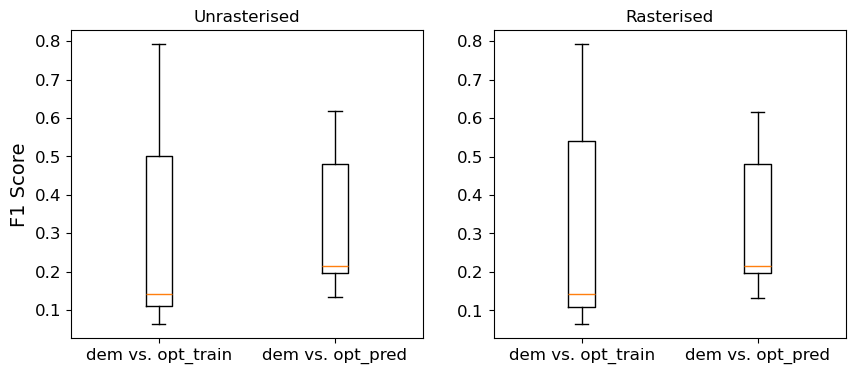

In [83]:
# Boxplot comparing dem with opt train or opt pred F1 scores

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

# unrasterised
ax1.boxplot([F1_score_unraster["opt_train"].dropna(), F1_score_unraster["opt_pred"].dropna()], labels=["dem vs. opt_train", 'dem vs. opt_pred'])

# Rasterised Data
ax2.boxplot([F1_score_raster["opt_train"].dropna(), F1_score_raster["opt_pred"].dropna()], labels=["dem vs. opt_train", 'dem vs. opt_pred'])

# Set titles for the subplots
ax1.set_title("Unrasterised")
ax2.set_title("Rasterised")
ax1.set_ylabel('F1 Score')

# Display the boxplot
plt.show()

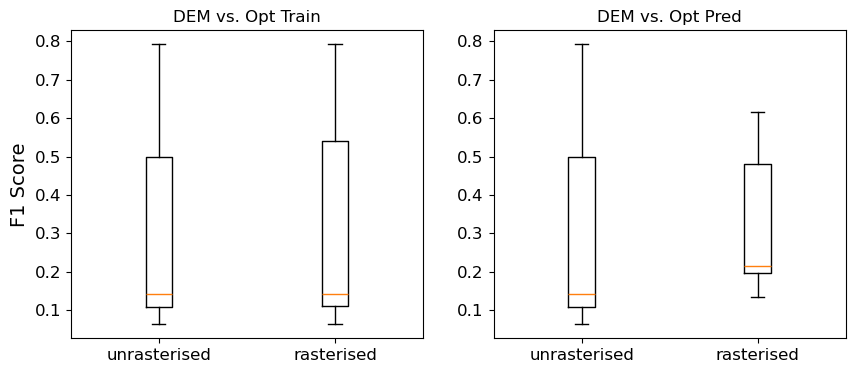

In [84]:
# Boxplot comparing unrasterised with rasterised F1 score

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

# opt_train
ax1.boxplot([F1_score_unraster["opt_train"].dropna(), F1_score_raster["opt_train"].dropna()], labels=["unrasterised", "rasterised"])

# opt_pred
ax2.boxplot([F1_score_unraster["opt_train"].dropna(), F1_score_raster["opt_pred"].dropna()], labels=["unrasterised", "rasterised"])

# Set titles for the subplots
ax1.set_title("DEM vs. Opt Train")
ax2.set_title("DEM vs. Opt Pred")
ax1.set_ylabel('F1 Score')

# Display the boxplot
plt.show()

## Error calculations

In [85]:
# calculate error for rasterised original, buffered and erased dem labels

for region in buffered_erased:
    for kind in buffered_erased[region]["dem_labels"]:
        for year in buffered_erased[region]["dem_labels"][kind]:
            label_df = buffered_erased[region]["dem_labels"][kind][year]
            error_file = merged_diff_errors[region][year]
            label_df["sum_error"] = label_df.apply(lambda row: error_per_polygon(row, error_file), axis=1)
            
    

In [86]:
# Calculates error of rasterised, buffered, eroded optical labels, always the longest possible timestep is used
kinds = ["buffered", "erased", "original"]
for kind in kinds:

    df1 = buffered_erased["peel2"]["opt_train_labels"][kind]["2022"]
    error_file = merged_diff_errors["peel2"]["2013_2021"]
    df1["sum_error"] = df1.apply(lambda row: error_per_polygon(row, error_file), axis=1)

    df1 = buffered_erased["peel2"]["opt_pred_labels"][kind]
    error_file = merged_diff_errors["peel2"]["2013_2021"]
    for year in df1:
        df1[year]["sum_error"] = df1[year].apply(lambda row: error_per_polygon(row, error_file), axis=1)

    df1 = buffered_erased["tuktoyaktuk"]["opt_train_labels"][kind]["2019"]
    error_file = merged_diff_errors["tuktoyaktuk"]["2010_2021"]
    df1["sum_error"] = df1.apply(lambda row: error_per_polygon(row, error_file), axis=1)

    df1 = buffered_erased["tuktoyaktuk"]["opt_pred_labels"][kind]
    error_file = merged_diff_errors["tuktoyaktuk"]["2010_2021"]
    for year in df1:
        df1[year]["sum_error"] = df1[year].apply(lambda row: error_per_polygon(row, error_file), axis=1)

    df1 = buffered_erased["yamal"]["opt_train_labels"][kind]["2022"]
    error_file = merged_diff_errors["yamal"]["2010_2020"]
    df1["sum_error"] = df1.apply(lambda row: error_per_polygon(row, error_file), axis=1)

    df1 = buffered_erased["yamal"]["opt_pred_labels"][kind]
    error_file = merged_diff_errors["yamal"]["2010_2020"]
    for year in df1:
        df1[year]["sum_error"] = df1[year].apply(lambda row: error_per_polygon(row, error_file), axis=1)


In [87]:
# calculates how much % the error and volume change increases or lowers for buffered and erased labels in comparison to the original label

buf_er_merged = {}
for region in buffered_erased:
    region_dict = {}
    for label_groupe in buffered_erased[region]:
        label_groupe_dict = {}
        for year in buffered_erased[region][label_groupe]["original"]:
            df = buffered_erased[region][label_groupe]["original"][year]
            df_er = buffered_erased[region][label_groupe]["erased"][year]
            df_buf = buffered_erased[region][label_groupe]["buffered"][year]
            df = pd.merge(df, pd.merge(df_er, df_buf,on='id', how='inner', suffixes=("_er", "_buf")), on='id', how='inner')
            df["vol_change_er_%"] = ((df["sum_volume_change_er"]/df["sum_volume_change"])-1)*100
            df["vol_change_buf_%"] = ((df["sum_volume_change_buf"]/df["sum_volume_change"])-1)*100
            df["error_er_%"] = (df["sum_error_er"]/df["sum_error"]-1)*100
            df["error_buf_%"] = (df["sum_error_buf"]/df["sum_error"]-1)*100
            label_groupe_dict[year] = df
        region_dict[label_groupe] = label_groupe_dict
    buf_er_merged[region] = region_dict
            

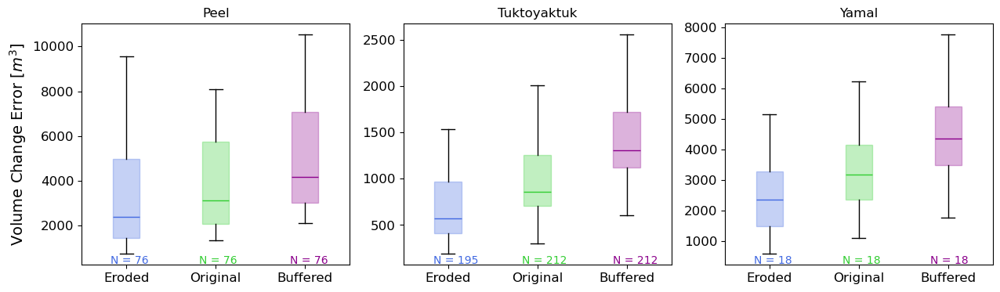

In [88]:
# Boxplot comparing erased, original and buffered error for opt_train data

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

# peel
plot1 = ax1.boxplot([buffered_erased["peel2"]["opt_train_labels"]["erased"]["2022"]["sum_error"].dropna(), buffered_erased["peel2"]["opt_train_labels"]["original"]["2022"]["sum_error"].dropna(), buffered_erased["peel2"]["opt_train_labels"]["buffered"]["2022"]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# tuk
plot2 = ax2.boxplot([buffered_erased["tuktoyaktuk"]["opt_train_labels"]["erased"]["2019"]["sum_error"].dropna(), buffered_erased["tuktoyaktuk"]["opt_train_labels"]["original"]["2019"]["sum_error"].dropna(), buffered_erased["tuktoyaktuk"]["opt_train_labels"]["buffered"]["2019"]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# yamal
plot3 = ax3.boxplot([buffered_erased["yamal"]["opt_train_labels"]["erased"]["2022"]["sum_error"].dropna(), buffered_erased["yamal"]["opt_train_labels"]["original"]["2022"]["sum_error"].dropna(), buffered_erased["yamal"]["opt_train_labels"]["buffered"]["2022"]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

box_colors = ['royalblue',"limegreen", 'darkmagenta', ]
for plot in [plot1, plot2, plot3]:
    for patch, median, whisker, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("Peel")
ax2.set_title("Tuktoyaktuk")
ax3.set_title("Yamal")
ax1.set_ylabel('Volume Change Error [$m^3$]')

number1 = [len(buffered_erased["peel2"]["opt_train_labels"]["erased"]["2022"]["sum_error"].dropna()), len(buffered_erased["peel2"]["opt_train_labels"]["original"]["2022"]["sum_error"].dropna()), len(buffered_erased["peel2"]["opt_train_labels"]["buffered"]["2022"]["sum_error"].dropna())]
number2 = [len(buffered_erased["tuktoyaktuk"]["opt_train_labels"]["erased"]["2019"]["sum_error"].dropna()), len(buffered_erased["tuktoyaktuk"]["opt_train_labels"]["original"]["2019"]["sum_error"].dropna()), len(buffered_erased["tuktoyaktuk"]["opt_train_labels"]["buffered"]["2019"]["sum_error"].dropna())]
number3 = [len(buffered_erased["yamal"]["opt_train_labels"]["erased"]["2022"]["sum_error"].dropna()), len(buffered_erased["yamal"]["opt_train_labels"]["original"]["2022"]["sum_error"].dropna()), len(buffered_erased["yamal"]["opt_train_labels"]["buffered"]["2022"]["sum_error"].dropna())]

# Add text to the upper right corner
ax1.text(0.25, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.58, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[2]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[2], fontsize=10)

ax2.text(0.28, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0], fontsize=10)
ax2.text(0.61, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.95, 0.04, f"N = {number2[2]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[2], fontsize=10)

ax3.text(0.25, 0.04, f"N = {number3[0]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[0], fontsize=10)
ax3.text(0.58, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[1], fontsize=10)
ax3.text(0.91, 0.04, f"N = {number3[2]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[2], fontsize=10)

# Display the boxplot
save_fig(fig, "Volume_change_error_per_RTS_opt_train")
plt.show()

Some pixels are so small that they get deleted if we erase 1 pixel at the boundry. This is the reason why we have less eroded pixels in Tuktoyaktuk than original and buffered.

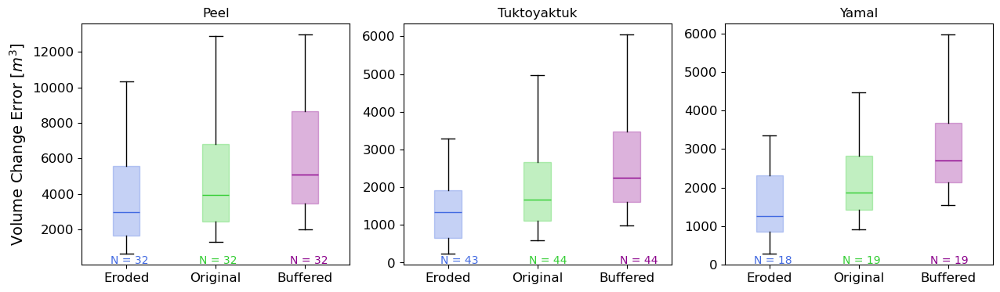

In [89]:
# Boxplot comparing erased, original and buffered error for dem data

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind = "dem_labels"
year_peel = "2013_2021"
year_tuk = "2010_2021"
year_yamal = "2010_2021"
# peel
plot1 = ax1.boxplot([buffered_erased["peel2"][label_kind]["erased"][year_peel]["sum_error"].dropna(), buffered_erased["peel2"][label_kind]["original"][year_peel]["sum_error"].dropna(), buffered_erased["peel2"][label_kind]["buffered"][year_peel]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# tuk
plot2 = ax2.boxplot([buffered_erased["tuktoyaktuk"][label_kind]["erased"][year_tuk]["sum_error"].dropna(), buffered_erased["tuktoyaktuk"][label_kind]["original"][year_tuk]["sum_error"].dropna(), buffered_erased["tuktoyaktuk"][label_kind]["buffered"][year_tuk]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# yamal
plot3 = ax3.boxplot([buffered_erased["yamal"][label_kind]["erased"][year_yamal]["sum_error"].dropna(), buffered_erased["yamal"][label_kind]["original"][year_yamal]["sum_error"].dropna(), buffered_erased["yamal"][label_kind]["buffered"][year_yamal]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

box_colors = ['royalblue',"limegreen", 'darkmagenta', ]
for plot in [plot1, plot2, plot3]:
    for patch, median, whisker, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("Peel")
ax2.set_title("Tuktoyaktuk")
ax3.set_title("Yamal")
ax1.set_ylabel('Volume Change Error [$m^3$]')

number1 = [len(buffered_erased["peel2"][label_kind]["erased"][year_peel]["sum_error"].dropna()), len(buffered_erased["peel2"][label_kind]["original"][year_peel]["sum_error"].dropna()), len(buffered_erased["peel2"][label_kind]["buffered"][year_peel]["sum_error"].dropna())]
number2 = [len(buffered_erased["tuktoyaktuk"][label_kind]["erased"][year_tuk]["sum_error"].dropna()), len(buffered_erased["tuktoyaktuk"][label_kind]["original"][year_tuk]["sum_error"].dropna()), len(buffered_erased["tuktoyaktuk"][label_kind]["buffered"][year_tuk]["sum_error"].dropna())]
number3 = [len(buffered_erased["yamal"][label_kind]["erased"][year_yamal]["sum_error"].dropna()), len(buffered_erased["yamal"][label_kind]["original"][year_yamal]["sum_error"].dropna()), len(buffered_erased["yamal"][label_kind]["buffered"][year_yamal]["sum_error"].dropna())]

# Add text to the upper right corner
ax1.text(0.25, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.58, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[2]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[2], fontsize=10)

ax2.text(0.28, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0], fontsize=10)
ax2.text(0.61, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.95, 0.04, f"N = {number2[2]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[2], fontsize=10)

ax3.text(0.25, 0.04, f"N = {number3[0]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[0], fontsize=10)
ax3.text(0.58, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[1], fontsize=10)
ax3.text(0.91, 0.04, f"N = {number3[2]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[2], fontsize=10)

# Display the boxplot
save_fig(fig, "Volume_change_error_per_RTS_dem")
plt.show()

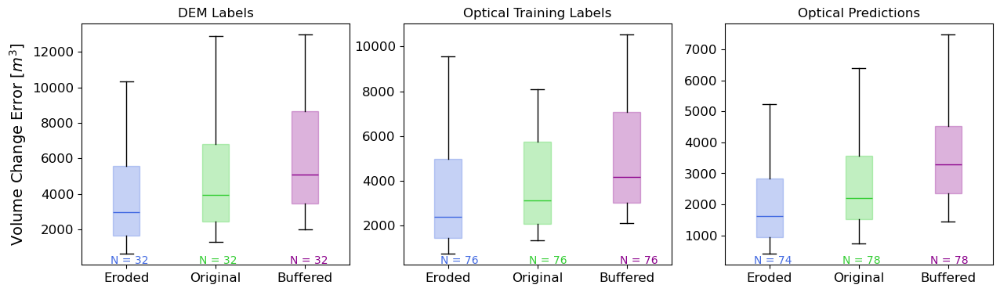

In [90]:
# Boxplot comparing erased, original and buffered error for the different label kinds in Peel
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind1 = "dem_labels"
label_kind2 = "opt_train_labels"
label_kind3 = "opt_pred_labels"
year_1 = "2013_2021"
year_2 = "2022"
year_3 = "2022"
region = "peel2"
# DEM
plot1 = ax1.boxplot([buffered_erased[region][label_kind1]["erased"][year_1]["sum_error"].dropna(), buffered_erased[region][label_kind1]["original"][year_1]["sum_error"].dropna(), buffered_erased[region][label_kind1]["buffered"][year_1]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# opt train
plot2 = ax2.boxplot([buffered_erased[region][label_kind2]["erased"][year_2]["sum_error"].dropna(), buffered_erased[region][label_kind2]["original"][year_2]["sum_error"].dropna(), buffered_erased[region][label_kind2]["buffered"][year_2]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# opt pred
plot3 = ax3.boxplot([buffered_erased[region][label_kind3]["erased"][year_3]["sum_error"].dropna(), buffered_erased[region][label_kind3]["original"][year_3]["sum_error"].dropna(), buffered_erased[region][label_kind3]["buffered"][year_3]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

box_colors = ['royalblue',"limegreen", 'darkmagenta', ]
for plot in [plot1, plot2, plot3]:
    for patch, median, whisker, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("DEM Labels")
ax2.set_title("Optical Training Labels")
ax3.set_title("Optical Predictions")
ax1.set_ylabel('Volume Change Error [$m^3$]')

number1 = [len(buffered_erased[region][label_kind1]["erased"][year_1]["sum_error"].dropna()), len(buffered_erased[region][label_kind1]["original"][year_1]["sum_error"].dropna()), len(buffered_erased[region][label_kind1]["buffered"][year_1]["sum_error"].dropna())]
number2 = [len(buffered_erased[region][label_kind2]["erased"][year_2]["sum_error"].dropna()), len(buffered_erased[region][label_kind2]["original"][year_2]["sum_error"].dropna()), len(buffered_erased[region][label_kind2]["buffered"][year_2]["sum_error"].dropna())]
number3 = [len(buffered_erased[region][label_kind3]["erased"][year_3]["sum_error"].dropna()), len(buffered_erased[region][label_kind3]["original"][year_3]["sum_error"].dropna()), len(buffered_erased[region][label_kind3]["buffered"][year_3]["sum_error"].dropna())]

# Add text to the upper right corner
ax1.text(0.25, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.58, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[2]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[2], fontsize=10)

ax2.text(0.28, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0], fontsize=10)
ax2.text(0.61, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.95, 0.04, f"N = {number2[2]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[2], fontsize=10)

ax3.text(0.25, 0.04, f"N = {number3[0]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[0], fontsize=10)
ax3.text(0.58, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[1], fontsize=10)
ax3.text(0.91, 0.04, f"N = {number3[2]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[2], fontsize=10)

# Display the boxplot
save_fig(fig, "Volume_change_error_per_RTS_comparison_labels_Peel")
plt.show()

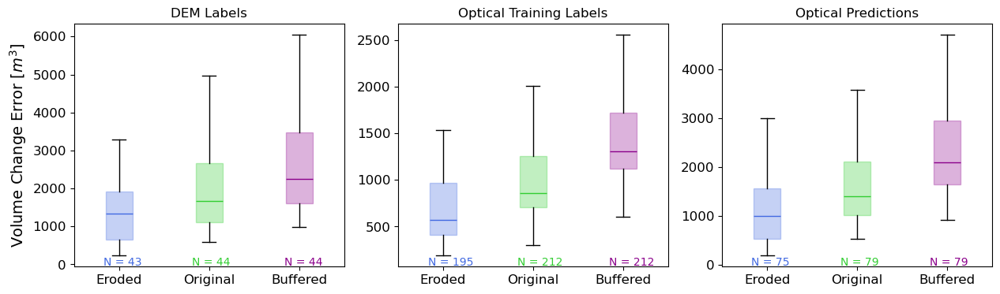

In [91]:
# Boxplot comparing erased, original and buffered error for the different label kinds tuk
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind1 = "dem_labels"
label_kind2 = "opt_train_labels"
label_kind3 = "opt_pred_labels"
year_1 = "2010_2021"
year_2 = "2019"
year_3 = "2019"
region = "tuktoyaktuk"
# DEM
plot1 = ax1.boxplot([buffered_erased[region][label_kind1]["erased"][year_1]["sum_error"].dropna(), buffered_erased[region][label_kind1]["original"][year_1]["sum_error"].dropna(), buffered_erased[region][label_kind1]["buffered"][year_1]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# opt train
plot2 = ax2.boxplot([buffered_erased[region][label_kind2]["erased"][year_2]["sum_error"].dropna(), buffered_erased[region][label_kind2]["original"][year_2]["sum_error"].dropna(), buffered_erased[region][label_kind2]["buffered"][year_2]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# opt pred
plot3 = ax3.boxplot([buffered_erased[region][label_kind3]["erased"][year_3]["sum_error"].dropna(), buffered_erased[region][label_kind3]["original"][year_3]["sum_error"].dropna(), buffered_erased[region][label_kind3]["buffered"][year_3]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

box_colors = ['royalblue',"limegreen", 'darkmagenta', ]
for plot in [plot1, plot2, plot3]:
    for patch, median, whisker, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("DEM Labels")
ax2.set_title("Optical Training Labels")
ax3.set_title("Optical Predictions")
ax1.set_ylabel('Volume Change Error [$m^3$]')

number1 = [len(buffered_erased[region][label_kind1]["erased"][year_1]["sum_error"].dropna()), len(buffered_erased[region][label_kind1]["original"][year_1]["sum_error"].dropna()), len(buffered_erased[region][label_kind1]["buffered"][year_1]["sum_error"].dropna())]
number2 = [len(buffered_erased[region][label_kind2]["erased"][year_2]["sum_error"].dropna()), len(buffered_erased[region][label_kind2]["original"][year_2]["sum_error"].dropna()), len(buffered_erased[region][label_kind2]["buffered"][year_2]["sum_error"].dropna())]
number3 = [len(buffered_erased[region][label_kind3]["erased"][year_3]["sum_error"].dropna()), len(buffered_erased[region][label_kind3]["original"][year_3]["sum_error"].dropna()), len(buffered_erased[region][label_kind3]["buffered"][year_3]["sum_error"].dropna())]

# Add text to the upper right corner
ax1.text(0.25, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.58, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[2]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[2], fontsize=10)

ax2.text(0.28, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0], fontsize=10)
ax2.text(0.61, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.95, 0.04, f"N = {number2[2]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[2], fontsize=10)

ax3.text(0.25, 0.04, f"N = {number3[0]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[0], fontsize=10)
ax3.text(0.58, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[1], fontsize=10)
ax3.text(0.91, 0.04, f"N = {number3[2]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[2], fontsize=10)

# Display the boxplot
save_fig(fig, "Volume_change_error_per_RTS_comparison_labels_tuk")
plt.show()

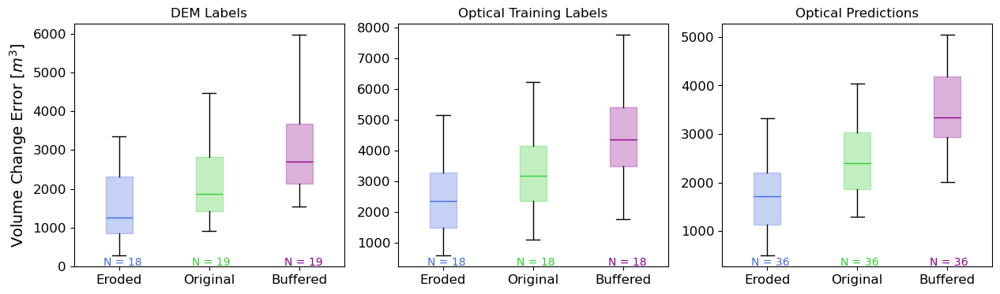

In [92]:
# Boxplot comparing erased, original and buffered error for the different label kinds yamal
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind1 = "dem_labels"
label_kind2 = "opt_train_labels"
label_kind3 = "opt_pred_labels"
year_1 = "2010_2021"
year_2 = "2022"
year_3 = "2022"
region = "yamal"
# DEM
plot1 = ax1.boxplot([buffered_erased[region][label_kind1]["erased"][year_1]["sum_error"].dropna(), buffered_erased[region][label_kind1]["original"][year_1]["sum_error"].dropna(), buffered_erased[region][label_kind1]["buffered"][year_1]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# opt train
plot2 = ax2.boxplot([buffered_erased[region][label_kind2]["erased"][year_2]["sum_error"].dropna(), buffered_erased[region][label_kind2]["original"][year_2]["sum_error"].dropna(), buffered_erased[region][label_kind2]["buffered"][year_2]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# opt pred
plot3 = ax3.boxplot([buffered_erased[region][label_kind3]["erased"][year_3]["sum_error"].dropna(), buffered_erased[region][label_kind3]["original"][year_3]["sum_error"].dropna(), buffered_erased[region][label_kind3]["buffered"][year_3]["sum_error"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

box_colors = ['royalblue',"limegreen", 'darkmagenta', ]
for plot in [plot1, plot2, plot3]:
    for patch, median, whisker, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("DEM Labels")
ax2.set_title("Optical Training Labels")
ax3.set_title("Optical Predictions")
ax1.set_ylabel('Volume Change Error [$m^3$]')

number1 = [len(buffered_erased[region][label_kind1]["erased"][year_1]["sum_error"].dropna()), len(buffered_erased[region][label_kind1]["original"][year_1]["sum_error"].dropna()), len(buffered_erased[region][label_kind1]["buffered"][year_1]["sum_error"].dropna())]
number2 = [len(buffered_erased[region][label_kind2]["erased"][year_2]["sum_error"].dropna()), len(buffered_erased[region][label_kind2]["original"][year_2]["sum_error"].dropna()), len(buffered_erased[region][label_kind2]["buffered"][year_2]["sum_error"].dropna())]
number3 = [len(buffered_erased[region][label_kind3]["erased"][year_3]["sum_error"].dropna()), len(buffered_erased[region][label_kind3]["original"][year_3]["sum_error"].dropna()), len(buffered_erased[region][label_kind3]["buffered"][year_3]["sum_error"].dropna())]

# Add text to the upper right corner
ax1.text(0.25, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.58, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[2]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[2], fontsize=10)

ax2.text(0.25, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0], fontsize=10)
ax2.text(0.58, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.92, 0.04, f"N = {number2[2]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[2], fontsize=10)

ax3.text(0.25, 0.04, f"N = {number3[0]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[0], fontsize=10)
ax3.text(0.58, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[1], fontsize=10)
ax3.text(0.91, 0.04, f"N = {number3[2]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[2], fontsize=10)

# Display the boxplot
save_fig(fig, "Volume_change_error_per_RTS_comparison_labels_yamal")
plt.show()

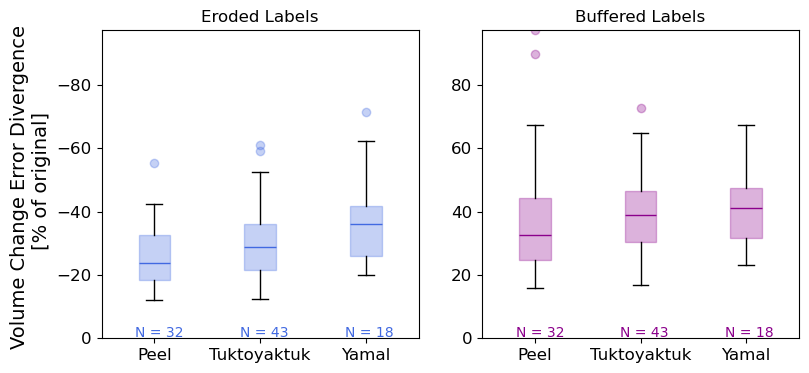

In [93]:
# Boxplot comparing Volume Change error in % of original for buffered and erased dem labels for all regions
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind = "dem_labels"
year_peel = "2013_2021"
year_tuk = "2010_2021"
year_yamal = "2010_2021"

peel_er = buf_er_merged["peel2"][label_kind][year_peel]["error_er_%"].dropna()
tuk_er = buf_er_merged["tuktoyaktuk"][label_kind][year_tuk]["error_er_%"].dropna()
yamal_er = buf_er_merged["yamal"][label_kind][year_yamal]["error_er_%"].dropna()
peel_buf = buf_er_merged["peel2"][label_kind][year_peel]["error_buf_%"].dropna()
tuk_buf = buf_er_merged["tuktoyaktuk"][label_kind][year_tuk]["error_buf_%"].dropna()
yamal_buf = buf_er_merged["yamal"][label_kind][year_yamal]["error_buf_%"].dropna()
# % erased
plot1 = ax1.boxplot([peel_er, tuk_er, yamal_er ], labels=["Peel", "Tuktoyaktuk", "Yamal"], showfliers=True, patch_artist=True)

# % buffered
plot2 = ax2.boxplot([peel_buf, tuk_buf, yamal_buf], labels=["Peel", "Tuktoyaktuk", "Yamal"], showfliers=True, patch_artist=True)

box_colors = ['royalblue', 'darkmagenta', ]
for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, whisker, flier in zip(plot['boxes'], plot["medians"], plot["whiskers"], plot["fliers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)
        
# Set titles for the subplots
ax1.set_title("Eroded Labels")
ax2.set_title("Buffered Labels")
ax1.set_ylabel('Volume Change Error Divergence \n [% of original]')

number1 = [len(peel_er), len(tuk_er), len(yamal_er)]
number2 = [len(peel_buf), len(tuk_buf), len(yamal_buf)]

# Add text to the upper right corner
ax1.text(0.26, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.59, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[2]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)

ax2.text(0.26, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.59, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.92, 0.04, f"N = {number2[2]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)

max_limit = max(-peel_er.min(), -tuk_er.min(), -yamal_er.min(), peel_buf.max(), tuk_buf.max(), yamal_buf.max())
ax1.set_ylim(-max_limit, 0)
ax2.set_ylim(0, max_limit)

ax1.invert_yaxis()


# Display the boxplot
save_fig(fig, f"Volume_change_error_{label_kind}_percentage")
plt.show()

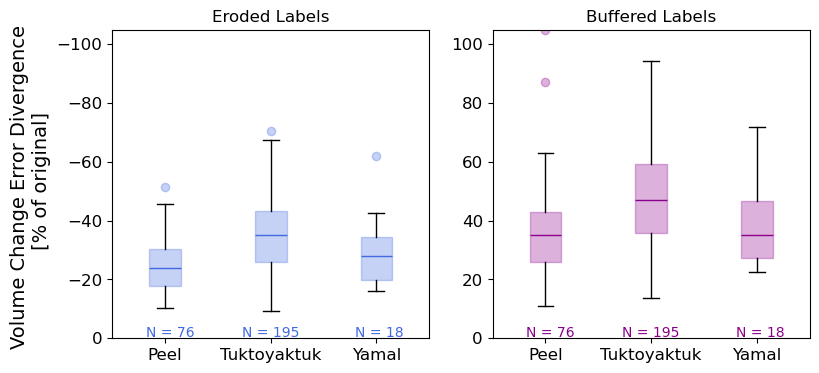

In [94]:
# Boxplot comparing Volume Change error in % of original for buffered and erased optical training labels for all regions
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind = "opt_train_labels"
year_peel = "2022"
year_tuk = "2019"
year_yamal = "2022"

peel_er = buf_er_merged["peel2"][label_kind][year_peel]["error_er_%"].dropna()
tuk_er = buf_er_merged["tuktoyaktuk"][label_kind][year_tuk]["error_er_%"].dropna()
yamal_er = buf_er_merged["yamal"][label_kind][year_yamal]["error_er_%"].dropna()
peel_buf = buf_er_merged["peel2"][label_kind][year_peel]["error_buf_%"].dropna()
tuk_buf = buf_er_merged["tuktoyaktuk"][label_kind][year_tuk]["error_buf_%"].dropna()
yamal_buf = buf_er_merged["yamal"][label_kind][year_yamal]["error_buf_%"].dropna()
# % erased
plot1 = ax1.boxplot([peel_er, tuk_er, yamal_er ], labels=["Peel", "Tuktoyaktuk", "Yamal"], showfliers=True, patch_artist=True)

# % buffered
plot2 = ax2.boxplot([peel_buf, tuk_buf, yamal_buf], labels=["Peel", "Tuktoyaktuk", "Yamal"], showfliers=True, patch_artist=True)

box_colors = ['royalblue', 'darkmagenta', ]
for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, whisker, flier in zip(plot['boxes'], plot["medians"], plot["whiskers"], plot["fliers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)
        
# Set titles for the subplots
ax1.set_title("Eroded Labels")
ax2.set_title("Buffered Labels")
ax1.set_ylabel('Volume Change Error Divergence \n [% of original]')

number1 = [len(peel_er), len(tuk_er), len(yamal_er)]
number2 = [len(peel_buf), len(tuk_buf), len(yamal_buf)]

# Add text to the upper right corner
ax1.text(0.26, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.59, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[2]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)

ax2.text(0.26, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.59, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.92, 0.04, f"N = {number2[2]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)

max_limit = max(-peel_er.min(), -tuk_er.min(), -yamal_er.min(), peel_buf.max(), tuk_buf.max(), yamal_buf.max())
ax1.set_ylim(-max_limit, 0)
ax2.set_ylim(0, max_limit)

ax1.invert_yaxis()


# Display the boxplot
save_fig(fig, f"Volume_change_error_{label_kind}_percentage")
plt.show()

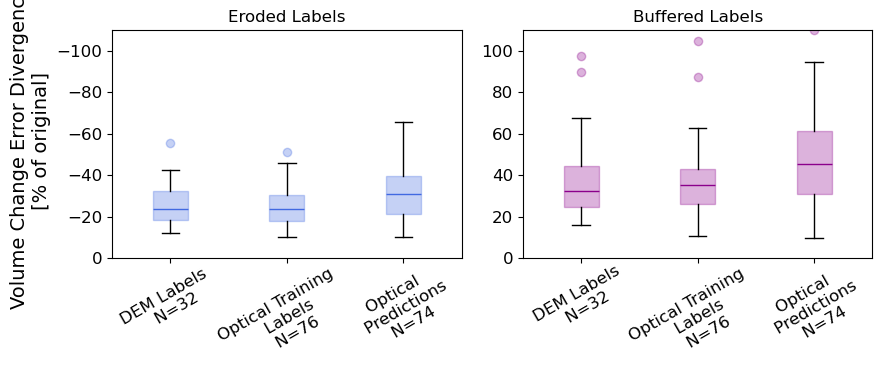

In [95]:
# Boxplot comparing Volume Change error in % of original for buffered and erased for the different label kinds
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind1 = "dem_labels"
label_kind2 = "opt_train_labels"
label_kind3 = "opt_pred_labels"
year_1 = "2013_2021"
year_2 = "2022"
year_3 = "2022"
region = "peel2"

dem_er = buf_er_merged[region][label_kind1][year_1]["error_er_%"].dropna()
train_er = buf_er_merged[region][label_kind2][year_2]["error_er_%"].dropna()
pred_er = buf_er_merged[region][label_kind3][year_3]["error_er_%"].dropna()
dem_buf = buf_er_merged[region][label_kind1][year_1]["error_buf_%"].dropna()
train_buf = buf_er_merged[region][label_kind2][year_2]["error_buf_%"].dropna()
pred_buf = buf_er_merged[region][label_kind3][year_3]["error_buf_%"].dropna()

number1 = [len(dem_er), len(train_er), len(pred_er)]
number2 = [len(dem_buf), len(train_buf), len(pred_buf)]

# % erased
plot1 = ax1.boxplot([dem_er, train_er, pred_er ], labels=[f"DEM Labels \n N={number1[0]}", f"Optical Training \n Labels\n N={number1[1]}", f"Optical \n Predictions\n N={number1[2]}"], showfliers=True, patch_artist=True)

# % buffered
plot2 = ax2.boxplot([dem_buf, train_buf, pred_buf], labels=[f"DEM Labels\n N={number2[0]}", f"Optical Training \n Labels\n N={number2[1]}", f"Optical \n Predictions\n N={number2[2]}"], showfliers=True, patch_artist=True)

box_colors = ['royalblue', 'darkmagenta', ]
for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, whisker, flier in zip(plot['boxes'], plot["medians"], plot["whiskers"], plot["fliers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        flier.set(markeredgecolor=color, markerfacecolor=color, alpha = 0.3)
        
# Set titles for the subplots
ax1.set_title("Eroded Labels")
ax2.set_title("Buffered Labels")
ax1.set_ylabel('Volume Change Error Divergence \n [% of original]')

max_limit = max(-dem_er.min(), -train_er.min(), -pred_er.min(), dem_buf.max(), train_buf.max(), pred_buf.max())
ax1.set_ylim(-max_limit, 0)
ax2.set_ylim(0, max_limit)

ax1.invert_yaxis()
ax1.tick_params(axis='x', rotation=30, pad = 0)
ax2.tick_params(axis='x', rotation=30, pad = 0)

plt.tight_layout()
# Display the boxplot
save_fig(fig, "Volume_change_error_comparison_label_kinds_percentage")
plt.show()

Volume change error per label, grows with label size

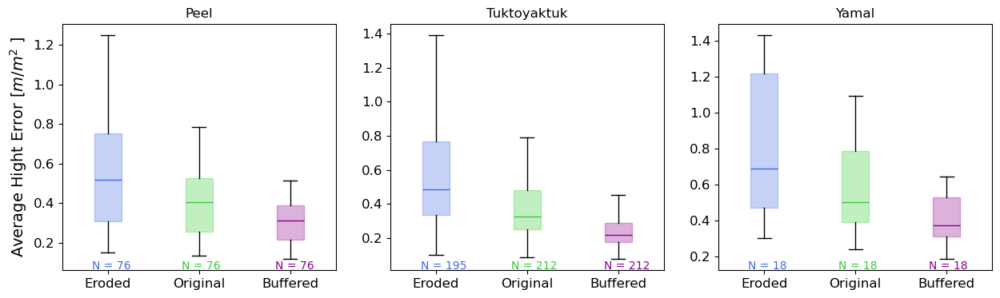

In [96]:
# Boxplot comparing erased, original and buffered error over area for opt_train data

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

# peel
error_per_area_peel_erased = buffered_erased["peel2"]["opt_train_labels"]["erased"]["2022"]["sum_error"]/buffered_erased["peel2"]["opt_train_labels"]["erased"]["2022"]["area"]
error_per_area_peel_original = buffered_erased["peel2"]["opt_train_labels"]["original"]["2022"]["sum_error"]/buffered_erased["peel2"]["opt_train_labels"]["original"]["2022"]["area"]
error_per_area_peel_buffered = buffered_erased["peel2"]["opt_train_labels"]["buffered"]["2022"]["sum_error"]/buffered_erased["peel2"]["opt_train_labels"]["buffered"]["2022"]["area"]

plot1 = ax1.boxplot([error_per_area_peel_erased.dropna(), error_per_area_peel_original.dropna(), error_per_area_peel_buffered.dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# tuk
error_per_area_tuk_erased = buffered_erased["tuktoyaktuk"]["opt_train_labels"]["erased"]["2019"]["sum_error"]/buffered_erased["tuktoyaktuk"]["opt_train_labels"]["erased"]["2019"]["area"]
error_per_area_tuk_original = buffered_erased["tuktoyaktuk"]["opt_train_labels"]["original"]["2019"]["sum_error"]/buffered_erased["tuktoyaktuk"]["opt_train_labels"]["original"]["2019"]["area"]
error_per_area_tuk_buffered = buffered_erased["tuktoyaktuk"]["opt_train_labels"]["buffered"]["2019"]["sum_error"]/buffered_erased["tuktoyaktuk"]["opt_train_labels"]["buffered"]["2019"]["area"]

plot2 = ax2.boxplot([error_per_area_tuk_erased.dropna(), error_per_area_tuk_original.dropna(), error_per_area_tuk_buffered.dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# yamal
error_per_area_yamal_erased = buffered_erased["yamal"]["opt_train_labels"]["erased"]["2022"]["sum_error"]/buffered_erased["yamal"]["opt_train_labels"]["erased"]["2022"]["area"]
error_per_area_yamal_original = buffered_erased["yamal"]["opt_train_labels"]["original"]["2022"]["sum_error"]/buffered_erased["yamal"]["opt_train_labels"]["original"]["2022"]["area"]
error_per_area_yamal_buffered = buffered_erased["yamal"]["opt_train_labels"]["buffered"]["2022"]["sum_error"]/buffered_erased["yamal"]["opt_train_labels"]["buffered"]["2022"]["area"]

plot3 = ax3.boxplot([error_per_area_yamal_erased.dropna(), error_per_area_yamal_original.dropna(), error_per_area_yamal_buffered.dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

box_colors = ['royalblue',"limegreen", 'darkmagenta', ]
for plot in [plot1, plot2, plot3]:
    for patch, median, whisker, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)

# Set titles for the subplots
ax1.set_title("Peel")
ax2.set_title("Tuktoyaktuk")
ax3.set_title("Yamal")
ax1.set_ylabel('Average Hight Error [$m/m^2$ ]')

number1 = [len(error_per_area_peel_erased.dropna()), len(error_per_area_peel_original.dropna()), len(error_per_area_peel_buffered.dropna())]
number2 = [len(error_per_area_tuk_erased.dropna()), len(error_per_area_tuk_original.dropna()), len(error_per_area_tuk_buffered.dropna())]
number3 = [len(error_per_area_yamal_erased.dropna()), len(error_per_area_yamal_original.dropna()), len(error_per_area_yamal_buffered.dropna())]

# Add text to the upper right corner
ax1.text(0.25, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.58, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[2]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[2], fontsize=10)

ax2.text(0.28, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0], fontsize=10)
ax2.text(0.61, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.95, 0.04, f"N = {number2[2]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[2], fontsize=10)

ax3.text(0.25, 0.04, f"N = {number3[0]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[0], fontsize=10)
ax3.text(0.58, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[1], fontsize=10)
ax3.text(0.91, 0.04, f"N = {number3[2]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[2], fontsize=10)

# Display the boxplot
save_fig(fig, "Average_hight_error_per_squaremeter_opt_train")
plt.show()

height error per label, decreases with label size

## Plots comparing standart metrics of dem labels with optical labels

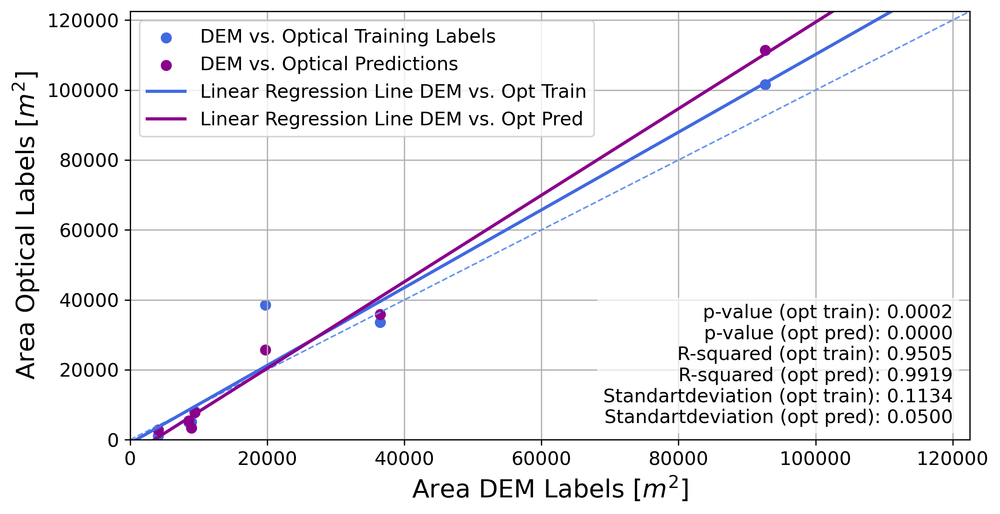

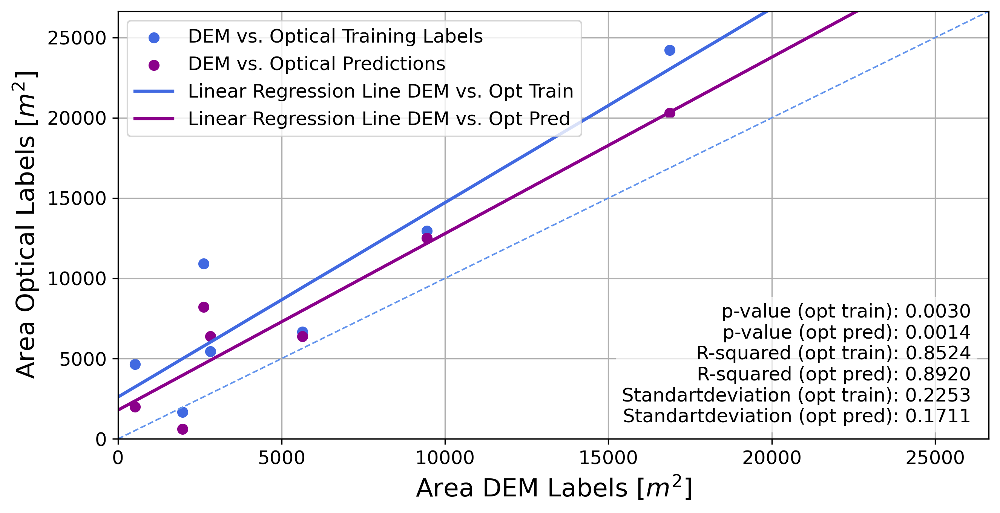

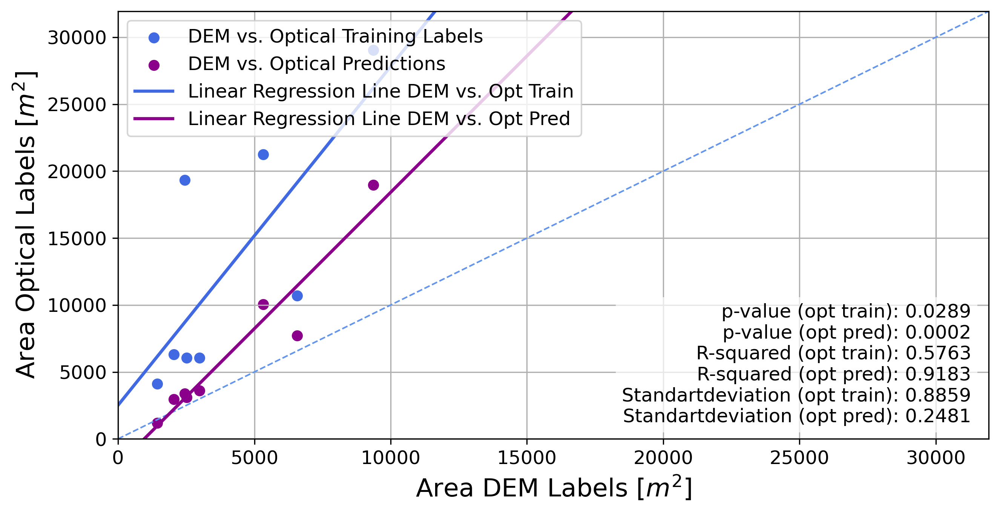

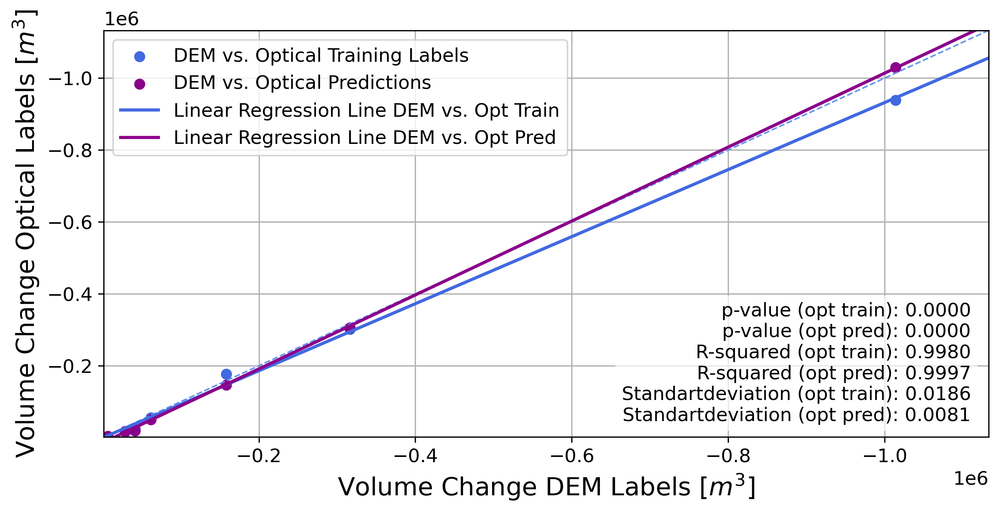

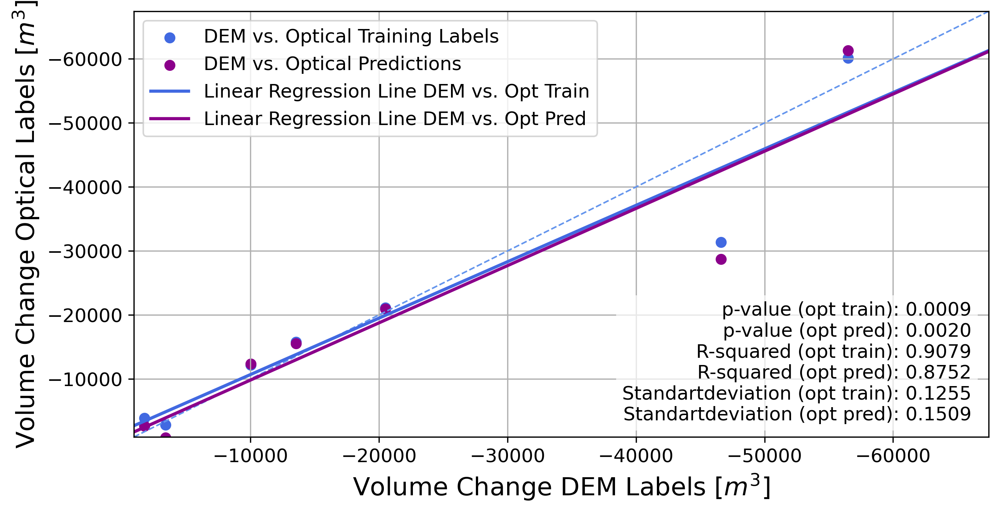

...

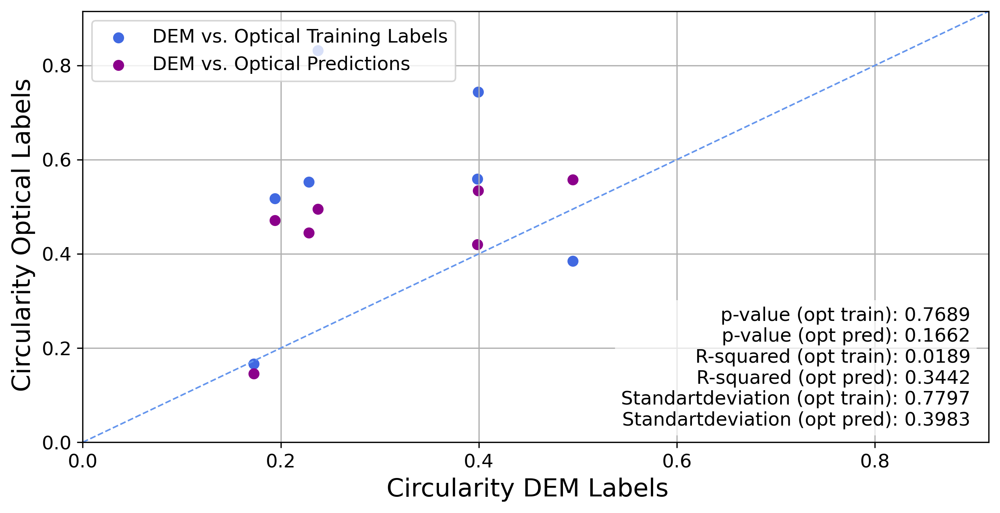

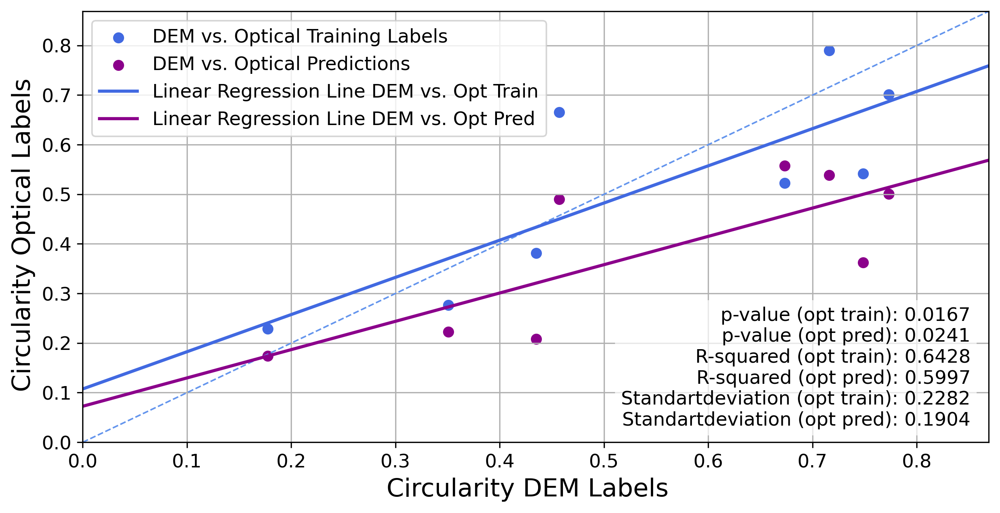

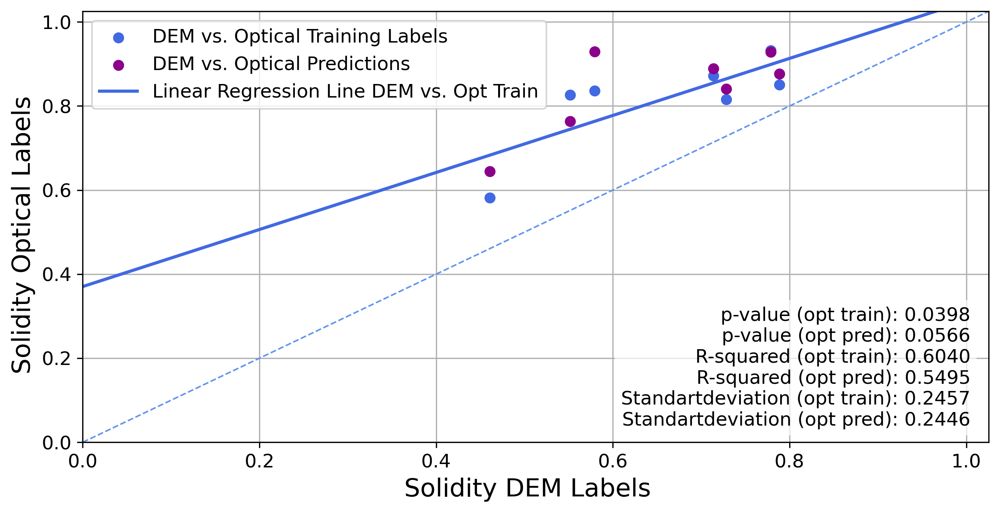

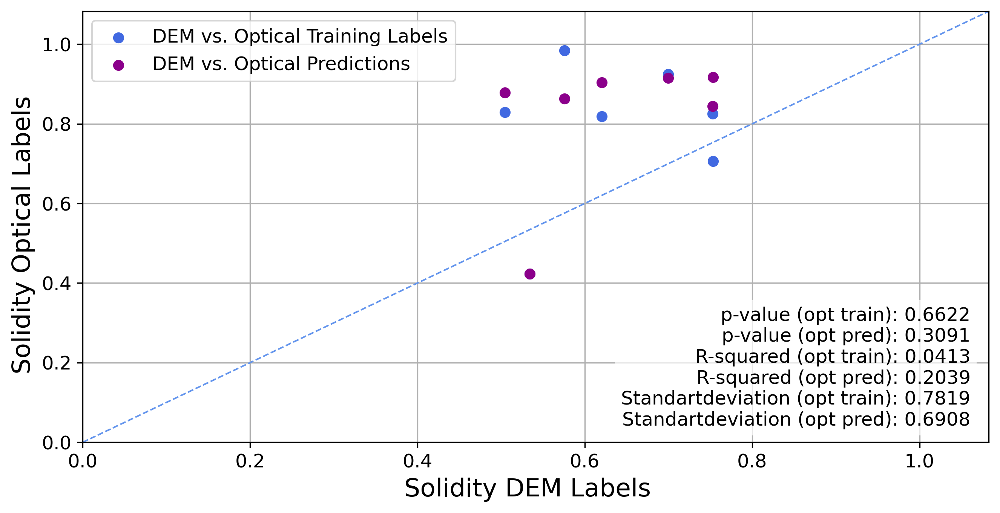

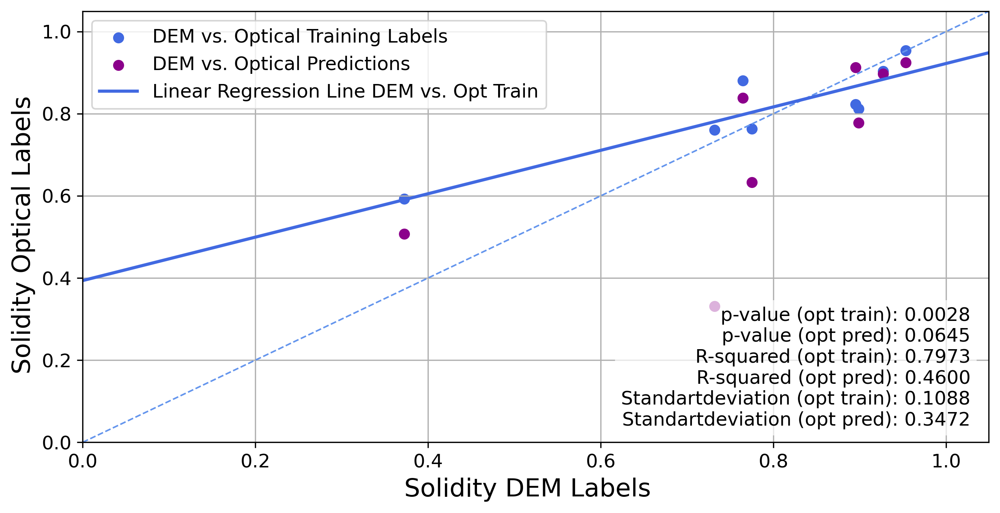

In [97]:
# compare attributes from dem_labels and optical labels for different regions 

data_dem_2011_2021 = labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2011_2021"]
data_dem_2013_2021 = labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2013_2021"]
opt_train_data = labels_of_year_data["peel2"]["opt_train_labels"]["unrasterised"]["2022"]
opt_pred_data = labels_of_year_data["peel2"]["opt_pred_labels"]["unrasterised"]["2022"]
opt_pred_data = opt_pred_data[opt_pred_data["identifier"].notna()]

merged_labels_2011_2021 = pd.merge(data_dem_2011_2021, pd.merge(opt_train_data, opt_pred_data,on='identifier', how='inner', suffixes=("_train", "_pred")), on='identifier', how='inner')
merged_labels_2011_2021 = merged_labels_2011_2021[merged_labels_2011_2021["identifier"].notna()]
merged_labels_2013_2021 = pd.merge(data_dem_2013_2021, pd.merge(opt_train_data, opt_pred_data,on='identifier', how='inner', suffixes=("_train", "_pred")), on='identifier', how='inner')
merged_labels_2013_2021 = merged_labels_2013_2021[merged_labels_2013_2021["identifier"].notna()]

# dem vs. opt in yamal

dem_2010_2021_yamal = labels_of_year_data["yamal"]["dem_labels"]["unrasterised"]["2010_2021"]
opt_train_yamal = labels_of_year_data["yamal"]["opt_train_labels"]["unrasterised"]["2022"]
opt_pred_yamal = labels_of_year_data["yamal"]["opt_pred_labels"]["unrasterised"]["2022"]
opt_pred_yamal = opt_pred_yamal[opt_pred_yamal["identifier"].notna()]

merged_labels_2010_2021_yamal = pd.merge(dem_2010_2021_yamal, pd.merge(opt_train_yamal, opt_pred_yamal,on='identifier', how='inner', suffixes=("_train", "_pred")), on='identifier', how='inner')
merged_labels_2010_2021_yamal = merged_labels_2010_2021_yamal[merged_labels_2010_2021_yamal["identifier"].notna()]

# dem vs. opt in tuktoyaktuk

dem_2010_2021_tuk = labels_of_year_data["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2021"]
opt_train_tuk = labels_of_year_data["tuktoyaktuk"]["opt_train_labels"]["unrasterised"]["2019"]
opt_pred_tuk = labels_of_year_data["tuktoyaktuk"]["opt_pred_labels"]["unrasterised"]["2019"]
opt_pred_tuk = opt_pred_tuk[opt_pred_tuk["identifier"].notna()]

merged_labels_2010_2021_tuk = pd.merge(dem_2010_2021_tuk, pd.merge(opt_train_tuk, opt_pred_tuk,on='identifier', how='inner', suffixes=("_train", "_pred")), on='identifier', how='inner')
merged_labels_2010_2021_tuk = merged_labels_2010_2021_tuk[merged_labels_2010_2021_tuk["identifier"].notna()]

new_columns=["identifier", 'Area DEM', 'Area opt_train', "Area opt_pred", 'Circularity DEM', 'Circularity opt_train', 'Circularity opt_pred', "Solidity DEM", "Solidity opt_train", "Solidity opt_pred", "volume avg DEM", "volume avg opt_train", "volume avg opt_pred", "Volume Change DEM", "Volume Change opt_train", "Volume Change opt_pred"]
columns = ["identifier", "area", "area_train", "area_pred","circularity", "circularity_train", "circularity_pred","solidity", "solidity_train", "solidity_pred", "avg_volume_change", "avg_volume_change_train", "avg_volume_change_pred", "sum_volume_change", "sum_volume_change_train", "sum_volume_change_pred"]
dem_2011_2021_opt_2022 = merged_labels_2011_2021[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2013_2021_opt_2022 = merged_labels_2013_2021[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2010_2021_opt_2022_yamal = merged_labels_2010_2021_yamal[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2010_2021_opt_2019_tuk = merged_labels_2010_2021_tuk[columns].copy().rename(columns=dict(zip(columns, new_columns)))


# plot graphs for the different attributes
attributes = [("Area", "[$m^2$]"), ("Volume Change", "[$m^3$]"), ("Circularity", " "), ("Solidity", " ")]
for attribute, unit in attributes:
    fig_dem_vs_opt_with_linregress(np.array(dem_2013_2021_opt_2022[f"{attribute} DEM"]), np.array(dem_2013_2021_opt_2022[f"{attribute} opt_train"]), np.array(dem_2013_2021_opt_2022[f"{attribute} opt_pred"]),"Peel 2 Unrasterised", attribute, unit)
    fig_dem_vs_opt_with_linregress(np.array(dem_2010_2021_opt_2022_yamal[f"{attribute} DEM"]), np.array(dem_2010_2021_opt_2022_yamal[f"{attribute} opt_train"]), np.array(dem_2010_2021_opt_2022_yamal[f"{attribute} opt_pred"]),"Yamal Unrasterised", attribute, unit)
    fig_dem_vs_opt_with_linregress(np.array(dem_2010_2021_opt_2019_tuk[f"{attribute} DEM"]), np.array(dem_2010_2021_opt_2019_tuk[f"{attribute} opt_train"]), np.array(dem_2010_2021_opt_2019_tuk[f"{attribute} opt_pred"]),"Tuktoyaktuk Unrasterised", attribute, unit)

In [98]:
# compare Kathrin's labels with mine
labels_kathrin = data_others["tuktoyaktuk"][data_others["tuktoyaktuk"]["year_end"] == "2021"]
labels_kathrin = labels_kathrin.dissolve(by='identifier', aggfunc='sum')
labels_kathrin["area"] = labels_kathrin["geometry"].area
labels_me = labels_of_year_data_me["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2021"]
labels_me["area"] = labels_me["geometry"].area

comp_labels = pd.merge(labels_kathrin, labels_me, on='identifier', how='inner', suffixes=("_kathrin", "_me"))

display(comp_labels)
# display(labels_of_year_data["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2021"])
# display(labels_kathrin)


,identifier,geometry_kathrin,year_start_kathrin,year_end_kathrin,type,area_kathrin,geometry_me,year_start_me,year_end_me,area_me,circularity,solidity
0,tuk_1,"MULTIPOLYGON (((-2287035.292 -43864.749, -2287...",201020102010,202120212021,lakeshorelakeshorelakeshore,3299.852859,"MULTIPOLYGON (((-2287031.099 -43863.616, -2287...",2010,2021,5330.711515,0.177355,0.372382
1,tuk_2,"MULTIPOLYGON (((-2285146.751 -48241.094, -2285...",20102010,20212021,lakeshorelakeshore,10741.862203,"POLYGON ((-2285184.636 -48276.040, -2285174.28...",2010,2021,9363.677555,0.350539,0.774971
2,tuk_3,"POLYGON ((-2280985.256 -45724.652, -2280983.31...",2010,2021,lakeshore,5146.326212,"POLYGON ((-2280976.091 -45695.453, -2280944.78...",2010,2021,6575.991019,0.457044,0.764364


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\3138461487.py:9: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  diagonal_values = np.arange(min_value, max_value + step_size, step_size).tolist()


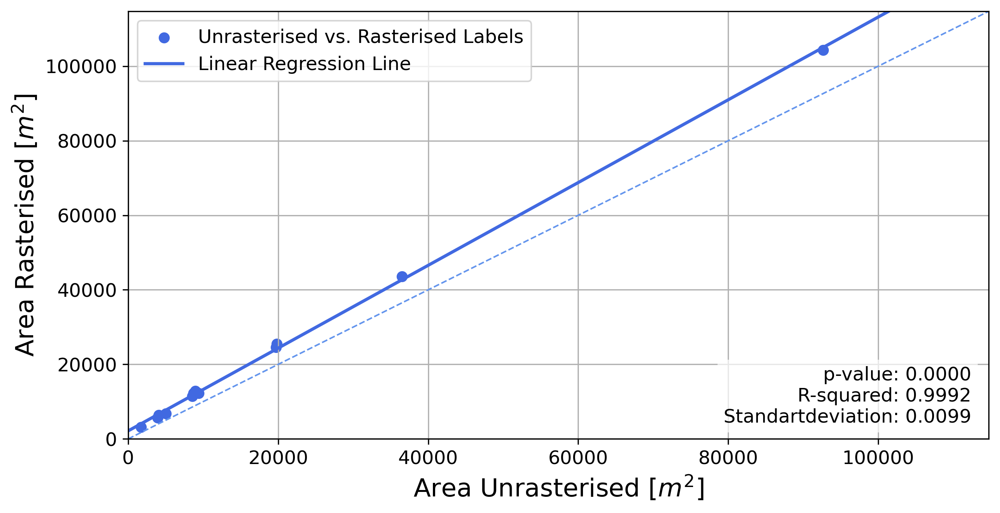

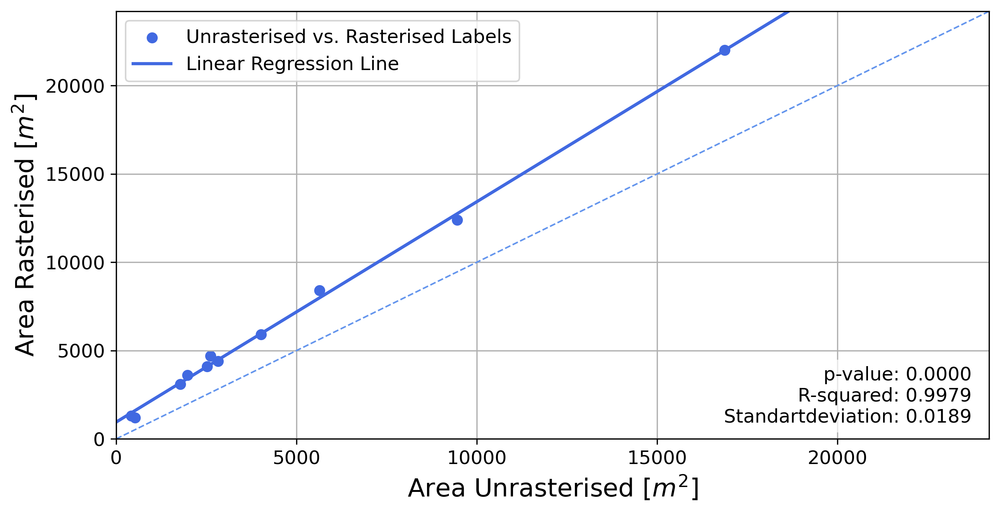

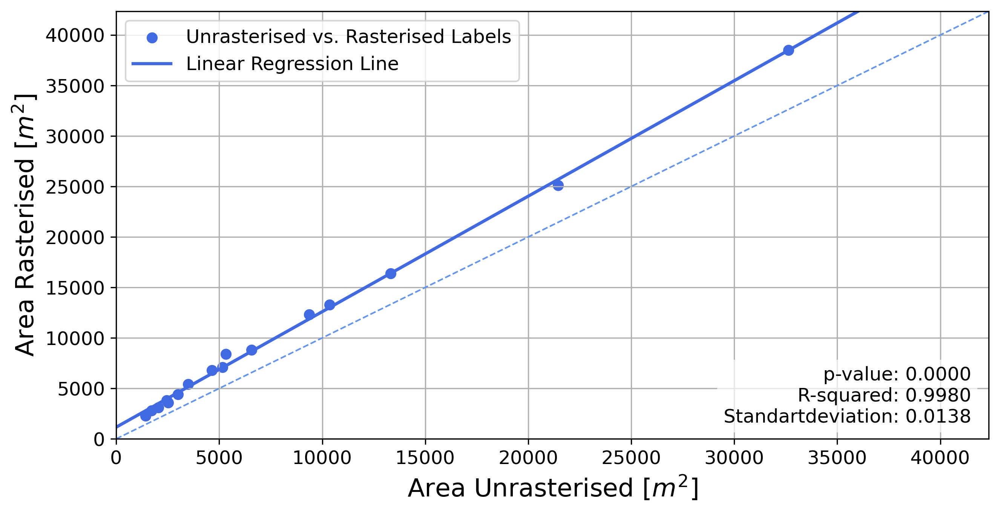

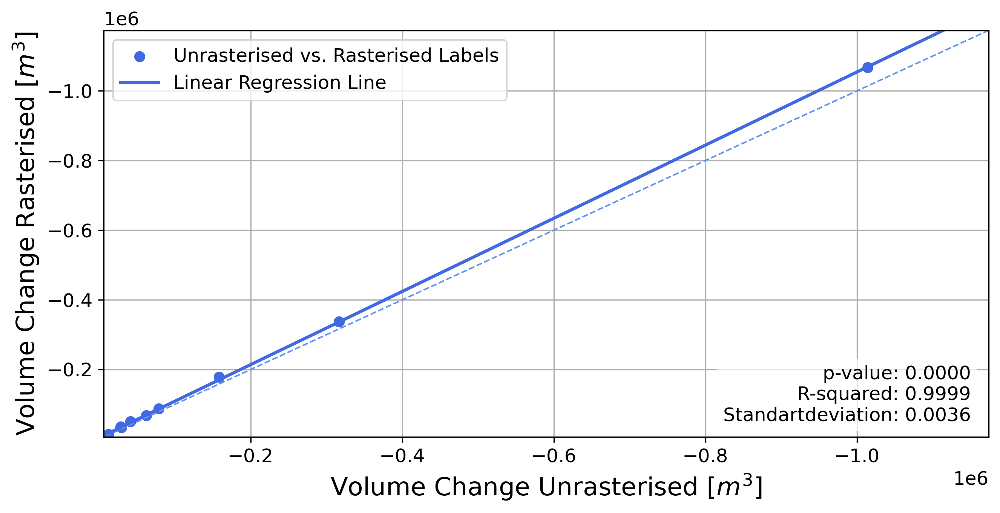

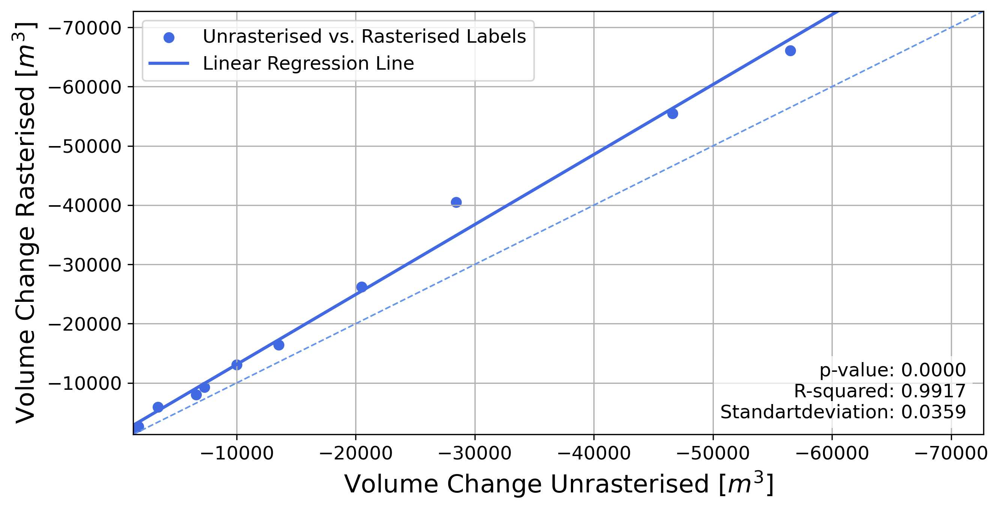

...

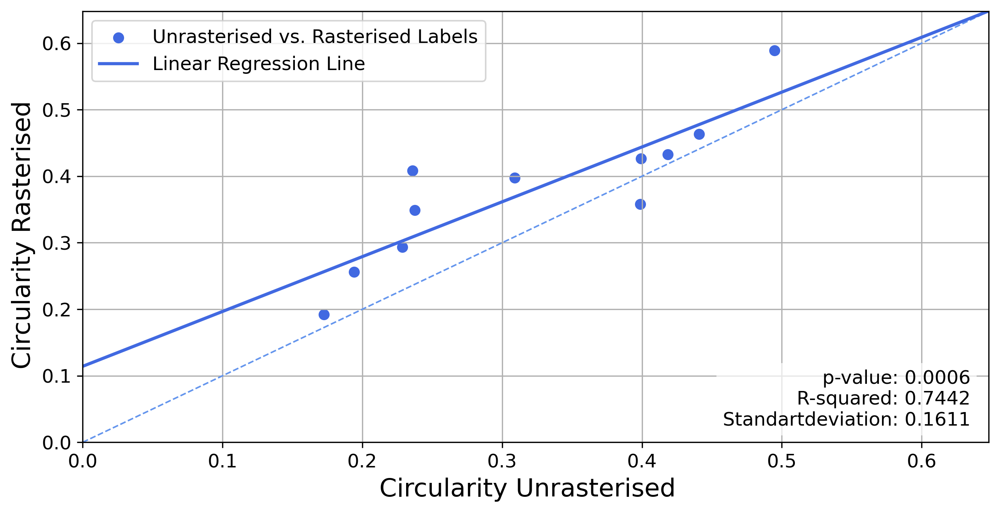

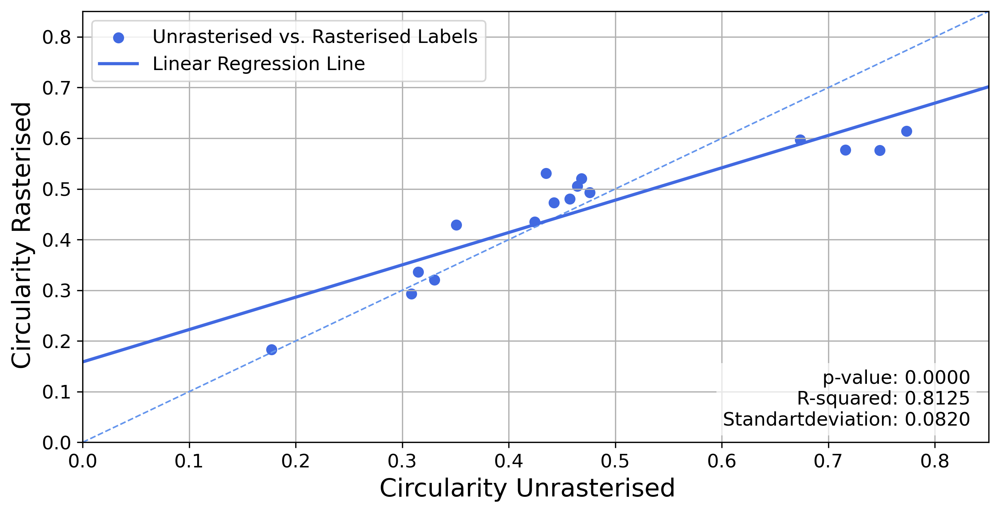

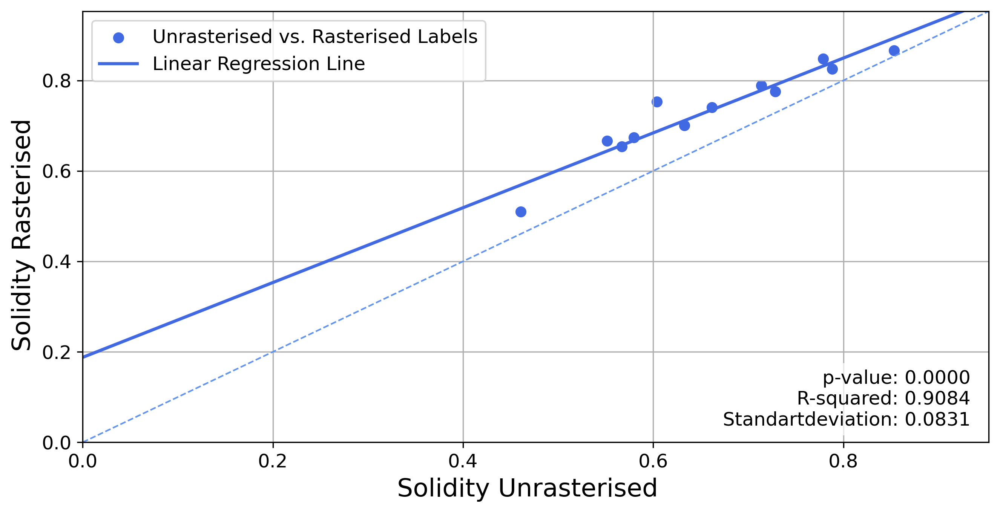

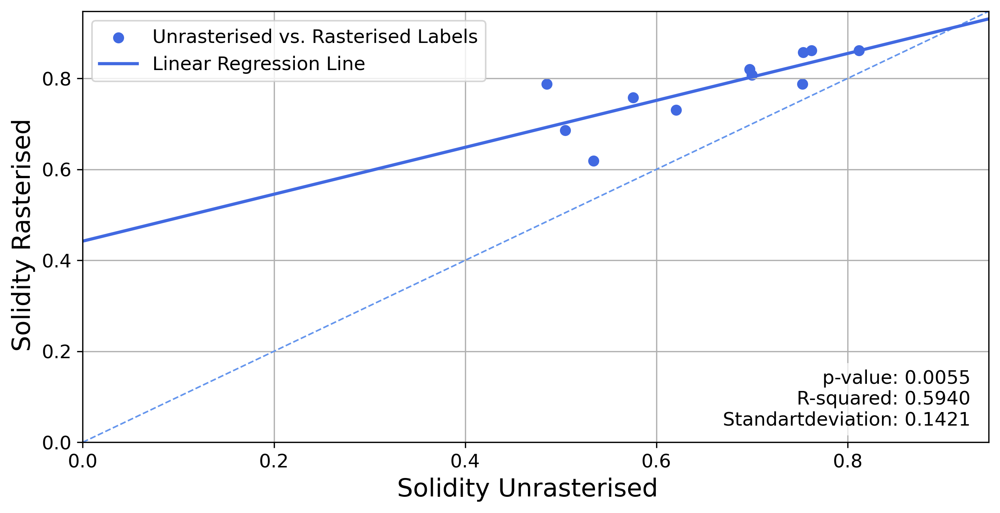

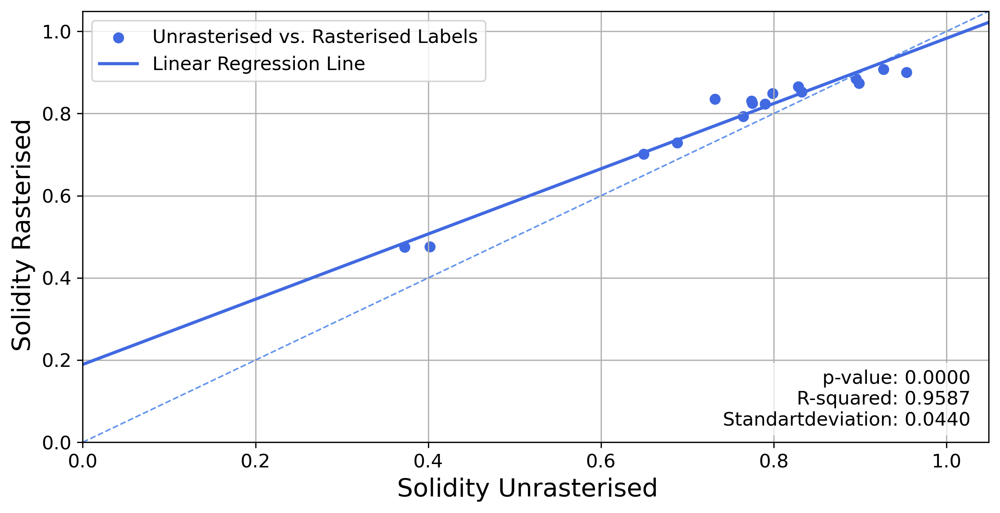

In [99]:
# compare attributes from unrasterised and rasterised dem_labels for different regions 

data_dem_2011_2021 = labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2011_2021"]
data_dem_2013_2021 = labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2013_2021"]
data_dem_2011_2021_rast = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2011_2021"]
data_dem_2013_2021_rast = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2013_2021"]

merged_labels_2011_2021 = pd.merge(data_dem_2011_2021, data_dem_2011_2021_rast, on='identifier', how='inner', suffixes=("_unrast", "_rast"))
merged_labels_2011_2021 = merged_labels_2011_2021[merged_labels_2011_2021["identifier"].notna()]
merged_labels_2013_2021 = pd.merge(data_dem_2013_2021, data_dem_2013_2021_rast, on='identifier', how='inner', suffixes=("_unrast", "_rast"))
merged_labels_2013_2021 = merged_labels_2013_2021[merged_labels_2013_2021["identifier"].notna()]

# dem vs. opt in yamal

dem_2010_2021_yamal = labels_of_year_data["yamal"]["dem_labels"]["unrasterised"]["2010_2021"]
dem_2010_2021_yamal_rast = labels_of_year_data["yamal"]["dem_labels"]["rasterised"]["2010_2021"]

merged_labels_2010_2021_yamal = pd.merge(dem_2010_2021_yamal, dem_2010_2021_yamal_rast, on='identifier', how='inner', suffixes=("_unrast", "_rast"))
merged_labels_2010_2021_yamal = merged_labels_2010_2021_yamal[merged_labels_2010_2021_yamal["identifier"].notna()]

# dem vs. opt in tuktoyaktuk

dem_2010_2021_tuk = labels_of_year_data["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2021"]
dem_2010_2021_tuk_rast = labels_of_year_data["tuktoyaktuk"]["dem_labels"]["rasterised"]["2010_2021"]


merged_labels_2010_2021_tuk = pd.merge(dem_2010_2021_tuk, dem_2010_2021_tuk_rast, on='identifier', how='inner', suffixes=("_unrast", "_rast"))
merged_labels_2010_2021_tuk = merged_labels_2010_2021_tuk[merged_labels_2010_2021_tuk["identifier"].notna()]

new_columns=["identifier", 'Area Unrasterised', 'Area Rasterised', 'Circularity Unrasterised', 'Circularity Rasterised', "Solidity Unrasterised", "Solidity Rasterised", "Volume Change Unrasterised", "Volume Change Rasterised"]
columns = ["identifier", "area_unrast", "area_rast","circularity_unrast", "circularity_rast","solidity_unrast", "solidity_rast", "sum_volume_change_unrast", "sum_volume_change_rast"]
dem_2011_2021_opt_2022 = merged_labels_2011_2021[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2013_2021_opt_2022 = merged_labels_2013_2021[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2010_2021_opt_2022_yamal = merged_labels_2010_2021_yamal[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2010_2021_opt_2019_tuk = merged_labels_2010_2021_tuk[columns].copy().rename(columns=dict(zip(columns, new_columns)))


# plot graphs for the different attributes
attributes = [("Area", "[$m^2$]"), ("Volume Change", "[$m^3$]"), ("Circularity", " "), ("Solidity", " ")]
for attribute, unit in attributes:
    fig_unraster_raster_linregress(np.array(dem_2013_2021_opt_2022[f"{attribute} Unrasterised"]), np.array(dem_2013_2021_opt_2022[f"{attribute} Rasterised"]),"Peel 2", attribute, unit)
    fig_unraster_raster_linregress(np.array(dem_2010_2021_opt_2022_yamal[f"{attribute} Unrasterised"]), np.array(dem_2010_2021_opt_2022_yamal[f"{attribute} Rasterised"]),"Yamal", attribute, unit)
    fig_unraster_raster_linregress(np.array(dem_2010_2021_opt_2019_tuk[f"{attribute} Unrasterised"]), np.array(dem_2010_2021_opt_2019_tuk[f"{attribute} Rasterised"]),"Tuktoyaktuk", attribute, unit)

C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\3138461487.py:9: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  diagonal_values = np.arange(min_value, max_value + step_size, step_size).tolist()


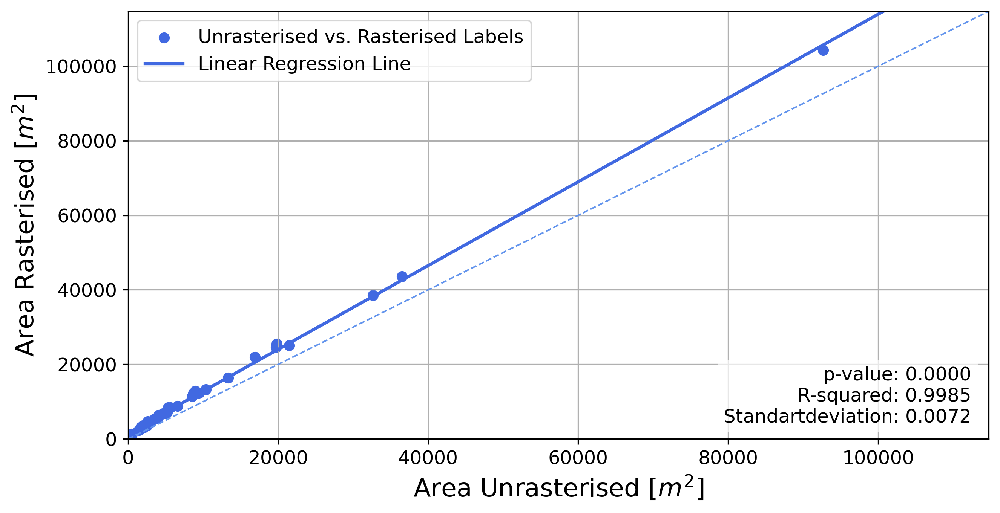

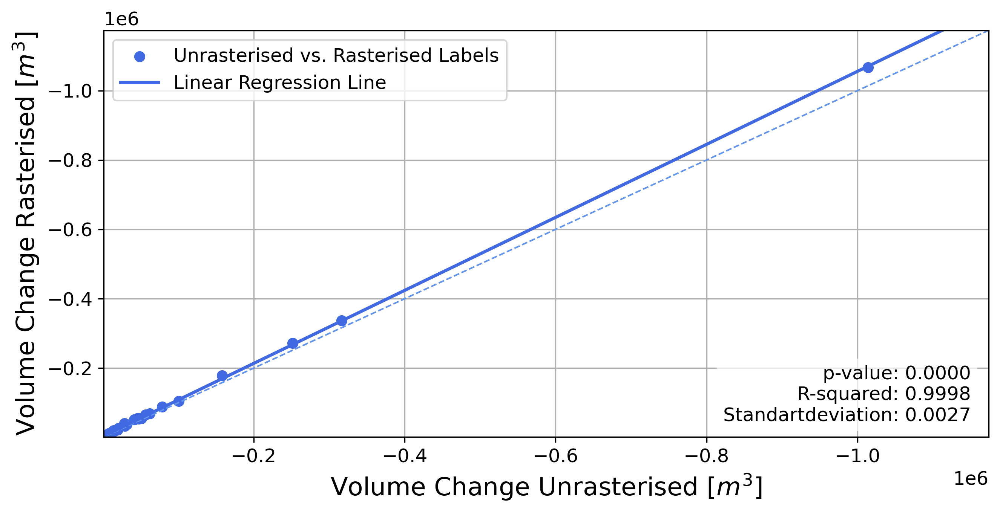

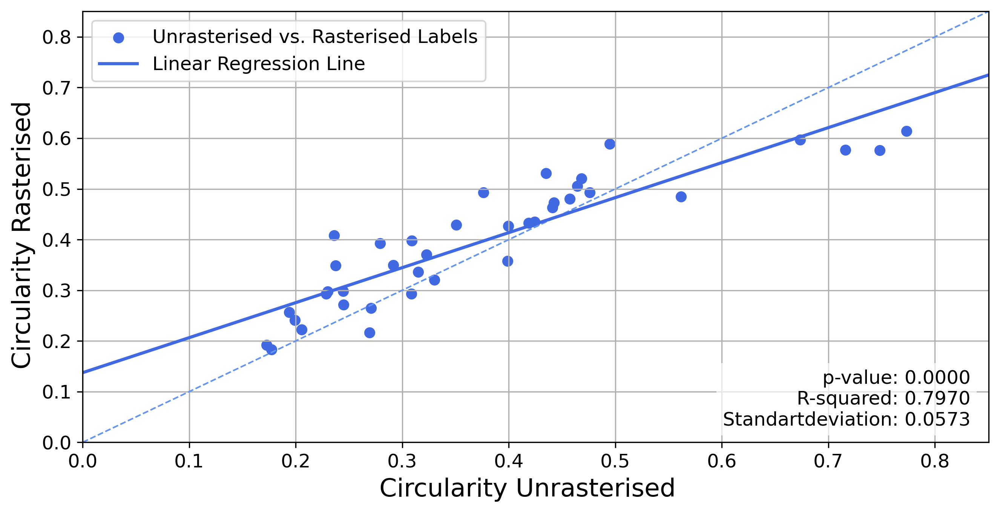

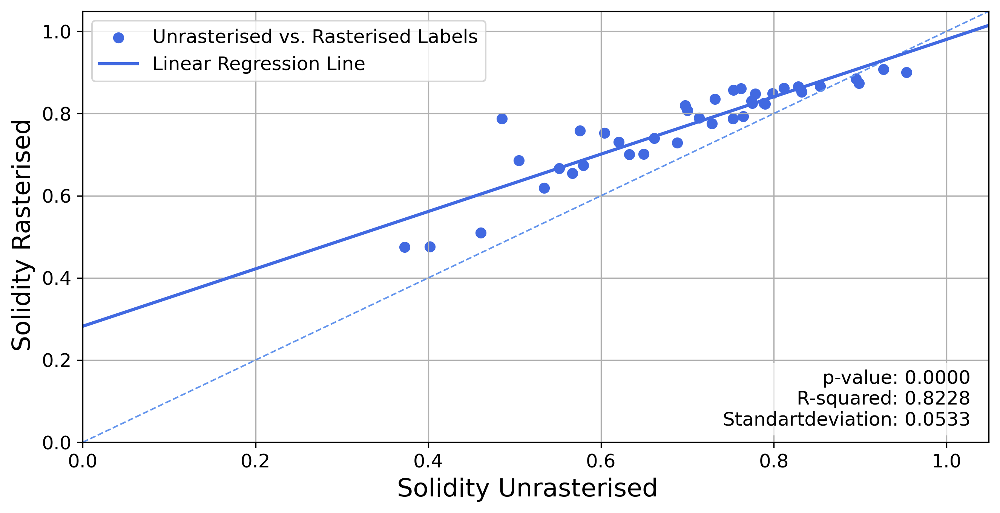

In [100]:
# compare attributes from unrasterised and rasterised dem_labels for all regions together in one plot

data_dem_2011_2021 = labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2011_2021"]
data_dem_2013_2021 = labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2013_2021"]
data_dem_2011_2021_rast = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2011_2021"]
data_dem_2013_2021_rast = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2013_2021"]

merged_labels_2011_2021 = pd.merge(data_dem_2011_2021, data_dem_2011_2021_rast, on='identifier', how='inner', suffixes=("_unrast", "_rast"))
merged_labels_2011_2021 = merged_labels_2011_2021[merged_labels_2011_2021["identifier"].notna()]
merged_labels_2013_2021 = pd.merge(data_dem_2013_2021, data_dem_2013_2021_rast, on='identifier', how='inner', suffixes=("_unrast", "_rast"))
merged_labels_2013_2021 = merged_labels_2013_2021[merged_labels_2013_2021["identifier"].notna()]

# dem vs. opt in yamal

dem_2010_2021_yamal = labels_of_year_data["yamal"]["dem_labels"]["unrasterised"]["2010_2021"]
dem_2010_2021_yamal_rast = labels_of_year_data["yamal"]["dem_labels"]["rasterised"]["2010_2021"]

merged_labels_2010_2021_yamal = pd.merge(dem_2010_2021_yamal, dem_2010_2021_yamal_rast, on='identifier', how='inner', suffixes=("_unrast", "_rast"))
merged_labels_2010_2021_yamal = merged_labels_2010_2021_yamal[merged_labels_2010_2021_yamal["identifier"].notna()]

# dem vs. opt in tuktoyaktuk

dem_2010_2021_tuk = labels_of_year_data["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2021"]
dem_2010_2021_tuk_rast = labels_of_year_data["tuktoyaktuk"]["dem_labels"]["rasterised"]["2010_2021"]


merged_labels_2010_2021_tuk = pd.merge(dem_2010_2021_tuk, dem_2010_2021_tuk_rast, on='identifier', how='inner', suffixes=("_unrast", "_rast"))
merged_labels_2010_2021_tuk = merged_labels_2010_2021_tuk[merged_labels_2010_2021_tuk["identifier"].notna()]

new_columns=["identifier", 'Area Unrasterised', 'Area Rasterised', 'Circularity Unrasterised', 'Circularity Rasterised', "Solidity Unrasterised", "Solidity Rasterised", "Volume Change Unrasterised", "Volume Change Rasterised"]
columns = ["identifier", "area_unrast", "area_rast","circularity_unrast", "circularity_rast","solidity_unrast", "solidity_rast", "sum_volume_change_unrast", "sum_volume_change_rast"]
dem_2011_2021_opt_2022 = merged_labels_2011_2021[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2013_2021_opt_2022 = merged_labels_2013_2021[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2010_2021_opt_2022_yamal = merged_labels_2010_2021_yamal[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2010_2021_opt_2019_tuk = merged_labels_2010_2021_tuk[columns].copy().rename(columns=dict(zip(columns, new_columns)))

unraster_vs_raster = pd.concat([dem_2013_2021_opt_2022, dem_2010_2021_opt_2022_yamal, dem_2010_2021_opt_2019_tuk])


# plot graphs for the different attributes
attributes = [("Area", "[$m^2$]"), ("Volume Change", "[$m^3$]"), ("Circularity", " "), ("Solidity", " ")]
for attribute, unit in attributes:
    fig_unraster_raster_linregress(np.array(unraster_vs_raster[f"{attribute} Unrasterised"]), np.array(unraster_vs_raster[f"{attribute} Rasterised"]),"all Regions", attribute, unit)

C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\3156168434.py:9: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  diagonal_values = np.arange(min_value, max_value + step_size, step_size).tolist()


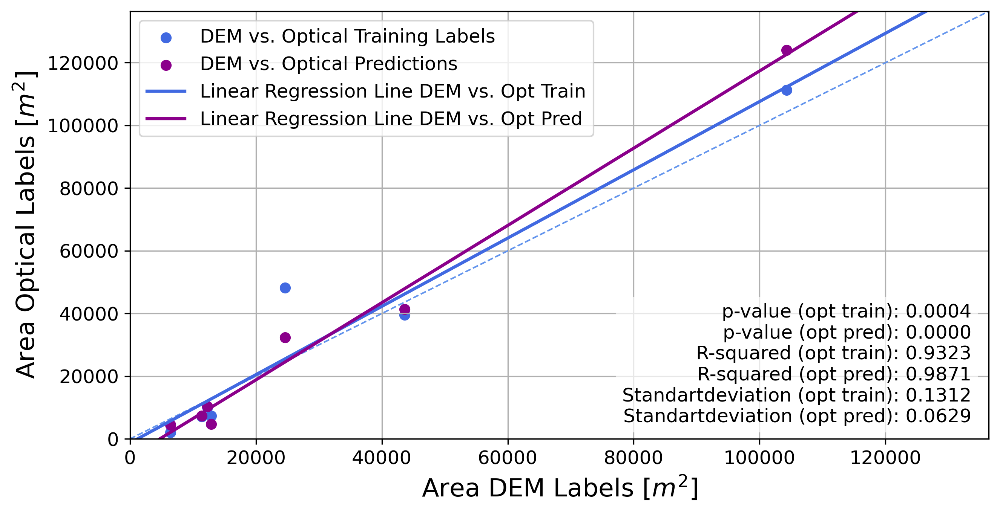

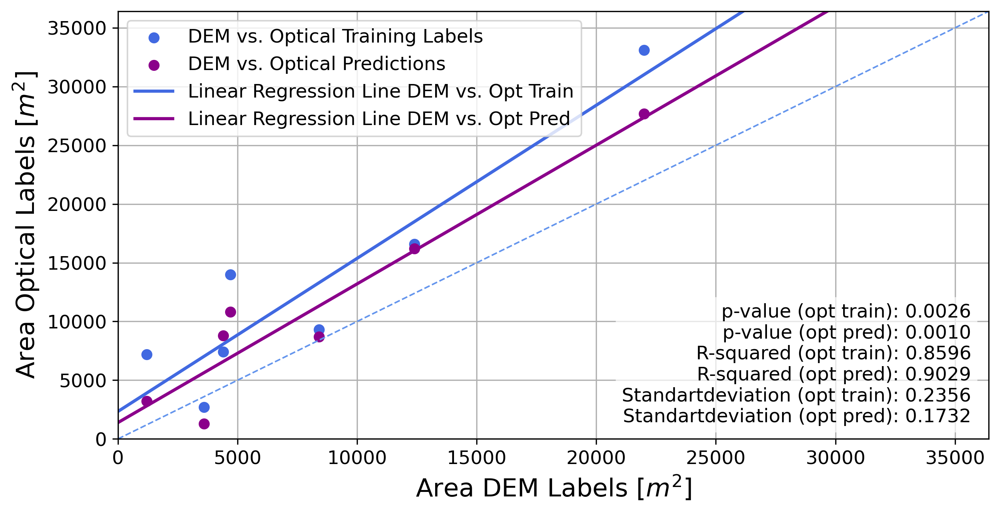

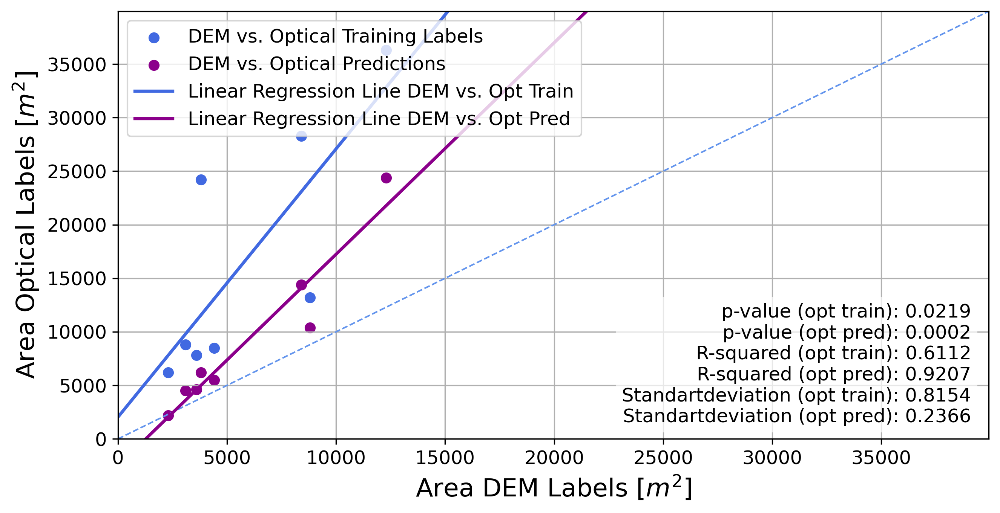

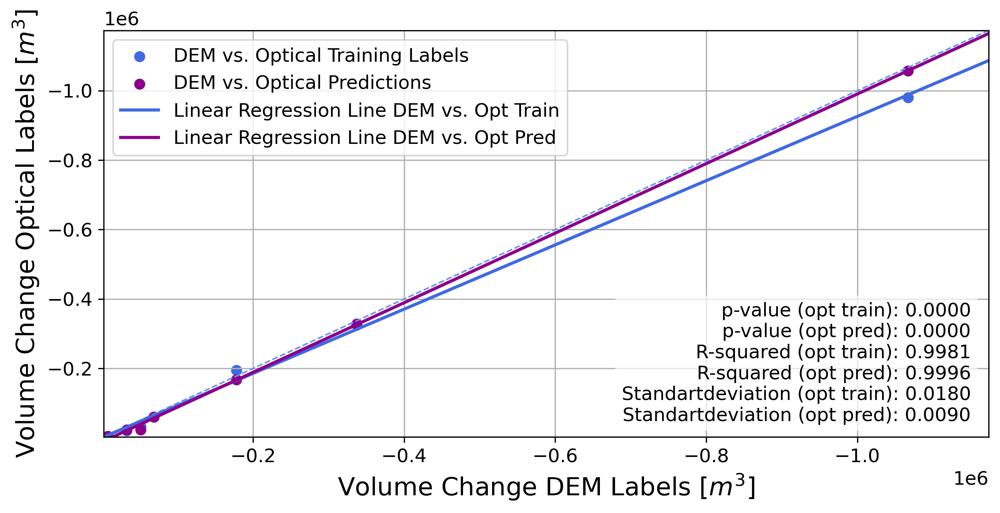

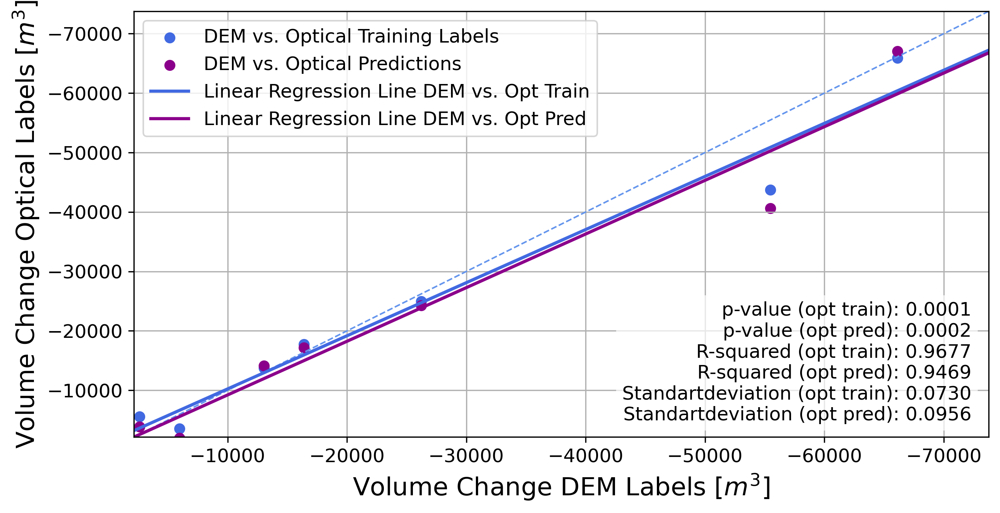

...

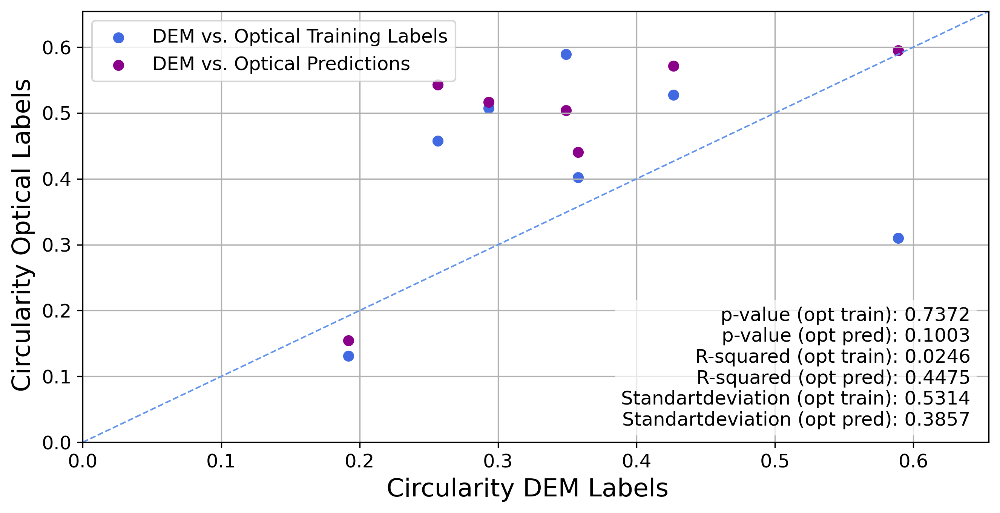

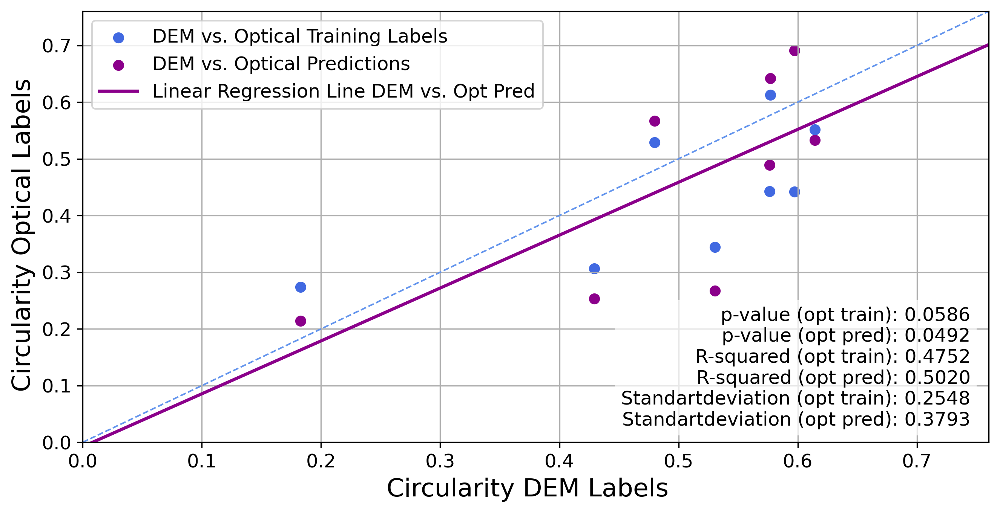

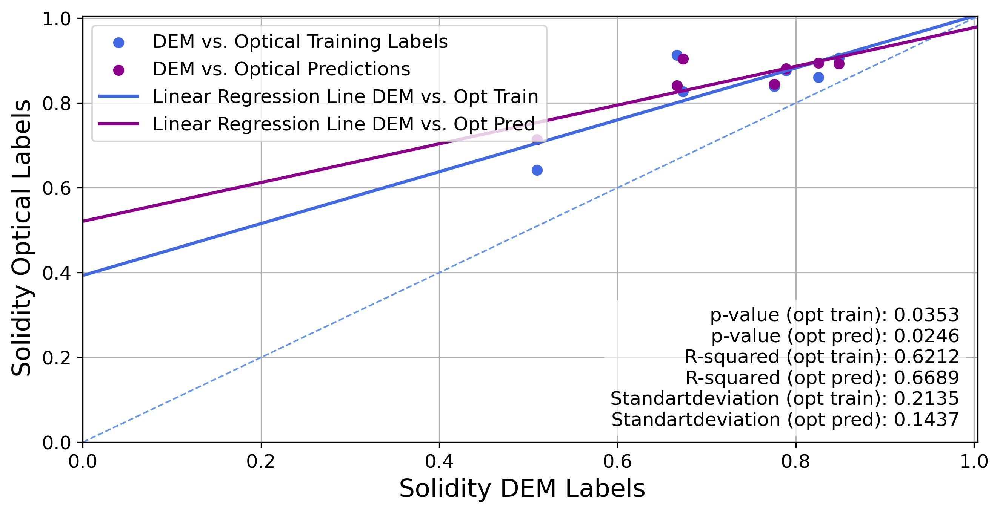

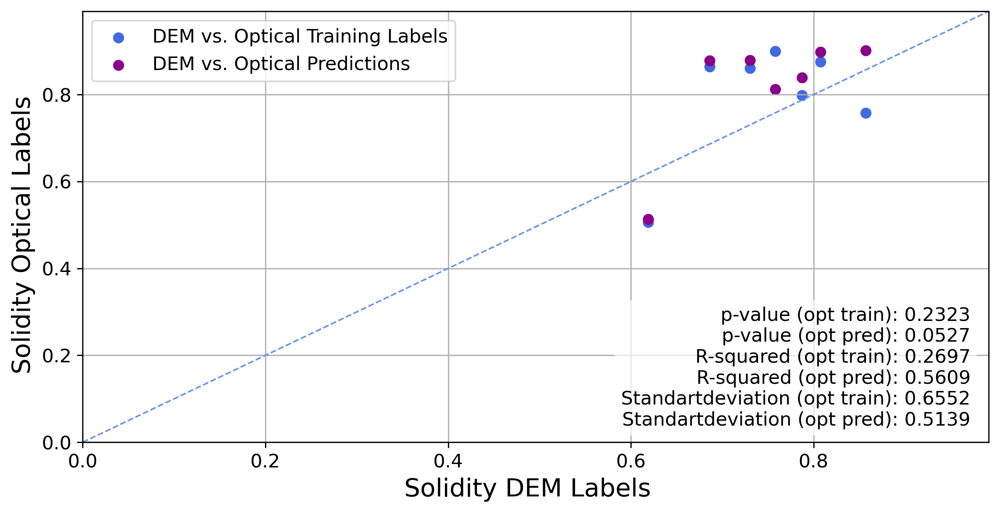

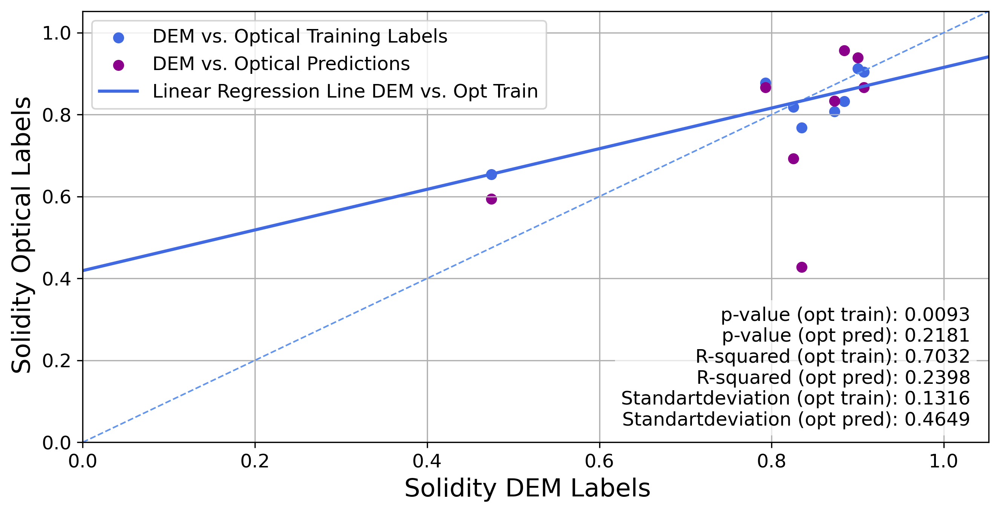

In [101]:
# compare attributes from rasterised dem_labels and optical labels for different regions 

data_dem_2011_2021 = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2011_2021"]
data_dem_2013_2021 = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2013_2021"]
opt_train_data = labels_of_year_data["peel2"]["opt_train_labels"]["rasterised"]["2022"]
opt_pred_data = labels_of_year_data["peel2"]["opt_pred_labels"]["rasterised"]["2022"]
opt_pred_data = opt_pred_data[opt_pred_data["identifier"].notna()]

merged_labels_2011_2021 = pd.merge(data_dem_2011_2021, pd.merge(opt_train_data, opt_pred_data,on='identifier', how='inner', suffixes=("_train", "_pred")), on='identifier', how='inner')
merged_labels_2011_2021 = merged_labels_2011_2021[merged_labels_2011_2021["identifier"].notna()]
merged_labels_2013_2021 = pd.merge(data_dem_2013_2021, pd.merge(opt_train_data, opt_pred_data,on='identifier', how='inner', suffixes=("_train", "_pred")), on='identifier', how='inner')
merged_labels_2013_2021 = merged_labels_2013_2021[merged_labels_2013_2021["identifier"].notna()]

# dem vs. opt in yamal

dem_2010_2021_yamal = labels_of_year_data["yamal"]["dem_labels"]["rasterised"]["2010_2021"]
opt_train_yamal = labels_of_year_data["yamal"]["opt_train_labels"]["rasterised"]["2022"]
opt_pred_yamal = labels_of_year_data["yamal"]["opt_pred_labels"]["rasterised"]["2022"]
opt_pred_yamal = opt_pred_yamal[opt_pred_yamal["identifier"].notna()]

merged_labels_2010_2021_yamal = pd.merge(dem_2010_2021_yamal, pd.merge(opt_train_yamal, opt_pred_yamal,on='identifier', how='inner', suffixes=("_train", "_pred")), on='identifier', how='inner')
merged_labels_2010_2021_yamal = merged_labels_2010_2021_yamal[merged_labels_2010_2021_yamal["identifier"].notna()]

# dem vs. opt in tuktoyaktuk

dem_2010_2021_tuk = labels_of_year_data["tuktoyaktuk"]["dem_labels"]["rasterised"]["2010_2021"]
opt_train_tuk = labels_of_year_data["tuktoyaktuk"]["opt_train_labels"]["rasterised"]["2019"]
opt_pred_tuk = labels_of_year_data["tuktoyaktuk"]["opt_pred_labels"]["rasterised"]["2019"]
opt_pred_tuk = opt_pred_tuk[opt_pred_tuk["identifier"].notna()]

merged_labels_2010_2021_tuk = pd.merge(dem_2010_2021_tuk, pd.merge(opt_train_tuk, opt_pred_tuk,on='identifier', how='inner', suffixes=("_train", "_pred")), on='identifier', how='inner')
merged_labels_2010_2021_tuk = merged_labels_2010_2021_tuk[merged_labels_2010_2021_tuk["identifier"].notna()]

new_columns=["identifier", 'Area DEM', 'Area opt_train', "Area opt_pred", 'Circularity DEM', 'Circularity opt_train', 'Circularity opt_pred', "Solidity DEM", "Solidity opt_train", "Solidity opt_pred", "volume avg DEM", "volume avg opt_train", "volume avg opt_pred", "Volume Change DEM", "Volume Change opt_train", "Volume Change opt_pred"]
columns = ["identifier", "area", "area_train", "area_pred","circularity", "circularity_train", "circularity_pred","solidity", "solidity_train", "solidity_pred", "avg_volume_change", "avg_volume_change_train", "avg_volume_change_pred", "sum_volume_change", "sum_volume_change_train", "sum_volume_change_pred"]
dem_2011_2021_opt_2022 = merged_labels_2011_2021[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2013_2021_opt_2022 = merged_labels_2013_2021[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2010_2021_opt_2022_yamal = merged_labels_2010_2021_yamal[columns].copy().rename(columns=dict(zip(columns, new_columns)))

dem_2010_2021_opt_2019_tuk = merged_labels_2010_2021_tuk[columns].copy().rename(columns=dict(zip(columns, new_columns)))

# plot graphs for the different attributes
attributes = [("Area", "[$m^2$]"), ("Volume Change", "[$m^3$]"), ("Circularity", " "), ("Solidity", " ")]
for attribute, unit in attributes:
    fig_dem_vs_opt_with_linregress(np.array(dem_2013_2021_opt_2022[f"{attribute} DEM"]), np.array(dem_2013_2021_opt_2022[f"{attribute} opt_train"]), np.array(dem_2013_2021_opt_2022[f"{attribute} opt_pred"]),"Peel 2 Rasterised", attribute, unit)
    fig_dem_vs_opt_with_linregress(np.array(dem_2010_2021_opt_2022_yamal[f"{attribute} DEM"]), np.array(dem_2010_2021_opt_2022_yamal[f"{attribute} opt_train"]), np.array(dem_2010_2021_opt_2022_yamal[f"{attribute} opt_pred"]),"Yamal Rasterised", attribute, unit)
    fig_dem_vs_opt_with_linregress(np.array(dem_2010_2021_opt_2019_tuk[f"{attribute} DEM"]), np.array(dem_2010_2021_opt_2019_tuk[f"{attribute} opt_train"]), np.array(dem_2010_2021_opt_2019_tuk[f"{attribute} opt_pred"]),"Tuktoyaktuk Rasterised", attribute, unit)


## Volume Change

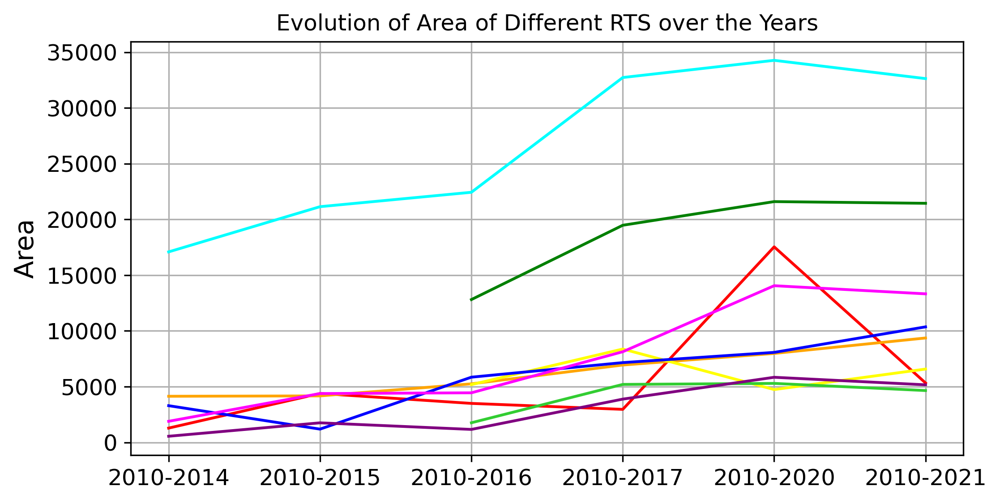

In [102]:
# Volume change over the years of the few slumps labeled in tuk
tuk_14 = labels_of_year_data_me["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2014"]
tuk_15 = labels_of_year_data_me["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2015"]
tuk_16 = labels_of_year_data_me["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2016"]
tuk_17 = labels_of_year_data_me["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2017"]
tuk_20 = labels_of_year_data_me["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2020"]
tuk_21 = labels_of_year_data_me["tuktoyaktuk"]["dem_labels"]["unrasterised"]["2010_2021"]
tuk = [tuk_14, tuk_15, tuk_16, tuk_17, tuk_20, tuk_21]
years = [14, 15, 16, 17, 20, 21]
tuk_merged = tuk_14[["identifier", "area"]]
for i in range(1, len(tuk)):
    tuk[i] = tuk[i][["identifier", "area"]]
    year = years[i]
    tuk_merged = pd.merge(tuk_merged, tuk[i], how="outer", on="identifier", suffixes=[None, f"_{year}"])
tuk_merged = tuk_merged.dropna(subset="identifier")
tuk_merged
# Prepare data for plotting
years = ["2010-2014", "2010-2015", "2010-2016", "2010-2017", "2010-2020", "2010-2021"]
area_columns = ['area', 'area_15', 'area_16', 'area_17', 'area_20', 'area_21']
colors = ["red", "orange", "yellow", "green", "limegreen","cyan", "blue", "magenta", "purple"]

# Plotting
fig, ax1 = plt.subplots(figsize=(8, 4), dpi=300)

for idx, (row, color) in enumerate(zip(tuk_merged.iterrows(), colors)):
    _, row = row  # unpack the tuple returned by iterrows
    areas = row[area_columns].values
    ax1.plot(years, areas, label=row['identifier'], color=color)

# Adding plot labels and legend
ax1.set_ylabel('Area')
ax1.set_title('Evolution of Area of Different RTS over the Years')
ax1.grid(True)
plt.show()

### avg vs. sum

In [103]:
# compares the two methods for the volume change calculation
mean_vol_change_avg_peel2 = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2011_2021"]["avg_volume_change"].mean()
mean_vol_change_sum_peel2 = labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2011_2021"]["sum_volume_change"].mean()
mean_vol_change_avg_tuk = labels_of_year_data["tuktoyaktuk"]["dem_labels"]["rasterised"]["2010_2021"]["avg_volume_change"].mean()
mean_vol_change_sum_tuk = labels_of_year_data["tuktoyaktuk"]["dem_labels"]["rasterised"]["2010_2021"]["sum_volume_change"].mean()
mean_vol_change_avg_yamal = labels_of_year_data["yamal"]["dem_labels"]["rasterised"]["2010_2021"]["avg_volume_change"].mean()
mean_vol_change_sum_yamal = labels_of_year_data["yamal"]["dem_labels"]["rasterised"]["2010_2021"]["sum_volume_change"].mean()
volume_change_dict = {"peel2": {"Berechnung mit Durchschnittlicher Höhe": mean_vol_change_avg_peel2, "Berechnung mit aufsummieren einzelner Pixel Volumenänderungen":mean_vol_change_sum_peel2},
                        "tuktoyaktuk" : {"Berechnung mit Durchschnittlicher Höhe":mean_vol_change_avg_tuk, "Berechnung mit aufsummieren einzelner Pixel Volumenänderungen":mean_vol_change_sum_tuk},
                        "yamal": {"Berechnung mit Durchschnittlicher Höhe":mean_vol_change_avg_yamal, "Berechnung mit aufsummieren einzelner Pixel Volumenänderungen":mean_vol_change_sum_yamal}}

volume_change_comparison_dem = pd.DataFrame(volume_change_dict)
display(volume_change_comparison_dem)
print("Durchschnittlicher Volumenverlust pro Slump in [m^3] der 3 Gebiete mit verschiedenen Arten berechnet. Mit rasterisierten Daten.")

,peel2,tuktoyaktuk,yamal
Berechnung mit Durchschnittlicher Höhe,-81644.155763,-32943.533717,-25756.518407
Berechnung mit aufsummieren einzelner Pixel Volumenänderungen,-81644.155736,-32943.533431,-25756.518655


Durchschnittlicher Volumenverlust pro Slump in [m^3] der 3 Gebiete mit verschiedenen Arten berechnet. Mit rasterisierten Daten.


Volume change is approximately the same for both methods. Difference in the decimals can even stem from calculations in python with rounding

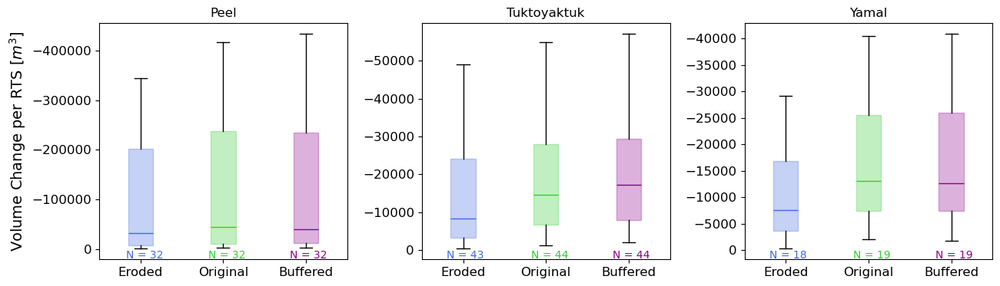

In [104]:
# Boxplot comparing erased, original and buffered volume change for dem data

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind = "dem_labels"
year_peel = "2013_2021"
year_tuk = "2010_2021"
year_yamal = "2010_2021"
# peel
plot1 = ax1.boxplot([buffered_erased["peel2"][label_kind]["erased"][year_peel]["sum_volume_change"].dropna(), buffered_erased["peel2"][label_kind]["original"][year_peel]["sum_volume_change"].dropna(), buffered_erased["peel2"][label_kind]["buffered"][year_peel]["sum_volume_change"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# tuk
plot2 = ax2.boxplot([buffered_erased["tuktoyaktuk"][label_kind]["erased"][year_tuk]["sum_volume_change"].dropna(), buffered_erased["tuktoyaktuk"][label_kind]["original"][year_tuk]["sum_volume_change"].dropna(), buffered_erased["tuktoyaktuk"][label_kind]["buffered"][year_tuk]["sum_volume_change"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# yamal
plot3 = ax3.boxplot([buffered_erased["yamal"][label_kind]["erased"][year_yamal]["sum_volume_change"].dropna(), buffered_erased["yamal"][label_kind]["original"][year_yamal]["sum_volume_change"].dropna(), buffered_erased["yamal"][label_kind]["buffered"][year_yamal]["sum_volume_change"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

box_colors = ['royalblue',"limegreen", 'darkmagenta', ]
for plot in [plot1, plot2, plot3]:
    for patch, median, whisker, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("Peel")
ax2.set_title("Tuktoyaktuk")
ax3.set_title("Yamal")
ax1.set_ylabel('Volume Change per RTS [$m^3$]')

number1 = [len(buffered_erased["peel2"][label_kind]["erased"][year_peel]["sum_volume_change"].dropna()), len(buffered_erased["peel2"][label_kind]["original"][year_peel]["sum_volume_change"].dropna()), len(buffered_erased["peel2"][label_kind]["buffered"][year_peel]["sum_volume_change"].dropna())]
number2 = [len(buffered_erased["tuktoyaktuk"][label_kind]["erased"][year_tuk]["sum_volume_change"].dropna()), len(buffered_erased["tuktoyaktuk"][label_kind]["original"][year_tuk]["sum_volume_change"].dropna()), len(buffered_erased["tuktoyaktuk"][label_kind]["buffered"][year_tuk]["sum_volume_change"].dropna())]
number3 = [len(buffered_erased["yamal"][label_kind]["erased"][year_yamal]["sum_volume_change"].dropna()), len(buffered_erased["yamal"][label_kind]["original"][year_yamal]["sum_volume_change"].dropna()), len(buffered_erased["yamal"][label_kind]["buffered"][year_yamal]["sum_volume_change"].dropna())]

# Add text to the upper right corner
ax1.text(0.26, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.59, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[2], fontsize=10)

ax2.text(0.25, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0], fontsize=10)
ax2.text(0.59, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.92, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[2], fontsize=10)

ax3.text(0.25, 0.04, f"N = {number3[0]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[0], fontsize=10)
ax3.text(0.59, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[1], fontsize=10)
ax3.text(0.92, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[2], fontsize=10)

ax1.invert_yaxis()
ax2.invert_yaxis()
ax3.invert_yaxis()

plt.subplots_adjust(wspace=0.3)

# Display the boxplot
save_fig(fig, "Volume_change_per_RTS_dem")
plt.show()

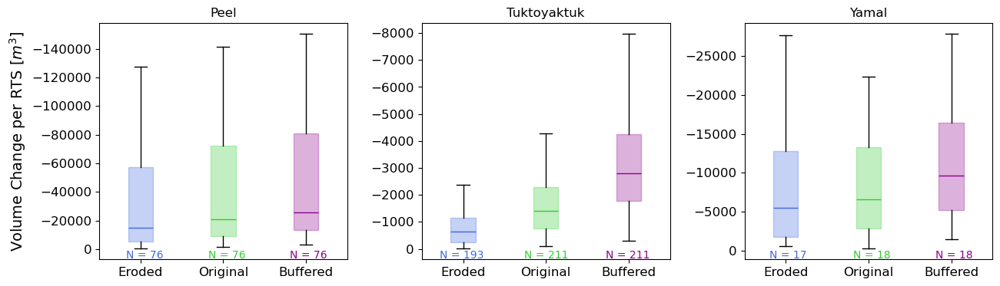

In [105]:
# Boxplot comparing erased, original and buffered volume change for opt_train data

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind = "opt_train_labels"
year_peel = "2022"
year_tuk = "2019"
year_yamal = "2022"
# peel
plot1 = ax1.boxplot([buffered_erased["peel2"][label_kind]["erased"][year_peel]["sum_volume_change"].dropna(), buffered_erased["peel2"][label_kind]["original"][year_peel]["sum_volume_change"].dropna(), buffered_erased["peel2"][label_kind]["buffered"][year_peel]["sum_volume_change"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# tuk
plot2 = ax2.boxplot([buffered_erased["tuktoyaktuk"][label_kind]["erased"][year_tuk]["sum_volume_change"].dropna(), buffered_erased["tuktoyaktuk"][label_kind]["original"][year_tuk]["sum_volume_change"].dropna(), buffered_erased["tuktoyaktuk"][label_kind]["buffered"][year_tuk]["sum_volume_change"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

# yamal
plot3 = ax3.boxplot([buffered_erased["yamal"][label_kind]["erased"][year_yamal]["sum_volume_change"].dropna(), buffered_erased["yamal"][label_kind]["original"][year_yamal]["sum_volume_change"].dropna(), buffered_erased["yamal"][label_kind]["buffered"][year_yamal]["sum_volume_change"].dropna()], labels=["Eroded", "Original", "Buffered"], showfliers=False, patch_artist=True)

box_colors = ['royalblue',"limegreen", 'darkmagenta', ]
for plot in [plot1, plot2, plot3]:
    for patch, median, whisker, color in zip(plot['boxes'], plot["medians"], plot["whiskers"], box_colors):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("Peel")
ax2.set_title("Tuktoyaktuk")
ax3.set_title("Yamal")
ax1.set_ylabel('Volume Change per RTS [$m^3$]')

number1 = [len(buffered_erased["peel2"][label_kind]["erased"][year_peel]["sum_volume_change"].dropna()), len(buffered_erased["peel2"][label_kind]["original"][year_peel]["sum_volume_change"].dropna()), len(buffered_erased["peel2"][label_kind]["buffered"][year_peel]["sum_volume_change"].dropna())]
number2 = [len(buffered_erased["tuktoyaktuk"][label_kind]["erased"][year_tuk]["sum_volume_change"].dropna()), len(buffered_erased["tuktoyaktuk"][label_kind]["original"][year_tuk]["sum_volume_change"].dropna()), len(buffered_erased["tuktoyaktuk"][label_kind]["buffered"][year_tuk]["sum_volume_change"].dropna())]
number3 = [len(buffered_erased["yamal"][label_kind]["erased"][year_yamal]["sum_volume_change"].dropna()), len(buffered_erased["yamal"][label_kind]["original"][year_yamal]["sum_volume_change"].dropna()), len(buffered_erased["yamal"][label_kind]["buffered"][year_yamal]["sum_volume_change"].dropna())]

# Add text to the upper right corner
ax1.text(0.26, 0.04, f"N = {number1[0]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[0], fontsize=10)
ax1.text(0.59, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[1], fontsize=10)
ax1.text(0.92, 0.04, f"N = {number1[1]}", ha='right', va='top', transform=ax1.transAxes, color=box_colors[2], fontsize=10)

ax2.text(0.25, 0.04, f"N = {number2[0]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[0], fontsize=10)
ax2.text(0.59, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[1], fontsize=10)
ax2.text(0.92, 0.04, f"N = {number2[1]}", ha='right', va='top', transform=ax2.transAxes, color=box_colors[2], fontsize=10)

ax3.text(0.25, 0.04, f"N = {number3[0]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[0], fontsize=10)
ax3.text(0.59, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[1], fontsize=10)
ax3.text(0.92, 0.04, f"N = {number3[1]}", ha='right', va='top', transform=ax3.transAxes, color=box_colors[2], fontsize=10)

ax1.invert_yaxis()
ax2.invert_yaxis()
ax3.invert_yaxis()

plt.subplots_adjust(wspace=0.3)

# Display the boxplot
save_fig(fig, "Volume_change_per_RTS_opt_train")
plt.show()

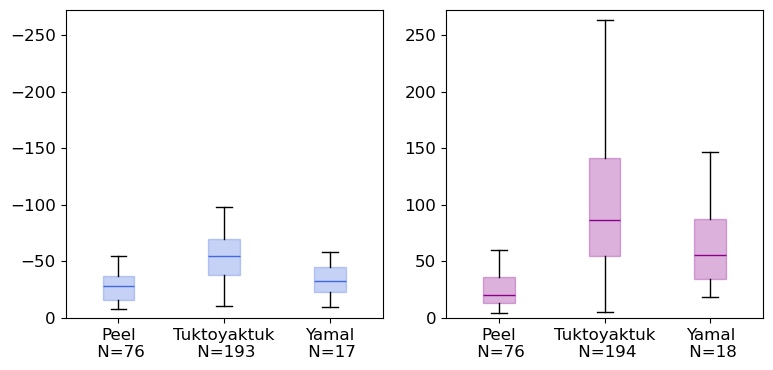

In [106]:
# Boxplot comparing Volume Change error in % of original for buffered and erased opt train labels for all regions
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind = "opt_train_labels"
year_peel = "2022"
year_tuk = "2019"
year_yamal = "2022"

peel_er = buf_er_merged["peel2"][label_kind][year_peel]["vol_change_er_%"].dropna()
tuk_er = buf_er_merged["tuktoyaktuk"][label_kind][year_tuk]["vol_change_er_%"].dropna()
yamal_er = buf_er_merged["yamal"][label_kind][year_yamal]["vol_change_er_%"].dropna()
peel_buf = buf_er_merged["peel2"][label_kind][year_peel]["vol_change_buf_%"].dropna()
tuk_buf = buf_er_merged["tuktoyaktuk"][label_kind][year_tuk]["vol_change_buf_%"].dropna()
yamal_buf = buf_er_merged["yamal"][label_kind][year_yamal]["vol_change_buf_%"].dropna()

number1 = [len(peel_er), len(tuk_er), len(yamal_er)]
number2 = [len(peel_buf), len(tuk_buf), len(yamal_buf)]

# % erased
plot1 = ax1.boxplot([peel_er, tuk_er, yamal_er ], labels=[f"Peel\n N={number1[0]}", f"Tuktoyaktuk\n N={number1[1]}", f"Yamal\n N={number1[2]}"], showfliers=False, patch_artist=True)

# % buffered
plot2 = ax2.boxplot([peel_buf, tuk_buf, yamal_buf], labels=[f"Peel\n N={number2[0]}", f"Tuktoyaktuk\n N={number2[1]}", f"Yamal\n N={number2[2]}"], showfliers=False, patch_artist=True)

box_colors = ['royalblue', 'darkmagenta', ]
for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, whisker in zip(plot['boxes'], plot["medians"], plot["whiskers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
max_limit = max(-custom_whisker(peel_er)[0], -custom_whisker(tuk_er)[0], -custom_whisker(yamal_er)[0], custom_whisker(peel_buf)[1], custom_whisker(tuk_buf)[1], custom_whisker(yamal_buf)[1])
ax1.set_ylim(-max_limit, 0)
ax2.set_ylim(0, max_limit)

ax1.invert_yaxis()


# Display the boxplot
save_fig(fig, "Volume_change_per_RTS_opt_train_percentage")
plt.show()

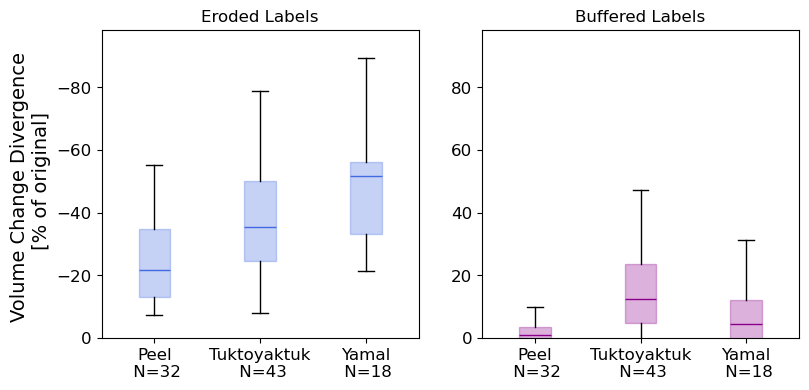

In [107]:
# Boxplot comparing Volume Change in % of original for buffered and erased dem labels for all regions
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind = "dem_labels"
year_peel = "2013_2021"
year_tuk = "2010_2021"
year_yamal = "2010_2021"

peel_er = buf_er_merged["peel2"][label_kind][year_peel]["vol_change_er_%"].dropna()
tuk_er = buf_er_merged["tuktoyaktuk"][label_kind][year_tuk]["vol_change_er_%"].dropna()
yamal_er = buf_er_merged["yamal"][label_kind][year_yamal]["vol_change_er_%"].dropna()
peel_buf = buf_er_merged["peel2"][label_kind][year_peel]["vol_change_buf_%"].dropna()
tuk_buf = buf_er_merged["tuktoyaktuk"][label_kind][year_tuk]["vol_change_buf_%"].dropna()
yamal_buf = buf_er_merged["yamal"][label_kind][year_yamal]["vol_change_buf_%"].dropna()

number1 = [len(peel_er), len(tuk_er), len(yamal_er)]
number2 = [len(peel_buf), len(tuk_buf), len(yamal_buf)]

# % erased
plot1 = ax1.boxplot([peel_er, tuk_er, yamal_er ], labels=[f"Peel\n N={number1[0]}", f"Tuktoyaktuk\n N={number1[1]}", f"Yamal\n N={number1[2]}"], showfliers=False, patch_artist=True)

# % buffered
plot2 = ax2.boxplot([peel_buf, tuk_buf, yamal_buf], labels=[f"Peel\n N={number2[0]}", f"Tuktoyaktuk\n N={number2[1]}", f"Yamal\n N={number2[2]}"], showfliers=False, patch_artist=True)

box_colors = ['royalblue', 'darkmagenta', ]
for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, whisker in zip(plot['boxes'], plot["medians"], plot["whiskers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("Eroded Labels")
ax2.set_title("Buffered Labels")
ax1.set_ylabel('Volume Change Divergence \n [% of original]')

max_limit = max(-custom_whisker(peel_er)[0], -custom_whisker(tuk_er)[0], -custom_whisker(yamal_er)[0], custom_whisker(peel_buf)[1], custom_whisker(tuk_buf)[1], custom_whisker(yamal_buf)[1])
ax1.set_ylim(-max_limit*1.1, 0)
ax2.set_ylim(0, max_limit*1.1)

ax1.invert_yaxis()


# Display the boxplot
save_fig(fig, "Volume_change_per_RTS_dem_percentage")
plt.show()

The buffered volume changes are in comparison to the original labels not 0% bigger but just really little bigger
Peel rather big RTSs -> less change when buffered
When erased always big change because parts of the headwall are missed

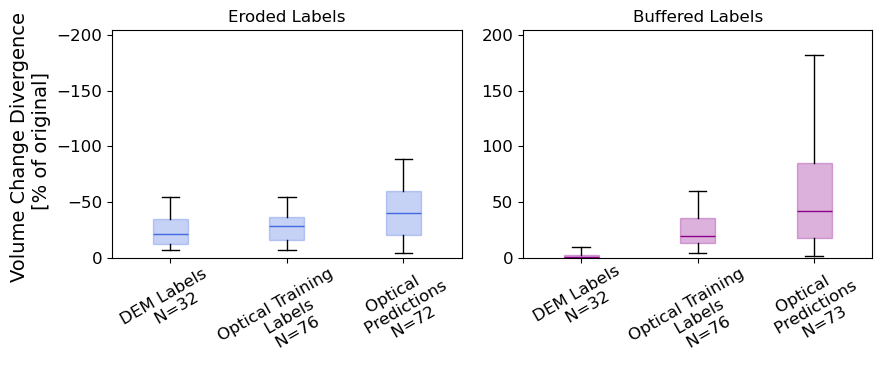

In [108]:
# Boxplot comparing Volume Change in % of original for buffered and erased for the different label kinds in peel
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4)) # plt.subplots(amount underneath each other, amont next to each other, figsize=(width, height))

label_kind1 = "dem_labels"
label_kind2 = "opt_train_labels"
label_kind3 = "opt_pred_labels"
year_1 = "2013_2021"
year_2 = "2022"
year_3 = "2022"
region = "peel2"

dem_er = buf_er_merged[region][label_kind1][year_1]["vol_change_er_%"].dropna()
train_er = buf_er_merged[region][label_kind2][year_2]["vol_change_er_%"].dropna()
pred_er = buf_er_merged[region][label_kind3][year_3]["vol_change_er_%"].dropna()
dem_buf = buf_er_merged[region][label_kind1][year_1]["vol_change_buf_%"].dropna()
train_buf = buf_er_merged[region][label_kind2][year_2]["vol_change_buf_%"].dropna()
pred_buf = buf_er_merged[region][label_kind3][year_3]["vol_change_buf_%"].dropna()

number1 = [len(dem_er), len(train_er), len(pred_er)]
number2 = [len(dem_buf), len(train_buf), len(pred_buf)]

# % erased
plot1 = ax1.boxplot([dem_er, train_er, pred_er ], labels=[f"DEM Labels \n N={number1[0]}", f"Optical Training \n Labels\n N={number1[1]}", f"Optical \n Predictions\n N={number1[2]}"], showfliers=False, patch_artist=True)

# % buffered
plot2 = ax2.boxplot([dem_buf, train_buf, pred_buf], labels=[f"DEM Labels\n N={number2[0]}", f"Optical Training \n Labels\n N={number2[1]}", f"Optical \n Predictions\n N={number2[2]}"], showfliers=False, patch_artist=True)

box_colors = ['royalblue', 'darkmagenta', ]
for plot, color in zip([plot1, plot2], box_colors):
    for patch, median, whisker in zip(plot['boxes'], plot["medians"], plot["whiskers"]):
        patch.set(facecolor=color, alpha=0.3)
        patch.set(color=color)
        median.set(color=color)
        
# Set titles for the subplots
ax1.set_title("Eroded Labels")
ax2.set_title("Buffered Labels")
ax1.set_ylabel('Volume Change Divergence \n [% of original]')

max_limit = max(-custom_whisker(dem_er)[0], -custom_whisker(train_er)[0], -custom_whisker(pred_er)[0], custom_whisker(dem_buf)[1], custom_whisker(train_buf)[1], custom_whisker(pred_buf)[1])
ax1.set_ylim(-max_limit*1.1, 0)
ax2.set_ylim(0, max_limit*1.1)

ax1.invert_yaxis()
ax1.tick_params(axis='x', rotation=30, pad = 0)
ax2.tick_params(axis='x', rotation=30, pad = 0)
plt.tight_layout()

# Display the boxplot
save_fig(fig, f"Volume_change_comparison_label_kinds_percentage_{region}")
plt.show()

### Total Volumechange unrasterised, rasterised, eroded, buffered [draft]

In [109]:
# Creates a new dictionarry with the volume changes of the different reagions summed up per period or year

tot_vol_change_dict = {}
union_df = pd.DataFrame()
for region in buffered_erased:
    region_dict = {}
    for label_groupe in buffered_erased[region]:
        label_groupe_dict = {}
        for kind in buffered_erased[region][label_groupe]:
            kind_dict = {}
            error_dict = {}
            number_dict = {}
            start_year_dict = {}
            end_year_dict = {}
            mean_vol_change_dict = {}
            mean_error_dict = {}
            for year in buffered_erased[region][label_groupe][kind]:
                df_all = buffered_erased[region][label_groupe][kind][year]
                fp_year = list(fp_of_year_data[region].keys())[0]
                df1 = label_in_fp(df_all, fp_of_year_data[region][fp_year])
                if len(df1) == 0:
                    print(f"No labels in footprint {region}, {label_groupe}, {year}")
                    continue
                union = polygon_union(df1)
                union["area"] = union.area
                number = len(count_different_pairs(df1))
                if label_groupe == "opt_train_labels" or label_groupe == "opt_pred_labels":
                    if region == "peel2":
                        dem_year = "2013_2021"
                        start_year = 2013
                        end_year = 2021
                    elif region == "tuktoyaktuk":
                        dem_year = "2010_2021"
                        start_year = 2010
                        end_year = 2021
                    else:
                        dem_year = "2010_2020"
                        start_year = 2010
                        end_year = 2020
                    dem_file = merged_diff_dems[region][dem_year]
                    error_file = merged_diff_errors[region][dem_year]
                    avg_volume_change, df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file), axis=1))
                    avg_volume_change, union_df["vol_change_Union"] = zip(*union.apply(lambda row: volume_change_per_polygon(row, dem_file), axis=1))
                    df1["sum_error"] = df1.apply(lambda row: error_per_polygon(row, error_file), axis=1)
                    union_df["error_union"] = union.apply(lambda row: error_per_polygon(row, error_file), axis=1)
                else:
                    dem_file = merged_diff_dems[region][year]
                    avg_volume_change, df1["sum_volume_change"] = zip(*df1.apply(lambda row: volume_change_per_polygon(row, dem_file), axis=1))
                    avg_volume_change, union_df["vol_change_Union"] = zip(*union.apply(lambda row: volume_change_per_polygon(row, dem_file), axis=1))
                    df1["sum_error"] = df1.apply(lambda row: error_per_polygon(row, error_file), axis=1)
                    union_df["error_union"] = union.apply(lambda row: error_per_polygon(row, error_file), axis=1)
                    start_year = df1["year_start"].unique()[0]
                    end_year = df1["year_end"].unique()[0]
                kind_dict[year] = union_df["vol_change_Union"].sum()
                mean_vol_change_dict[year] = df1["sum_volume_change"].mean()
                error_dict[year] = union_df["error_union"].sum()
                mean_error_dict[year] = df1["sum_error"].mean()
                number_dict[year] = number
                start_year_dict[year] = start_year
                end_year_dict[year] = end_year
            label_groupe_dict["start_year"] = start_year_dict
            label_groupe_dict["end_year"] = end_year_dict
            label_groupe_dict[f"{kind}_per_RTS_sum"] = mean_vol_change_dict
            label_groupe_dict[kind] = kind_dict
            label_groupe_dict[f"{kind}_error"] = error_dict
            label_groupe_dict[f"{kind}_per_RTS_error"] = mean_error_dict
            label_groupe_dict["number"] = number_dict
        vol_change_df = pd.DataFrame(label_groupe_dict)
        vol_change_df["len_timestep"] = vol_change_df["end_year"] - vol_change_df["start_year"]
        vol_change_df["-"] = vol_change_df["original"] - vol_change_df["erased"]
        vol_change_df["+"] = vol_change_df["buffered"] - vol_change_df["original"]
        vol_change_df["original_per_RTS"] = vol_change_df["original"] / vol_change_df["number"]
        vol_change_df["buffered_per_RTS"] = vol_change_df["buffered"] / vol_change_df["number"]
        vol_change_df["erased_per_RTS"] = vol_change_df["erased"] / vol_change_df["number"]
        vol_change_df["+_per_RTS"] = vol_change_df["+"] / vol_change_df["number"]
        vol_change_df["-_per_RTS"] = vol_change_df["-"] / vol_change_df["number"]
        vol_change_df["vol_change_rate"] = vol_change_df["original"] / vol_change_df["len_timestep"]
        vol_change_df["vol_change_rate_buf"] = vol_change_df["buffered"] / vol_change_df["len_timestep"]
        vol_change_df["vol_change_rate_er"] = vol_change_df["erased"] / vol_change_df["len_timestep"]
        vol_change_df["vol_change_rate_per_RTS"] = vol_change_df["original_per_RTS"] / vol_change_df["len_timestep"]
        vol_change_df["vol_change_rate_buf_per_RTS"] = vol_change_df["buffered_per_RTS"] / vol_change_df["len_timestep"]
        vol_change_df["vol_change_rate_er_per_RTS"] = vol_change_df["erased_per_RTS"] / vol_change_df["len_timestep"]
        vol_change_df = vol_change_df.sort_values(by='len_timestep', ascending=False)
        vol_change_df["label_groupe"] = label_groupe

        region_dict[label_groupe] = vol_change_df
    tot_vol_change_dict[region] = region_dict


            




No labels in footprint tuktoyaktuk, dem_labels, 2013_2021
No labels in footprint tuktoyaktuk, dem_labels, 2013_2020
No labels in footprint tuktoyaktuk, dem_labels, 2013_2017
No labels in footprint tuktoyaktuk, dem_labels, 2013_2021
No labels in footprint tuktoyaktuk, dem_labels, 2013_2020
No labels in footprint tuktoyaktuk, dem_labels, 2013_2017
No labels in footprint tuktoyaktuk, dem_labels, 2013_2021
No labels in footprint tuktoyaktuk, dem_labels, 2013_2020
No labels in footprint tuktoyaktuk, dem_labels, 2013_2017


C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: RuntimeWarning: Mean of empty slice
  avg_height_change = np.nanmean(polygon_diff_dem)
C:\Users\kimbu\AppData\Local\Temp\ipykernel_11260\1605335027.py:21: Ru

number is counted with function count_different_pairs

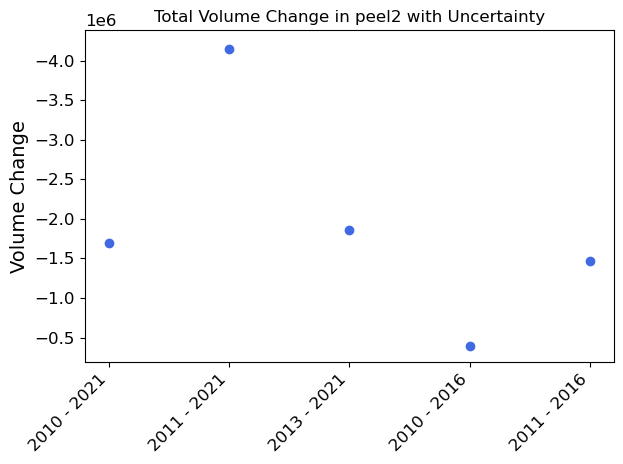

In [110]:
# plot with total volume change per region for different time steps
region = "peel2"
df = tot_vol_change_dict[region]["dem_labels"]
df2 = tot_vol_change_dict[region]["opt_train_labels"]
df3 = tot_vol_change_dict[region]["opt_pred_labels"]

# Create a figure and axis
fig, ax = plt.subplots()

# Iterate over each row in the DataFrame
for i, row in df.iterrows():
    name = f"{int(row['start_year'])} - {int(row['end_year'])}"  # Generate name for the range of years
    
    # Plot the volume change as points with error bars for uncertainty for each range of years
    ax.errorbar(i, row['original'], yerr=[[row['buffered_error']], [row['erased_error']]], fmt='o', color='royalblue', label=name)

# Set custom ticks and labels for the x-axis
ax.set_xticks(np.arange(len(df)))
ax.set_xticklabels([f"{int(row['start_year'])} - {int(row['end_year'])}" for i, row in df.iterrows()], rotation=45, ha="right")

# Set labels and title
ax.set_ylabel('Volume Change')
ax.set_title(f'Total Volume Change in {region} with Uncertainty')

# Invert the y-axis
ax.invert_yaxis()


# Show the plot
plt.tight_layout()
plt.show()



c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\matplotlib\cbook.py:1699: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  return math.isfinite(val)


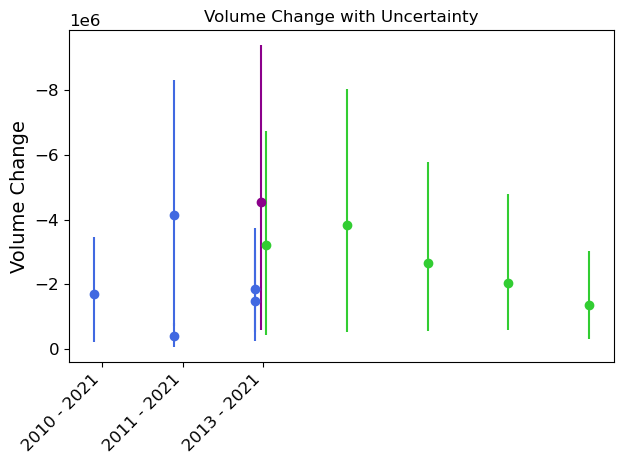

In [111]:
# total Volume changes of different label kinds in one plot [draft]

# Concatenate the three DataFrames
concatenated_df = pd.concat([df, df2, df3], ignore_index=True)

# Sort the concatenated DataFrame by the 'start_year' column
concatenated_df = concatenated_df.sort_values(by='start_year')

# Calculate the width of each group
group_width = 0.2  # Adjust as needed

# Create a figure and axis
fig, ax = plt.subplots()

# Iterate over each unique label
for i, label in enumerate(concatenated_df['start_year'].unique()):
    # Filter the concatenated DataFrame for the current label
    label_data = concatenated_df[concatenated_df['start_year'] == label]
    
    # Plot the volume change as points with error bars for uncertainty for each label and DataFrame
    for j, (df_label, color) in enumerate(zip([df, df2, df3], ['royalblue', 'darkmagenta', "limegreen"])):
        # Filter the DataFrame for the current label
        df_label_data = df_label[df_label['start_year'] == label]
        
        # Calculate the x position with offset for each DataFrame
        x_pos = i - (group_width / 2) + (j * (group_width / 3))
        
        # Plot the data with a horizontal offset to prevent overlapping
        ax.errorbar(x_pos + np.arange(len(df_label_data)), 
                     df_label_data['original'], 
                     yerr=[df_label_data['buffered'] * -1, df_label_data['erased'] * -1], 
                     fmt='o', label=f"{int(label)} - {int(label_data['end_year'].values[0])}", 
                     color=color)

# Set custom ticks and labels for the x-axis
ax.set_xticks(np.arange(len(concatenated_df['start_year'].unique())))
ax.set_xticklabels([f"{int(label)} - {int(concatenated_df[concatenated_df['start_year'] == label]['end_year'].values[0])}" 
                     for label in concatenated_df['start_year'].unique()], rotation=45, ha="right")

# Set labels and title
ax.set_ylabel('Volume Change')
ax.set_title('Volume Change with Uncertainty')

# Invert the y-axis
ax.invert_yaxis()


# Show the plot
plt.tight_layout()
plt.show()


,start_year,end_year,buffered_per_RTS_sum,buffered,buffered_error,buffered_per_RTS_error,number,erased_per_RTS_sum,erased,erased_error,erased_per_RTS_error,original_per_RTS_sum,original,original_error,original_per_RTS_error,len_timestep,-,+,original_per_RTS,buffered_per_RTS,erased_per_RTS,+_per_RTS,-_per_RTS,vol_change_rate,vol_change_rate_buf,vol_change_rate_er,vol_change_rate_per_RTS,vol_change_rate_buf_per_RTS,vol_change_rate_er_per_RTS,label_groupe
2010_2021,2010,2021,-13893.928795,-138939.294434,5490.564346,1671.116667,10,-8909.549313,-89095.489502,2749.74823,816.044602,-13298.531494,-132985.302734,3924.485397,1186.360312,11,-43889.813232,-5953.991699,-13298.530273,-13893.929443,-8909.54895,-595.39917,-4388.981323,-12089.572976,-12630.844949,-8099.589955,-1208.957298,-1263.084495,-809.958995,dem_labels


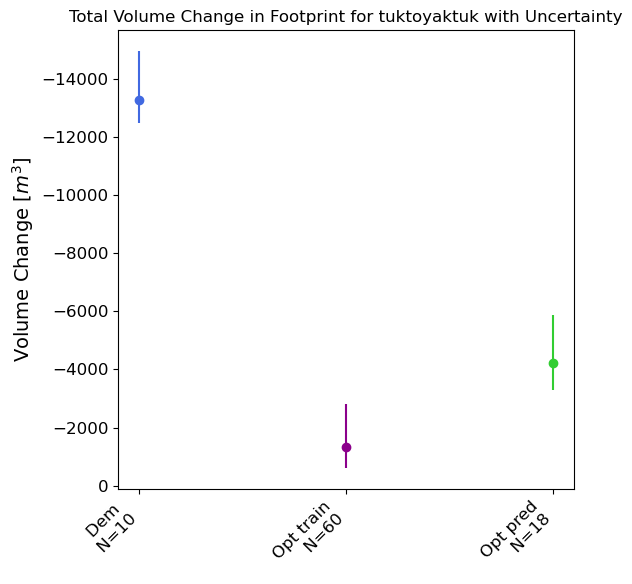

In [112]:
# plot of total volume change with volume change error in tuk. Comparison of different label kinds.

# Filter DataFrames according to the entry (year)
region = "tuktoyaktuk"
start_year = 2010
end_year = 2021
df1 = tot_vol_change_dict[region]["dem_labels"][(tot_vol_change_dict[region]["dem_labels"]["start_year"] == start_year) & (tot_vol_change_dict[region]["dem_labels"]["end_year"] == end_year)]
df2 = tot_vol_change_dict[region]["opt_train_labels"][(tot_vol_change_dict[region]["opt_train_labels"]["start_year"] == start_year) & (tot_vol_change_dict[region]["opt_train_labels"]["end_year"] == end_year)]
df3 = tot_vol_change_dict[region]["opt_pred_labels"][(tot_vol_change_dict[region]["opt_pred_labels"]["start_year"] == start_year) & (tot_vol_change_dict[region]["opt_pred_labels"]["end_year"] == end_year)]
display(df1)
# Extracting values from the DataFrame
original_values_df1 = df1['original_per_RTS_sum'].iloc[0]
buffered_err_df1 = df1['buffered_per_RTS_error'].iloc[0] 
erased_err_df1 = df1['erased_per_RTS_error'].iloc[0] 

original_values_df2 = df2['original_per_RTS_sum'].iloc[0]
buffered_err_df2 = df2['buffered_per_RTS_error'].iloc[0] 
erased_err_df2 = df2['erased_per_RTS_error'].iloc[0] 

original_values_df3 = df3['original_per_RTS_sum'].iloc[0]
buffered_err_df3 = df3['buffered_per_RTS_error'].iloc[0]
erased_err_df3 = df3['erased_per_RTS_error'].iloc[0] 

num1 = df1["number"].iloc[0]
num2 = df2["number"].iloc[0]
num3 = df3["number"].iloc[0]

# Set the width of the plot
fig, ax = plt.subplots(figsize=(6, 6), sharey=True)

# Plot data for each DataFrame
ax.errorbar(0, original_values_df1, yerr=[[buffered_err_df1], [erased_err_df1]], fmt='o', color = 'royalblue', label="Dem-Labels")
ax.errorbar(1, original_values_df2, yerr=[[buffered_err_df2], [erased_err_df2]], fmt='o', color = "darkmagenta", label="Optical Training Labels")
ax.errorbar(2, original_values_df3, yerr=[[buffered_err_df3], [erased_err_df3]], fmt='o', color = "limegreen", label="Optical Prediction Labels")

# Set custom ticks and labels for the x-axis
ax.set_xticks(np.arange(3))
ax.set_xticklabels([f"Dem \n N={num1}", f"Opt train\n N={num2}", f"Opt pred\n N={num3}"], rotation=45, ha="right")

# Set labels and title
ax.set_ylabel('Volume Change [$m^3$]')
ax.set_title(f'Total Volume Change in Footprint for {region} with Uncertainty')

# Invert the y-axis
ax.invert_yaxis()

# Show legend
#ax.legend()

# Show the plot
plt.tight_layout()
plt.show()


Total Volume change + buffer error and - erosion error
Why such a big difference between label kinds? -> Maybe wrong calculation?

For the optical we have probably a much smaller range, because big parts ot the buffered or erased area lay in the tongue of debris area where we have only little volume change. Dem reach probably closer to the headwall where we have a lot of volume change and with that we also get a big difference for the buffer

### Volume change rate

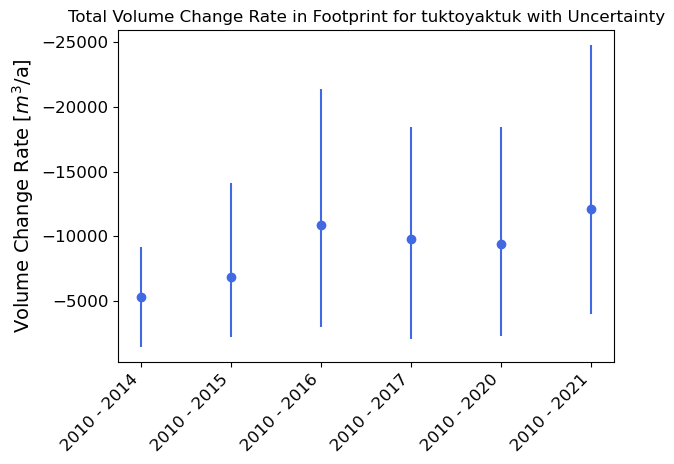

In [113]:
# plot of volume change rate over the years in tuk

region = "tuktoyaktuk"
df = tot_vol_change_dict[region]["dem_labels"]
df = df[df["start_year"] == 2010]
#df = df[df["end_year"] != 2016]
#df = df[df["end_year"] != 2021]
df = df.sort_values(by=["start_year", "end_year"], ascending=True)
#df = df[df["end_year"] == 2021]
#df = df.sort_values(by="start_year", ascending=True)

#df = tot_vol_change_dict[region]["opt_pred_labels"]
#df = df.sort_index(ascending=True)

import matplotlib.pyplot as plt
import numpy as np

# Create a figure and axis
fig, ax = plt.subplots()

# Iterate over each row in the DataFrame
for i, row in df.iterrows():
    name = f"{int(row['start_year'])} - {int(row['end_year'])}"  # Generate name for the range of years
    
    # Plot the volume change as points with error bars for uncertainty for each range of years
    ax.errorbar(i, row['vol_change_rate'], yerr=[[row['vol_change_rate_buf']*-1], [row['vol_change_rate_er']*-1]], fmt='o', color='royalblue', label=name)

# Set custom ticks and labels for the x-axis
ax.set_xticks(np.arange(len(df)))
ax.set_xticklabels([f"{int(row['start_year'])} - {int(row['end_year'])}" for i, row in df.iterrows()], rotation=45, ha="right")

# Set labels and title
ax.set_ylabel('Volume Change Rate [$m^3$/a]')
ax.set_title(f'Total Volume Change Rate in Footprint for {region} with Uncertainty')

# Invert the y-axis
ax.invert_yaxis()


# Show the plot
plt.tight_layout()
plt.show()



## Sentinel Data

c:\Users\kimbu\anaconda3\envs\test\Lib\site-packages\osgeo\gdal.py:312: FutureWarning: Neither gdal.UseExceptions() nor gdal.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(


,Area_sentinel,Area_train,Volume Change_sentinel,Volume Change_train,Circularity_sentinel,Circularity_train,Solidity_sentinel,Solidity_train
0,16758.693402,15270.342776,-69980.340576,-63638.250732,0.288711,0.256597,0.711678,0.727747
1,5528.961742,4512.328881,-26263.574219,-24846.325684,0.534016,0.370224,0.818342,0.835023
2,38239.634532,33602.447891,-323410.888672,-301878.417969,0.463260,0.342091,0.818809,0.815621
3,6010.116470,5130.346402,-30742.089844,-24225.286865,0.237722,0.312099,0.675282,0.836039
4,36136.110575,38561.371156,-176455.590820,-177453.967285,0.162141,0.114429,0.590844,0.581842
5,2649.722536,2639.791102,-6786.798096,-6503.747559,0.306609,0.393441,0.647431,0.801815
6,92314.019128,101578.152664,-981240.429688,-939121.875000,0.174222,0.248561,0.725373,0.850991
7,5308.876367,4950.774464,-17667.639160,-15491.790771,0.409494,0.406184,0.815877,0.871930


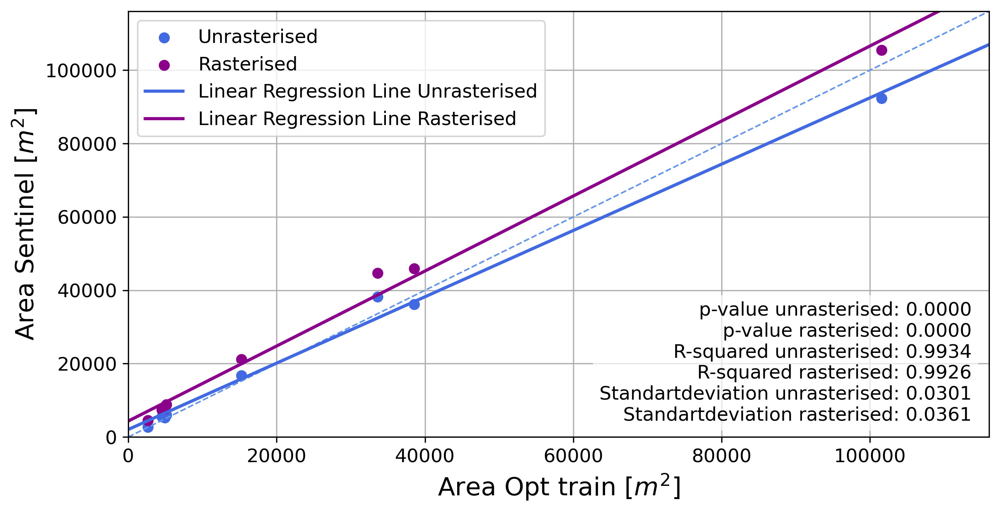

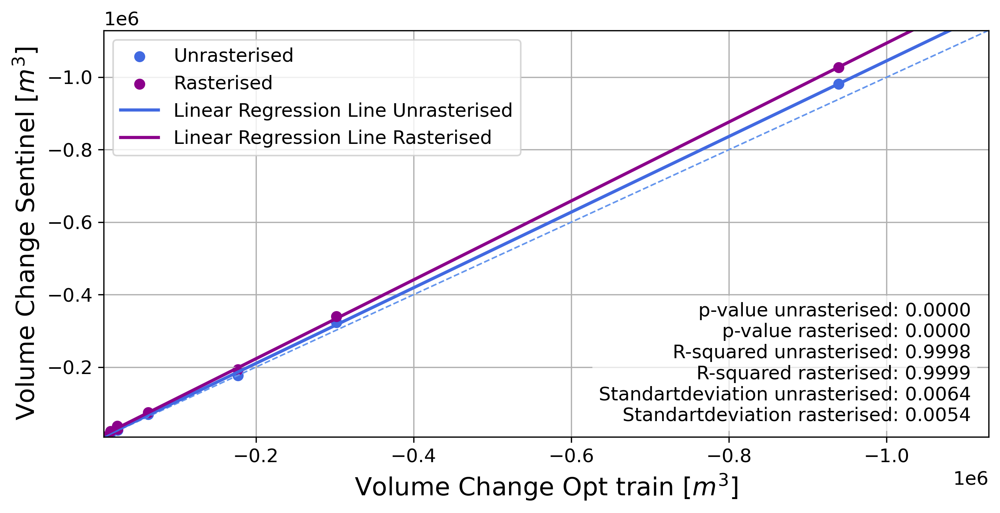

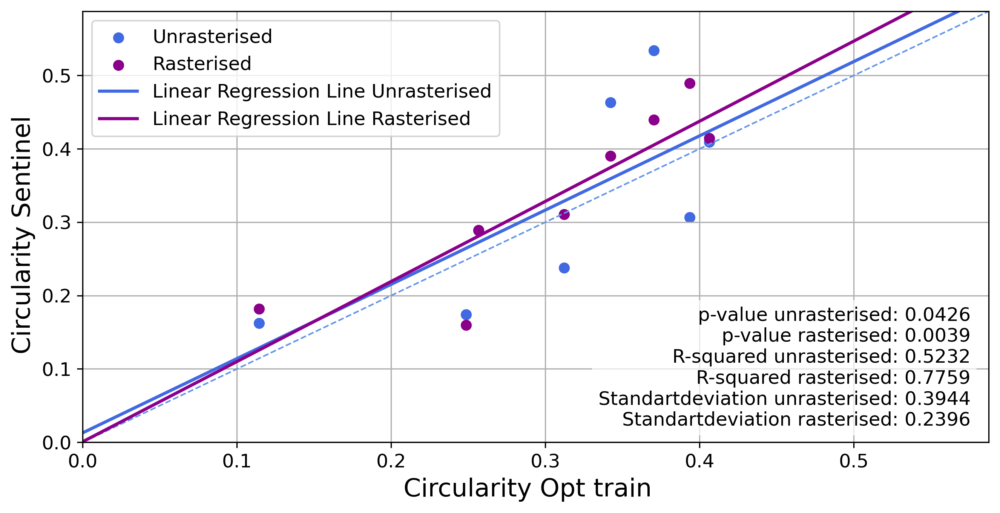

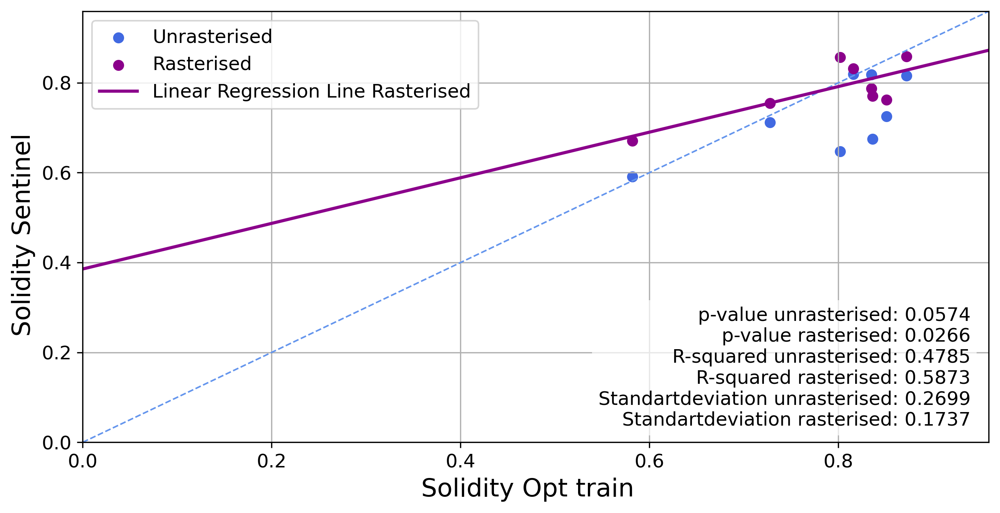

In [114]:
# rasterises Sentinel labels, calculates the standard metrics and plots comparison of Sentinel and opt train labels
sentinel = {}
sentinel["unrasterised"] = peel_sentinel_2022
sentinel["rasterised"] = rasterise_labels(peel_sentinel_2022, "peel2", data["peel2"]["tiles"].total_bounds, "optical_sentinel", 2022, "original_sentinel")
rasterised_dict[start_end_years] = rasterised_dict[start_end_years].dissolve(by="identifier", aggfunc="sum")

for kind in sentinel:
    sentinel[kind] = sentinel[kind].dissolve(by="identifier", aggfunc="sum")
    sentinel[kind].reset_index(inplace=True)
    sentinel[kind]["year"] = 2022
    sentinel[kind]["area"] = sentinel[kind]["geometry"].area
    sentinel[kind]["circularity"] = sentinel[kind]["geometry"].apply(calculate_circularity)
    sentinel[kind]["solidity"] = sentinel[kind]["geometry"].apply(calculate_solidity)
    dem_file1 = merged_diff_dems["peel2"]["2013_2021"]
    sentinel[kind]["avg_volume_change"], sentinel[kind]["sum_volume_change"] = zip(*sentinel[kind].apply(lambda row: volume_change_per_polygon(row, dem_file1, opt=True), axis=1))

merged_sentinel_opt_train_unraster = pd.merge(sentinel["unrasterised"], labels_of_year_data["peel2"]["opt_train_labels"]["unrasterised"]["2022"], on='identifier', how='inner', suffixes=("_sentinel", "_train"))
merged_sentinel_opt_train_raster = pd.merge(sentinel["rasterised"], labels_of_year_data["peel2"]["opt_train_labels"]["unrasterised"]["2022"], on='identifier', how='inner', suffixes=("_sentinel", "_train"))

new_columns = ["Area_sentinel", "Area_train", "Volume Change_sentinel", "Volume Change_train", "Circularity_sentinel", "Circularity_train", "Solidity_sentinel", "Solidity_train"]
columns = ["area_sentinel", "area_train",  "sum_volume_change_sentinel", "sum_volume_change_train", "circularity_sentinel", "circularity_train", "solidity_sentinel", "solidity_train"]
merged_sentinel_opt_train_unraster = merged_sentinel_opt_train_unraster[columns].copy().rename(columns=dict(zip(columns, new_columns)))
merged_sentinel_opt_train_raster = merged_sentinel_opt_train_raster[columns].copy().rename(columns=dict(zip(columns, new_columns)))

# Sentinel vs. opt_train
display(merged_sentinel_opt_train_unraster)
attributes = [("Area", "[$m^2$]"), ("Volume Change", "[$m^3$]"), ("Circularity", " "), ("Solidity", " ")]
for attribute, unit in attributes:
    fig_sentinel_vs_opt_with_linregress(merged_sentinel_opt_train_unraster[f"{attribute}_sentinel"], merged_sentinel_opt_train_raster[f"{attribute}_sentinel"], merged_sentinel_opt_train_unraster[f"{attribute}_train"], merged_sentinel_opt_train_raster[f"{attribute}_train"], attribute, attribute, unit )
    

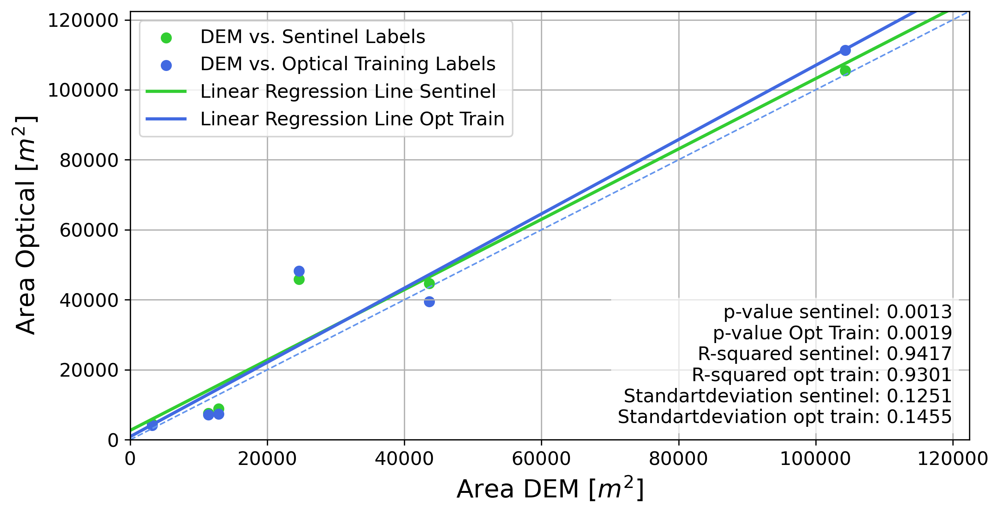

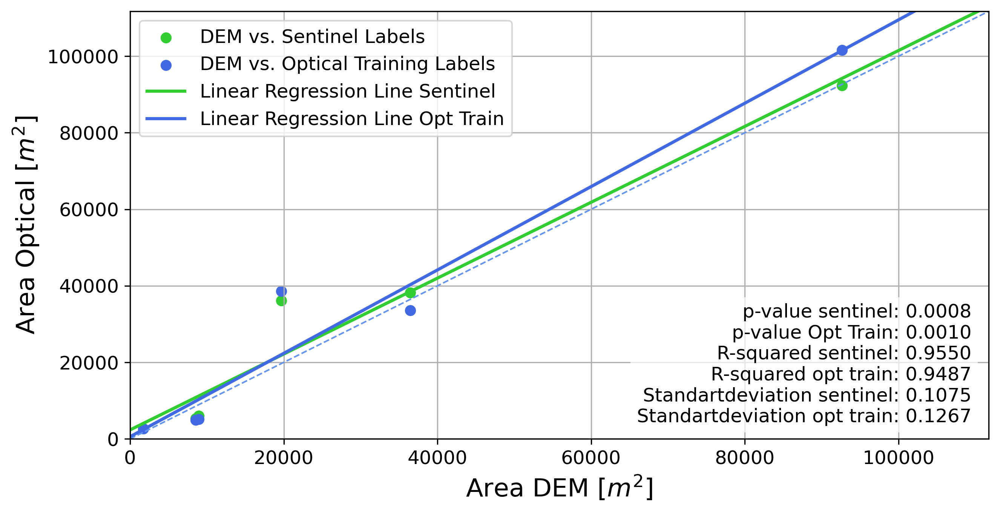

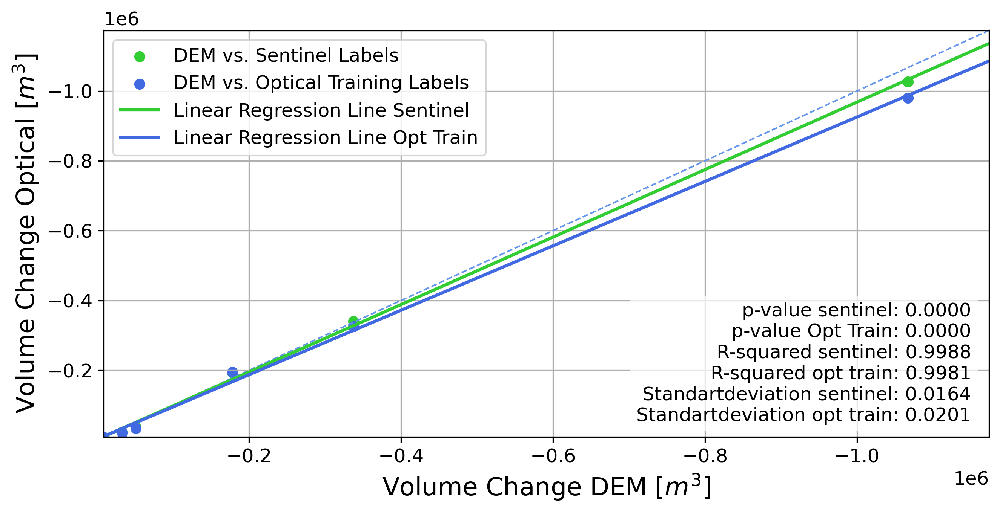

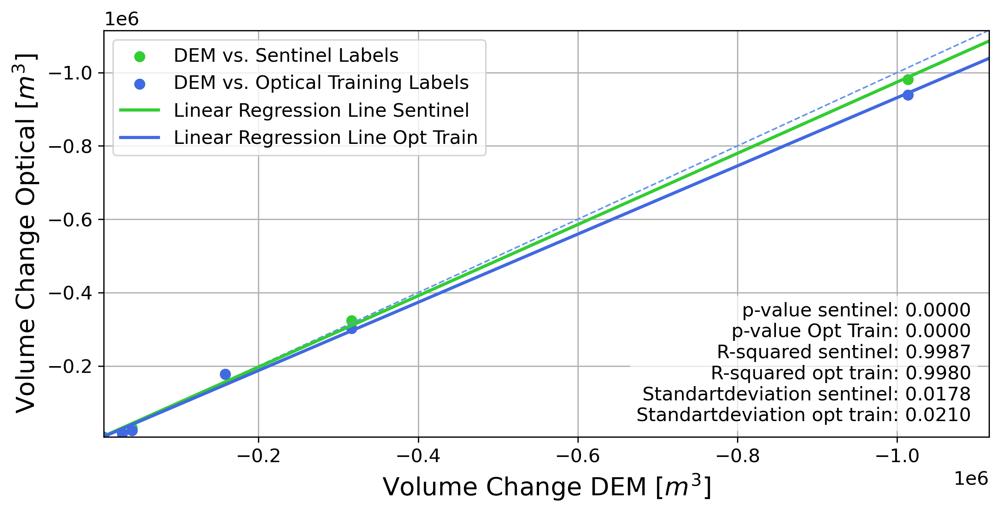

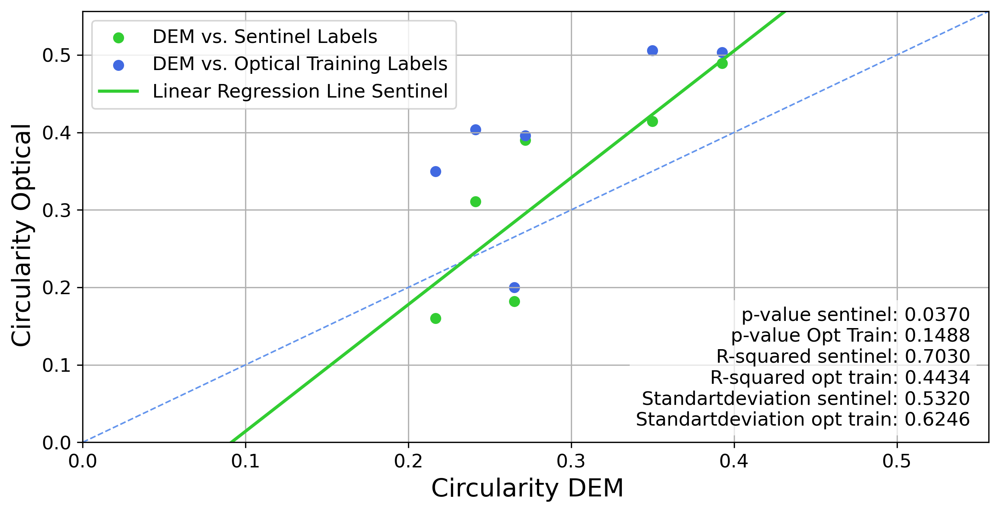

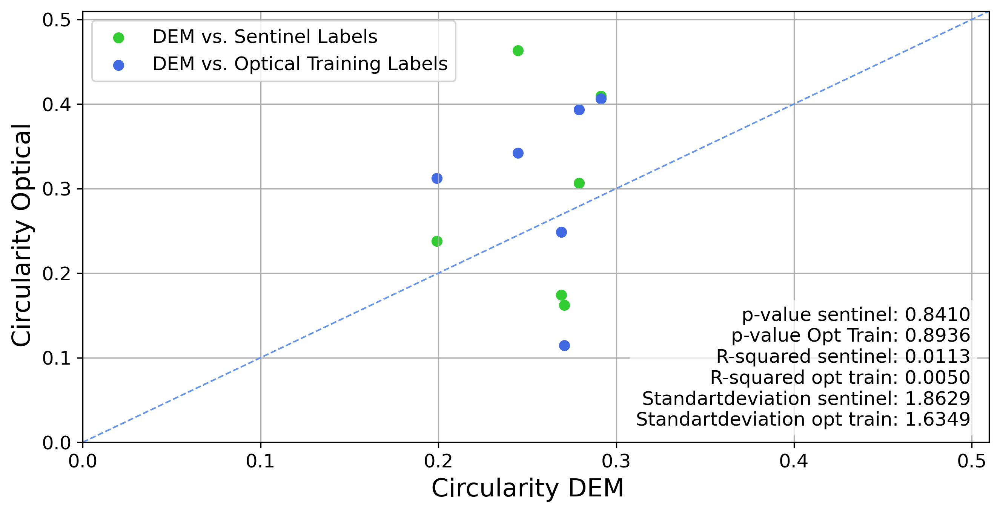

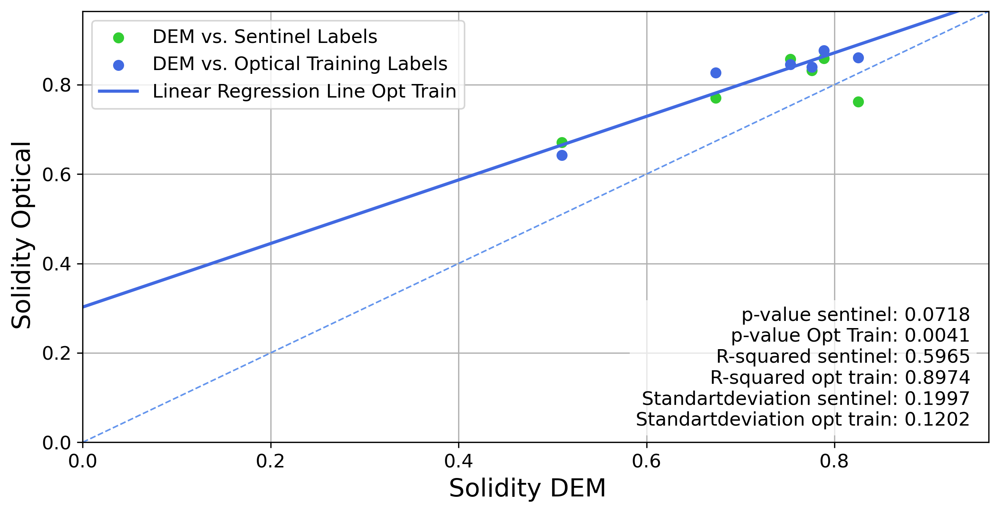

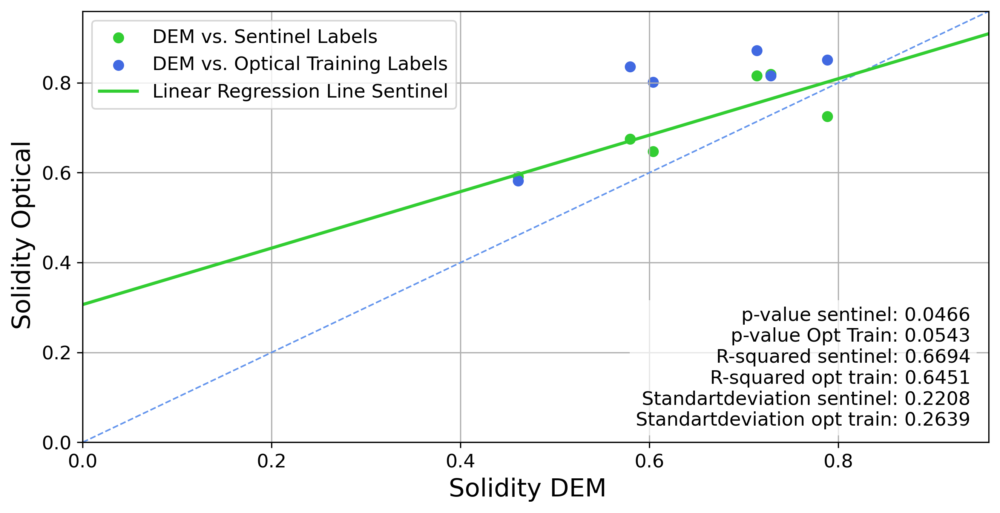

In [115]:
# plots standard metrics of DEM labels against Sentinel and optical training labels

# DEM vs. Opt Train and sentinel
merged_sentinel_dem_opt_train_raster = pd.merge(pd.merge(sentinel["rasterised"], labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2013_2021"], on='identifier', how='inner', suffixes=("_sentinel", "_dem")),  labels_of_year_data["peel2"]["opt_train_labels"]["rasterised"]["2022"], on='identifier', how='inner', suffixes=(None, "_opt_train"))
merged_sentinel_dem_opt_train_unraster = pd.merge(pd.merge(sentinel["unrasterised"], labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2013_2021"], on='identifier', how='inner', suffixes=("_sentinel", "_dem")),  labels_of_year_data["peel2"]["opt_train_labels"]["unrasterised"]["2022"], on='identifier', how='inner', suffixes=(None, "_opt_train"))


new_columns = ["Area_sentinel", "Area_dem", "Area_opt_train", "Volume Change_sentinel", "Volume Change_dem", "Volume Change_opt_train", "Circularity_sentinel", "Circularity_dem", "Circularity_opt_train", "Solidity_sentinel", "Solidity_dem", "Solidity_opt_train"]
columns = ["area_sentinel", "area_dem",  "area", "sum_volume_change_sentinel", "sum_volume_change_dem", "sum_volume_change", "circularity_sentinel", "circularity_dem", "circularity", "solidity_sentinel", "solidity_dem", "solidity"]
merged_sentinel_dem_opt_train_raster = merged_sentinel_dem_opt_train_raster[columns].copy().rename(columns=dict(zip(columns, new_columns)))
merged_sentinel_dem_opt_train_unraster = merged_sentinel_dem_opt_train_unraster[columns].copy().rename(columns=dict(zip(columns, new_columns)))

attributes = [("Area", "[$m^2$]"), ("Volume Change", "[$m^3$]"), ("Circularity", " "), ("Solidity", " ")]
for attribute, unit in attributes:
    fig_dem_vs_opt_sentinel_with_linregress(merged_sentinel_dem_opt_train_raster[f"{attribute}_sentinel"], merged_sentinel_dem_opt_train_raster[f"{attribute}_opt_train"], merged_sentinel_dem_opt_train_raster[f"{attribute}_dem"], f"{attribute} of Rasterised Labels", attribute, unit )
    fig_dem_vs_opt_sentinel_with_linregress(merged_sentinel_dem_opt_train_unraster[f"{attribute}_sentinel"], merged_sentinel_dem_opt_train_unraster[f"{attribute}_opt_train"], merged_sentinel_dem_opt_train_unraster[f"{attribute}_dem"], f"{attribute} of Unrasterised Labels", attribute, unit )


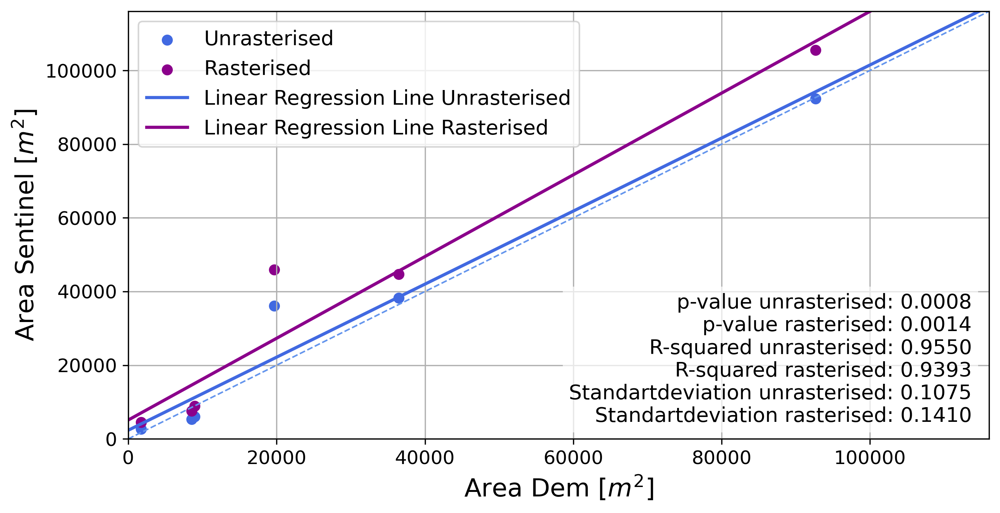

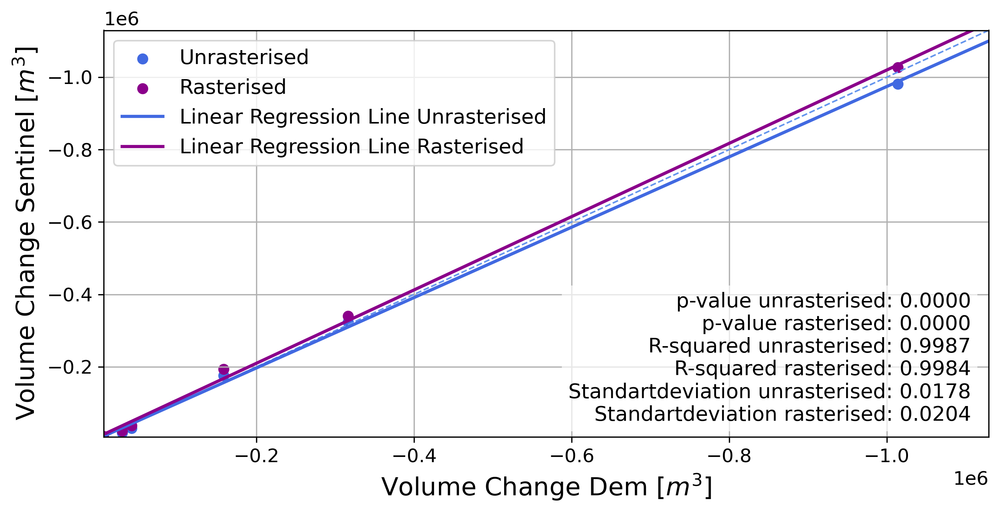

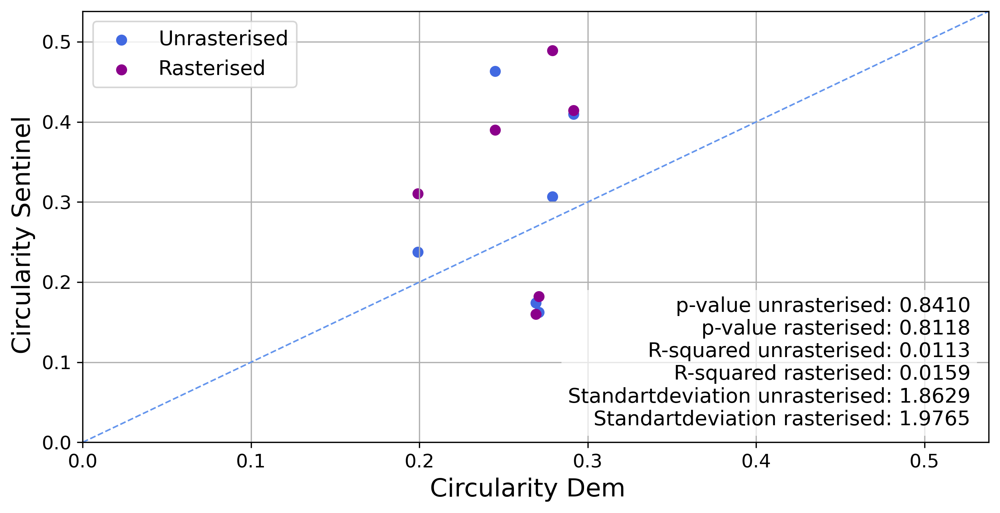

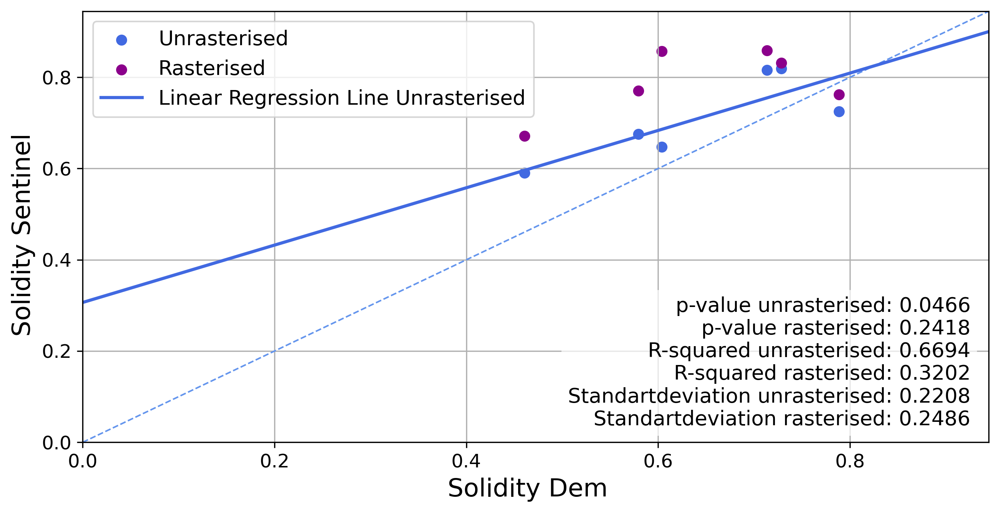

In [116]:
# plots standard metrics of DEM labels against Sentinel labels

# Sentinel vs. dem
merged_sentinel_dem_unraster = pd.merge(sentinel["unrasterised"], labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2013_2021"], on='identifier', how='inner', suffixes=("_sentinel", "_dem"))
merged_sentinel_dem_raster = pd.merge(sentinel["rasterised"], labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2013_2021"], on='identifier', how='inner', suffixes=("_sentinel", "_dem"))

new_columns = ["Area_sentinel", "Area_dem", "Volume Change_sentinel", "Volume Change_dem", "Circularity_sentinel", "Circularity_dem", "Solidity_sentinel", "Solidity_dem"]
columns = ["area_sentinel", "area_dem",  "sum_volume_change_sentinel", "sum_volume_change_dem", "circularity_sentinel", "circularity_dem", "solidity_sentinel", "solidity_dem"]
merged_sentinel_dem_unraster = merged_sentinel_dem_unraster[columns].copy().rename(columns=dict(zip(columns, new_columns)))
merged_sentinel_dem_raster = merged_sentinel_dem_raster[columns].copy().rename(columns=dict(zip(columns, new_columns)))

attributes = [("Area", "[$m^2$]"), ("Volume Change", "[$m^3$]"), ("Circularity", " "), ("Solidity", " ")]
for attribute, unit in attributes:
    fig_sentinel_vs_dem_with_linregress(merged_sentinel_dem_unraster[f"{attribute}_dem"], merged_sentinel_dem_raster[f"{attribute}_dem"], merged_sentinel_dem_unraster[f"{attribute}_sentinel"], merged_sentinel_dem_raster[f"{attribute}_sentinel"], attribute, attribute, unit )
  

### IoU DEM vs. Sentinel

In [117]:
# calculates IoU of same labels for Sentinel, DEM and Opt train labels at pixel level
IoU_sentinel_raster = confusion_matrix_pixel_same_labels(sentinel["rasterised"], labels_of_year_data["peel2"]["dem_labels"]["rasterised"]["2013_2021"])
IoU_sentinel_unraster = confusion_matrix_pixel_same_labels(sentinel["unrasterised"], labels_of_year_data["peel2"]["dem_labels"]["unrasterised"]["2013_2021"])
IoU_sent_train_raster = confusion_matrix_pixel_same_labels(sentinel["rasterised"], labels_of_year_data["peel2"]["opt_train_labels"]["rasterised"]["2022"])
IoU_sent_train_unraster = confusion_matrix_pixel_same_labels(sentinel["unrasterised"], labels_of_year_data["peel2"]["opt_train_labels"]["unrasterised"]["2022"])
IoU_sent = {}
raster = {}
unraster = {}
raster["Optical Training Labels"] = IoU_sent_train_raster
raster["DEM Labels"] = IoU_sentinel_raster
unraster["Optical Training Labels"] = IoU_sent_train_unraster
unraster["DEM Labels"] = IoU_sentinel_unraster
IoU_sent["rasterised"] = raster
IoU_sent["unrasterised"] = unraster
IoU_sent_df = pd.DataFrame(IoU_sent)
display(IoU_sent_df)

caption = "IoU calculated with sentinel 2 labels from 2022 and optical training labels from 2022 or DEM labels from 2013 - 2021. For the calculation only pixels belonging to RTSs which were found by both types of labels were considered. All RTSs lie in Peel." 
latex_table = IoU_sent_df.to_latex(index=True, caption=caption, label=f'tab:IoU_same_labels_sentinel', column_format="l r r", float_format="{:.3f}".format, bold_rows=False)
latex_table = latex_table.replace("\\begin{table}", "\\begin{table}[h]\\centering")
with open(f'Kim\\Auswertungsdaten\\Tabels\\IoU_same_labels_sentinel.tex', 'w') as f:
    f.write(latex_table)

,rasterised,unrasterised
Optical Training Labels,0.774112,0.725956
DEM Labels,0.722842,0.704837


## Number of labels per geodataframe

In [119]:
# Comparison of number of labels before and after rasterisation
number_labels_unrasterised = {}
number_labels_rasterised = {}
for region in labels_of_year_data:
    for label_groupe in labels_of_year_data[region]:
        for year in labels_of_year_data[region][label_groupe]["unrasterised"]:
            label_groupe_df = labels_of_year_data[region][label_groupe]["unrasterised"][year]
            label_groupe_df = label_groupe_df.drop_duplicates(subset='geometry')
            number_labels_unrasterised[region+"_"+label_groupe+"_"+str(year)] = len(label_groupe_df)
        for year in labels_of_year_data[region][label_groupe]["rasterised"]:
            label_groupe_df = labels_of_year_data[region][label_groupe]["rasterised"][year]
            label_groupe_df = label_groupe_df.drop_duplicates(subset='geometry')
            number_labels_rasterised[region+"_"+label_groupe+"_"+str(year)] = len(label_groupe_df)
number_labels_per_geodataframe_dict = {"unrasterised": number_labels_unrasterised,
                                       "rasterised": number_labels_rasterised}



# Create a new dataframe
number_of_labels_rasterised_vs_unrasterised = pd.DataFrame(columns=["name","unrasterised", "rasterised"])

# Add data to the dataframe
counter = 1
for kind in number_labels_per_geodataframe_dict["unrasterised"]:
    number_of_labels_rasterised_vs_unrasterised.loc[counter] = [kind, number_labels_per_geodataframe_dict['unrasterised'][kind],number_labels_per_geodataframe_dict["rasterised"][kind]]
    counter = counter + 1



In [120]:
# less rasterised than unrasterised because of duplicates. unrasterised not yet duplicate, but after rasterised in same pixels -> count as duplicates
number_of_labels_rasterised_vs_unrasterised

,name,unrasterised,rasterised
1,peel2_opt_train_labels_2022,78,76
2,peel2_opt_pred_labels_2022,78,78
3,peel2_opt_pred_labels_2021,162,160
4,peel2_opt_pred_labels_2020,83,83
5,peel2_opt_pred_labels_2018,84,84
6,peel2_opt_pred_labels_2019,70,69
7,peel2_dem_labels_2013_2021,32,32
8,peel2_dem_labels_2011_2021,62,62
9,peel2_dem_labels_2010_2016,14,14
10,peel2_dem_labels_2011_2016,49,49
